# **Assignment 3 - Object Detection and Semantic Segmantation ; Faster R-CNN and U-Net**

안녕하세요 AIKU 학회원 여러분, 이번 D2D의 세 번째 과제는 object detection과 semantic segmentation입니다.

여러분은 object detection을 위한 Faster R-CNN 모델과 semantic Segmantation을 위한 U-Net 모델을 각각 만들 것입니다.

강의에서 배웠던 two-stage detector 모델 중 하나인 [**Faster R-CNN**](https://arxiv.org/pdf/1506.01497.pdf)과 유사한 two-stage detector를 구현하고, Semantic Segmentation 모델 중 하나인 [**U-Net**](https://arxiv.org/pdf/1505.04597.pdf)을 구현할 것입니다.



# 1. Two-stage Object Detector; Faster R-CNN




Faster R-CNN은 기존 Fast R-CNN 모델에 Region Proposal Network(RPN)을 추가한 형태입니다.

이를 구현하여 가장 대표적인 Object Detection 데이터셋 중 하나인 PASCAL Visual Object Classes Challenge 2007 (PASCAL VOC 2007) 이미지들을 활용해 직접 object detection을 수행하고 mAP를 통해 성능 평가를 해보는 것이 목표입니다.

먼저, 여러분이 앞으로 detector를 구현하기 위해 필요한 여러 가지 기본적인 함수들을 정의해봅시다.

## Install starter code

과제 코드를 위한 유용한 함수를 import할 수 있는 라이브러리를 설치합니다.


In [ ]:
!pip install git+https://github.com/deepvision-class/starter-code

  Cloning https://github.com/deepvision-class/starter-code to /tmp/pip-req-build-inlff947
  Running command git clone --filter=blob:none --quiet https://github.com/deepvision-class/starter-code /tmp/pip-req-build-inlff947
  Resolved https://github.com/deepvision-class/starter-code to commit e8d9fe711870a39796a2f8ad95538e57942d756f
  Preparing metadata (setup.py) ... done
  Created wheel for Colab-Utils: filename=Colab_Utils-0.1.dev0-py3-none-any.whl size=10264 sha256=7bc7372ecaef47de7b7e2deeba8225ecbe280daf8f7dff07f3fb4b9231111905
  Stored in directory: /tmp/pip-ephem-wheel-cache-0m05vbf8/wheels/c9/fa/82/64b6c443adccf6982835123e4300fc4420373c553439ff0ad5
Successfully built Colab-Utils


## Setup code
기본적인 과제를 위한 setup을 진행합니다.

In [ ]:
import math
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision
import coutils
from coutils import extract_drive_file_id, register_colab_notebooks, \
                    fix_random_seed, rel_error
import matplotlib.pyplot as plt
import numpy as np
import cv2
import copy
import time
import shutil
import os

# for plotting
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

# data type and device for torch.tensor
to_float = {'dtype': torch.float, 'device': 'cpu'}
to_float_cuda = {'dtype': torch.float, 'device': 'cuda'}
to_double = {'dtype': torch.double, 'device': 'cpu'}
to_double_cuda = {'dtype': torch.double, 'device': 'cuda'}
to_long = {'dtype': torch.long, 'device': 'cpu'}
to_long_cuda = {'dtype': torch.long, 'device': 'cuda'}

# for mAP evaluation
!rm -rf mAP
!git clone https://github.com/Cartucho/mAP.git
!rm -rf mAP/input/*

Cloning into 'mAP'...
remote: Enumerating objects: 908, done.
remote: Counting objects: 100% (150/150), done.
remote: Compressing objects: 100% (25/25), done.
remote: Total 908 (delta 135), reused 125 (delta 125), pack-reused 758
Receiving objects: 100% (908/908), 14.70 MiB | 13.42 MiB/s, done.
Resolving deltas: 100% (329/329), done.


GPU 사용이 가능한지 확인합니다.

In [ ]:
if torch.cuda.is_available:
  print('Good to go!')
else:
  print('Please set GPU via Edit -> Notebook Settings.')

Good to go!


## Load PASCAL VOC 2007 data

아래 함수는 PASCAL VOC 2007 데이터셋을 다운로드 하여 PyTorch Dataset object를 반환합니다.

In [ ]:
def get_pascal_voc2007_data(image_root, split='train'):
  """
  Use torchvision.datasets
  https://pytorch.org/docs/stable/torchvision/datasets.html#torchvision.datasets.VOCDetection
  """
  from torchvision import datasets

  train_dataset = datasets.VOCDetection(image_root, year='2007', image_set=split,
                                    download=True)

  return train_dataset

아래 코드를 실행하면 PASCAL VOC 2007 training and validation datasets을 다운로드할 수 있습니다.

In [ ]:
# uncomment below to use the mirror link if the original link is broken
# !wget http://pjreddie.com/media/files/VOCtrainval_06-Nov-2007.tar
train_dataset = get_pascal_voc2007_data('/content', 'train')
val_dataset = get_pascal_voc2007_data('/content', 'val')

# an example on the raw annotation
import json
#print(json.dumps(train_dataset[1][1]['annotation'], indent=2))
print(train_dataset[5][1]['annotation']['object'])

100%|██████████| 460032000/460032000 [00:21<00:00, 20993933.34it/s]


Extracting /content/VOCtrainval_06-Nov-2007.tar to /content
Using downloaded and verified file: /content/VOCtrainval_06-Nov-2007.tar
Extracting /content/VOCtrainval_06-Nov-2007.tar to /content
[{'name': 'aeroplane', 'pose': 'Unspecified', 'truncated': '0', 'difficult': '0', 'bndbox': {'xmin': '9', 'ymin': '107', 'xmax': '499', 'ymax': '263'}}, {'name': 'aeroplane', 'pose': 'Left', 'truncated': '0', 'difficult': '0', 'bndbox': {'xmin': '421', 'ymin': '200', 'xmax': '482', 'ymax': '226'}}, {'name': 'aeroplane', 'pose': 'Left', 'truncated': '1', 'difficult': '0', 'bndbox': {'xmin': '325', 'ymin': '188', 'xmax': '411', 'ymax': '223'}}]


In [ ]:
print(train_dataset[0][1]['annotation'])

{'folder': 'VOC2007', 'filename': '000012.jpg', 'source': {'database': 'The VOC2007 Database', 'annotation': 'PASCAL VOC2007', 'image': 'flickr', 'flickrid': '207539885'}, 'owner': {'flickrid': 'KevBow', 'name': '?'}, 'size': {'width': '500', 'height': '333', 'depth': '3'}, 'segmented': '0', 'object': [{'name': 'car', 'pose': 'Rear', 'truncated': '0', 'difficult': '0', 'bndbox': {'xmin': '156', 'ymin': '97', 'xmax': '351', 'ymax': '270'}}]}


이러한 annotation을 사용하여 모델을 훈련하려면 이 dictionary data를 PyTorch 텐서로 변환해야 합니다.

또한, 이미지를 Pytorch 텐서로 변환하고 224x224로 크기를 조정하는 전처리를 해야 합니다. 이 과제에서는 계산 효율성을 위해 낮은 해상도를 사용합니다.

또한, 미니배치를 사용하여 모델을 학습시키고자 하므로 여러 이미지를 미니배치로 그룹화해야 합니다.

이 두 가지 기능은 다음과 같은 함수를 통해 수행합니다.

In [ ]:
def pascal_voc2007_loader(dataset, batch_size, num_workers=0):
  """
  Data loader for Pascal VOC 2007.
  https://pytorch.org/docs/stable/data.html#torch.utils.data.DataLoader
  """
  from torch.utils.data import DataLoader
  # turn off shuffle so we can index the original image
  train_loader = DataLoader(dataset,
                            batch_size=batch_size,
                            shuffle=False, pin_memory=True,
                            num_workers=num_workers,
                            collate_fn=voc_collate_fn)
  return train_loader


class_to_idx = {'aeroplane':0, 'bicycle':1, 'bird':2, 'boat':3, 'bottle':4,
                'bus':5, 'car':6, 'cat':7, 'chair':8, 'cow':9, 'diningtable':10,
                'dog':11, 'horse':12, 'motorbike':13, 'person':14, 'pottedplant':15,
                'sheep':16, 'sofa':17, 'train':18, 'tvmonitor':19
}
idx_to_class = {i:c for c, i in class_to_idx.items()}


from torchvision import transforms

def voc_collate_fn(batch_lst, reshape_size=224):
    preprocess = transforms.Compose([
      transforms.Resize((reshape_size, reshape_size)),
      transforms.ToTensor(),
      transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
      ])

    batch_size = len(batch_lst)

    img_batch = torch.zeros(batch_size, 3, reshape_size, reshape_size)

    max_num_box = max(len(batch_lst[i][1]['annotation']['object']) \
                      for i in range(batch_size))

    box_batch = torch.Tensor(batch_size, max_num_box, 5).fill_(-1.)
    w_list = []
    h_list = []
    img_id_list = []

    for i in range(batch_size):
      img, ann = batch_lst[i]
      w_list.append(img.size[0]) # image width
      h_list.append(img.size[1]) # image height
      img_id_list.append(ann['annotation']['filename'])
      img_batch[i] = preprocess(img)
      all_bbox = ann['annotation']['object']
      if type(all_bbox) == dict: # inconsistency in the annotation file
        all_bbox = [all_bbox]
      for bbox_idx, one_bbox in enumerate(all_bbox):
        bbox = one_bbox['bndbox']
        obj_cls = one_bbox['name']
        box_batch[i][bbox_idx] = torch.Tensor([float(bbox['xmin']), float(bbox['ymin']),
          float(bbox['xmax']), float(bbox['ymax']), class_to_idx[obj_cls]])

    h_batch = torch.tensor(h_list)
    w_batch = torch.tensor(w_list)

    return img_batch, box_batch, w_batch, h_batch, img_id_list

연산량을 위해 전체 데이터셋의 일부만 가져와서 사용합니다.

In [ ]:
train_dataset = torch.utils.data.Subset(train_dataset, torch.arange(0, 2500)) # use 2500 samples for training
train_loader = pascal_voc2007_loader(train_dataset, 10)
val_loader = pascal_voc2007_loader(val_dataset, 10)

`DataLoader` object는 데이터의 배치를 리턴합니다.

`DataLoader`의 first output은 `(B, 3, 224, 224)` size의  Tensor `img`입니다.

`DataLoader`의 second output은 Tensor `ann` (shape `(B, N, 5)`)으로, batch에 있는 모든 이미지들의 모든 object에 대한 정보를 담고 있습니다.

`img[i]`의 `j`th object에 대한 정보는 `ann[i, j] = (x_tl, y_tl, x_br, y_br, class)` 으로 표현되며, box의 top-left corner가 `(x_tl, y_tl)`, bottom-right corner가 `(x_br, y_br)`입니다. 이 좌표는 image가 224x224로 resize되기 전의 좌표입니다.

`class`는 해당 bounding box에 대한 category label을 나타내는 정수입니다.

`img[i]`가 $N_i$개의 object를 가지고 있다면, $N=\max_i N_i$는 batch마다 다를 것입니다. $N$개보다 object 개수가 작은 image의 경우, 첫 $N_i$개의 행만 정보를 담고 있고, 나머지는 -1로 채워져있습니다.

In [ ]:
img, ann, _, _, _ = next(iter(train_loader))

print('img has shape: ', img.shape)
print('ann has shape: ', ann.shape)

print('Image 1 has only two annotated objects, so ann[1] is padded with -1:')
print(ann[1])

print('\nImage 2 has six annotated objects:, so ann[2] is not padded:')
print(ann[2])

print('\nEach row in the annotation tensor indicates (x_tl, y_tl, x_br, y_br, class).')

img has shape:  torch.Size([10, 3, 224, 224])
ann has shape:  torch.Size([10, 6, 5])
Image 1 has only two annotated objects, so ann[1] is padded with -1:
tensor([[185.,  62., 279., 199.,  14.],
        [ 90.,  78., 403., 336.,  12.],
        [ -1.,  -1.,  -1.,  -1.,  -1.],
        [ -1.,  -1.,  -1.,  -1.,  -1.],
        [ -1.,  -1.,  -1.,  -1.,  -1.],
        [ -1.,  -1.,  -1.,  -1.,  -1.]])

Image 2 has six annotated objects:, so ann[2] is not padded:
tensor([[  9., 230., 245., 500.,   1.],
        [230., 220., 334., 500.,   1.],
        [  2., 178.,  90., 500.,   1.],
        [  2.,   1., 117., 369.,  14.],
        [  3.,   2., 243., 462.,  14.],
        [225.,   1., 334., 486.,  14.]])

Each row in the annotation tensor indicates (x_tl, y_tl, x_br, y_br, class).


## Coordinate transformation
**이번 과제에서 우리는 CNN activation map (7x7)로 정의된 좌표 시스템을 사용할 예정입니다. top-left corner가 (0, 0), bottom-right corner가 (7, 7)입니다.**

아래 함수를 통해 원래 이미지의 좌표 시스템에서 위에서 서술한 activation map 좌표 시스템으로 transformation을 진행합니다.

In [ ]:
def coord_trans(bbox, w_pixel, h_pixel, w_amap=7, h_amap=7, mode='a2p'):
  """
  Coordinate transformation function. It converts the box coordinate from
  the image coordinate system to the activation map coordinate system and vice versa.
  In our case, the input image will have a few hundred of pixels in
  width/height while the activation map is of size 7x7.

  Input:
  - bbox: Could be either bbox, anchor, or proposal, of shape Bx*x4
  - w_pixel: Number of pixels in the width side of the original image, of shape B
  - h_pixel: Number of pixels in the height side of the original image, of shape B
  - w_amap: Number of pixels in the width side of the activation map, scalar
  - h_amap: Number of pixels in the height side of the activation map, scalar
  - mode: Whether transfer from the original image to activation map ('p2a') or
          the opposite ('a2p')

  Output:
  - resized_bbox: Resized box coordinates, of the same shape as the input bbox
  """

  assert mode in ('p2a', 'a2p'), 'invalid coordinate transformation mode!'
  assert bbox.shape[-1] >= 4, 'the transformation is applied to the first 4 values of dim -1'

  if bbox.shape[0] == 0: # corner cases
    return bbox

  resized_bbox = bbox.clone()
  # could still work if the first dim of bbox is not batch size
  # in that case, w_pixel and h_pixel will be scalars
  resized_bbox = resized_bbox.view(bbox.shape[0], -1, bbox.shape[-1])
  invalid_bbox_mask = (resized_bbox == -1) # indicating invalid bbox

  if mode == 'p2a':
    # pixel to activation
    width_ratio = w_pixel * 1. / w_amap
    height_ratio = h_pixel * 1. / h_amap
    resized_bbox[:, :, [0, 2]] /= width_ratio.view(-1, 1, 1)
    resized_bbox[:, :, [1, 3]] /= height_ratio.view(-1, 1, 1)
  else:
    # activation to pixel
    width_ratio = w_pixel * 1. / w_amap
    height_ratio = h_pixel * 1. / h_amap
    resized_bbox[:, :, [0, 2]] *= width_ratio.view(-1, 1, 1)
    resized_bbox[:, :, [1, 3]] *= height_ratio.view(-1, 1, 1)

  resized_bbox.masked_fill_(invalid_bbox_mask, -1)
  resized_bbox.resize_as_(bbox)
  return resized_bbox

## Data Visualizer

image에서의 box visualization을 위한 함수입니다.

In [ ]:
def data_visualizer(img, idx_to_class, bbox=None, pred=None):
  """
  Data visualizer on the original image. Support both GT box input and proposal input.

  Input:
  - img: PIL Image input
  - idx_to_class: Mapping from the index (0-19) to the class name
  - bbox: GT bbox (in red, optional), a tensor of shape Nx5, where N is
          the number of GT boxes, 5 indicates (x_tl, y_tl, x_br, y_br, class)
  - pred: Predicted bbox (in green, optional), a tensor of shape N'x6, where
          N' is the number of predicted boxes, 6 indicates
          (x_tl, y_tl, x_br, y_br, class, object confidence score)
  """

  img_copy = np.array(img).astype('uint8')

  if bbox is not None:
    for bbox_idx in range(bbox.shape[0]):
      one_bbox = bbox[bbox_idx][:4]
      cv2.rectangle(img_copy, (int(one_bbox[0]), int(one_bbox[1])), (int(one_bbox[2]),
                  int(one_bbox[3])), (255, 0, 0), 2)
      if bbox.shape[1] > 4: # if class info provided
        obj_cls = idx_to_class[bbox[bbox_idx][4].item()]
        cv2.putText(img_copy, '%s' % (obj_cls),
                  (int(one_bbox[0]), int(one_bbox[1])+15),
                  cv2.FONT_HERSHEY_PLAIN, 1.0, (0, 0, 255), thickness=1)

  if pred is not None:
    for bbox_idx in range(pred.shape[0]):
      one_bbox = pred[bbox_idx][:4]
      cv2.rectangle(img_copy, (int(one_bbox[0]), int(one_bbox[1])), (int(one_bbox[2]),
                  int(one_bbox[3])), (0, 255, 0), 2)

      if pred.shape[1] > 4: # if class and conf score info provided
        obj_cls = idx_to_class[pred[bbox_idx][4].item()]
        conf_score = pred[bbox_idx][5].item()
        cv2.putText(img_copy, '%s, %.2f' % (obj_cls, conf_score),
                    (int(one_bbox[0]), int(one_bbox[1])+15),
                    cv2.FONT_HERSHEY_PLAIN, 1.0, (0, 0, 255), thickness=1)

  plt.imshow(img_copy)
  plt.axis('off')
  plt.show()

### Visualize PASCAL VOC 2007
PASCAL VOC 2007 training set에 있는 이미지를 visualize해보겠습니다.

In [ ]:
# default examples for visualization
fix_random_seed(0)
batch_size = 3
sampled_idx = torch.linspace(0, len(train_dataset)-1, steps=batch_size).long()

# get the size of each image first
h_list = []
w_list = []
img_list = [] # list of images
MAX_NUM_BBOX = 40
box_list = torch.LongTensor(batch_size, MAX_NUM_BBOX, 5).fill_(-1) # PADDED GT boxes

for idx, i in enumerate(sampled_idx):
  # hack to get the original image so we don't have to load from local again...
  img, ann = train_dataset.__getitem__(i)
  img_list.append(img)

  all_bbox = ann['annotation']['object']
  if type(all_bbox) == dict:
    all_bbox = [all_bbox]
  for bbox_idx, one_bbox in enumerate(all_bbox):
    bbox = one_bbox['bndbox']
    obj_cls = one_bbox['name']
    box_list[idx][bbox_idx] = torch.LongTensor([int(bbox['xmin']), int(bbox['ymin']),
      int(bbox['xmax']), int(bbox['ymax']), class_to_idx[obj_cls]])

  # get sizes
  img = np.array(img)
  w_list.append(img.shape[1])
  h_list.append(img.shape[0])

w_list = torch.as_tensor(w_list, **to_float_cuda)
h_list = torch.as_tensor(h_list, **to_float_cuda)
box_list = torch.as_tensor(box_list, **to_float_cuda)
resized_box_list = coord_trans(box_list, w_list, h_list, mode='p2a') # on activation map coordinate system

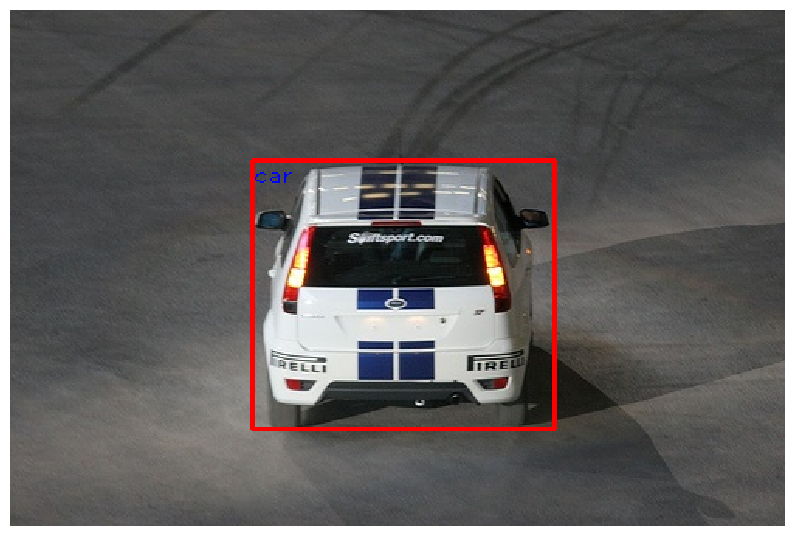

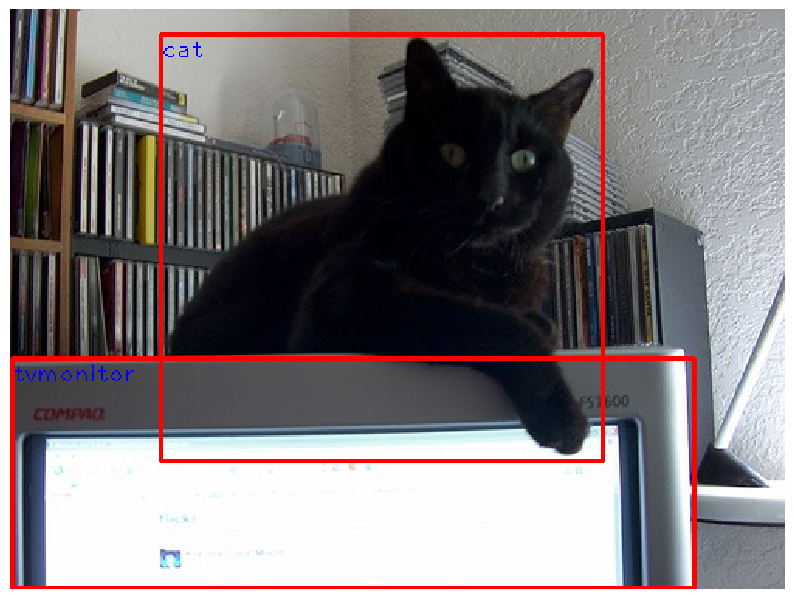

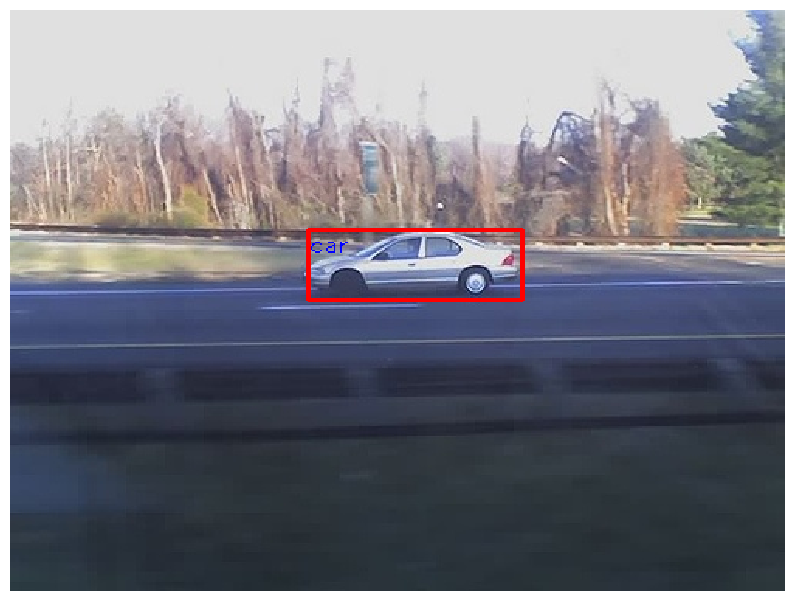

In [ ]:
# visualize GT boxes
for i in range(len(img_list)):
  valid_box = sum([1 if j != -1 else 0 for j in box_list[i][:, 0]])
  data_visualizer(img_list[i], idx_to_class, box_list[i][:valid_box])

## Detector Backbone Network
이번 과제에서는 [MobileNet v2](https://pytorch.org/hub/pytorch_vision_mobilenet_v2/)를 image feature extraction을 위한 backbone 네트워크로 사용할 예정입니다.

In [ ]:
class FeatureExtractor(nn.Module):
  """
  Image feature extraction with MobileNet.
  """
  def __init__(self, reshape_size=224, pooling=False, verbose=False):
    super().__init__()

    from torchvision import models
    from torchsummary import summary

    self.mobilenet = models.mobilenet_v2(pretrained=True)
    self.mobilenet = nn.Sequential(*list(self.mobilenet.children())[:-1]) # Remove the last classifier

    # average pooling
    if pooling:
      self.mobilenet.add_module('LastAvgPool', nn.AvgPool2d(math.ceil(reshape_size/32.))) # input: N x 1280 x 7 x 7

    for i in self.mobilenet.named_parameters():
      i[1].requires_grad = True # fine-tune all

    if verbose:
      summary(self.mobilenet.cuda(), (3, reshape_size, reshape_size))

  def forward(self, img, verbose=False):
    """
    Inputs:
    - img: Batch of resized images, of shape Nx3x224x224

    Outputs:
    - feat: Image feature, of shape Nx1280 (pooled) or Nx1280x7x7
    """
    num_img = img.shape[0]

    img_prepro = img

    feat = []
    process_batch = 500
    for b in range(math.ceil(num_img/process_batch)):
      feat.append(self.mobilenet(img_prepro[b*process_batch:(b+1)*process_batch]
                              ).squeeze(-1).squeeze(-1)) # forward and squeeze
    feat = torch.cat(feat)

    if verbose:
      print('Output feature shape: ', feat.shape)

    return feat

MobileNet v2 내부를 살펴봅시다. 3x224x224 이미지 입력이 있다고 가정하겠습니다.

In [ ]:
model = FeatureExtractor(verbose=True)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=MobileNet_V2_Weights.IMAGENET1K_V1`. You can also use `weights=MobileNet_V2_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/mobilenet_v2-b0353104.pth" to /root/.cache/torch/hub/checkpoints/mobilenet_v2-b0353104.pth
100%|██████████| 13.6M/13.6M [00:00<00:00, 43.6MB/s]


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 32, 112, 112]             864
       BatchNorm2d-2         [-1, 32, 112, 112]              64
             ReLU6-3         [-1, 32, 112, 112]               0
            Conv2d-4         [-1, 32, 112, 112]             288
       BatchNorm2d-5         [-1, 32, 112, 112]              64
             ReLU6-6         [-1, 32, 112, 112]               0
            Conv2d-7         [-1, 16, 112, 112]             512
       BatchNorm2d-8         [-1, 16, 112, 112]              32
  InvertedResidual-9         [-1, 16, 112, 112]               0
           Conv2d-10         [-1, 96, 112, 112]           1,536
      BatchNorm2d-11         [-1, 96, 112, 112]             192
            ReLU6-12         [-1, 96, 112, 112]               0
           Conv2d-13           [-1, 96, 56, 56]             864
      BatchNorm2d-14           [-1, 96,

## Anchor and Proposal

강의 내용 중 소개해드렸듯이, Faster R-CNN에는 *anchor box*라고 불리는 개념이 도입됩니다. 이는 추후 one-stage detector인 YOLO v2 등의 모델에서도 사용됩니다.

이미지를 backbone network에 거치도록 하고 나서, 우리는 shape이 $(C, 7, 7)$인 feature map을 얻게 될 것입니다. 이는 C-dimensional feature의 7x7 grid로 해석할 수 있습니다. grid의 각 point 별로 우리는 다른 크기와 모양의 $A$개의 anchor box를 고려할 예정입니다. 각 anchor box 별로 우리는 이 box의 objectness를 판단하여 해당 box가 object/background 중 어디에 해당하는지 분류합니다. 총 anchor box의 수는 $(A, 7, 7)$이 될 것이고, 우리는 이에 convolutional layer들을 거쳐 classification score를 예측할 것입니다.

backbone activation feature map에 3x3 conv layer와 같은 작은 크기의 CNN architecture를 적용시킵니다. 이 3x3 conv를 *sliding window*라고 부릅니다. 각 location (i.e. 7x7 activation cell의 각 위치의 중심)에서 우리는 다수의  region *proposals*을 예측할 것이며, $A=9$가 될 것입니다.

이 이후에 우리는 각 proposal에 대한 objectness를 추정하는 A-D score를 output으로 하는 object proposal layer, A개의 box의 좌표들에 대해 4A-D output을 만들어내는 bounding box regression layer, 그리고 모든 A개의 anchor가 공유하는 object category에 대한 score를 나타내는 20-D output을 만들어내는 region classification layer를 적용시킬 예정입니다. A개의 proposal들은 각각 A개의 anchor에 대해 상대적으로 parameterize되어있으며, 각 anchor는 sliding window를 중심으로 다양한 크기로 만들어집니다 (e.g., 1x1, 3x3, 5x5). anchor shape들의 list는 다음 셀에 주어집니다.






### Anchor shapes

anchor box들의 shape는 hyperparameter입니다. 일부 논문들에서는 anchor shape를 ground-truth box size를 clustering하여 정하기도 하지만, 이번 과제에는 단순하게 pre-define하도록 하겠습니다.

original image에 대한 activation cell의 receptive field는 sliding window보다 클 수 있으므로 anchor의 크기는 3x3 sliding window보다 클 수 있습니다.

In [ ]:
# Declare variables for anchor priors, a Ax2 Tensor where A is the number of anchors.
# Hand-picked, same as our two-stage detector.
anchor_list = torch.tensor([[1, 1], [2, 2], [3, 3], [4, 4], [5, 5], [2, 3], [3, 2], [3, 5], [5, 3]], **to_float_cuda)
print(anchor_list.shape)

torch.Size([9, 2])


### Activation Grid Generator

7x7 backbone feature의 grid의 각 위치에 대한 anchor를 구하기 위해서 우리는 7x7 grid의 각 cell의 중심의 위치를 계산해야 합니다.

다음 함수를 통해 center coordinate를 계산합니다.

In [ ]:
def GenerateGrid(batch_size, w_amap=7, h_amap=7, dtype=torch.float32, device='cuda'):
  """
  Return a grid cell given a batch size (center coordinates).

  Inputs:
  - batch_size, B
  - w_amap: or W', width of the activation map (number of grids in the horizontal dimension)
  - h_amap: or H', height of the activation map (number of grids in the vertical dimension)
  - W' and H' are always 7 in our case while w and h might vary.

  Outputs:
  grid: A float32 tensor of shape (B, H', W', 2) giving the (x, y) coordinates
        of the centers of each feature for a feature map of shape (B, D, H', W')
  """
  w_range = torch.arange(0, w_amap, dtype=dtype, device=device) + 0.5
  h_range = torch.arange(0, h_amap, dtype=dtype, device=device) + 0.5

  w_grid_idx = w_range.unsqueeze(0).repeat(h_amap, 1)
  h_grid_idx = h_range.unsqueeze(1).repeat(1, w_amap)
  grid = torch.stack([w_grid_idx, h_grid_idx], dim=-1)
  grid = grid.unsqueeze(0).repeat(batch_size, 1, 1, 1)
  return grid

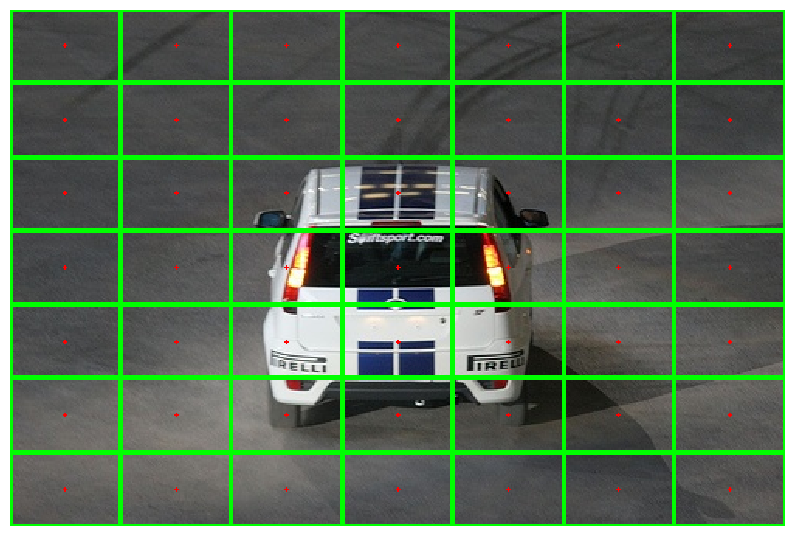

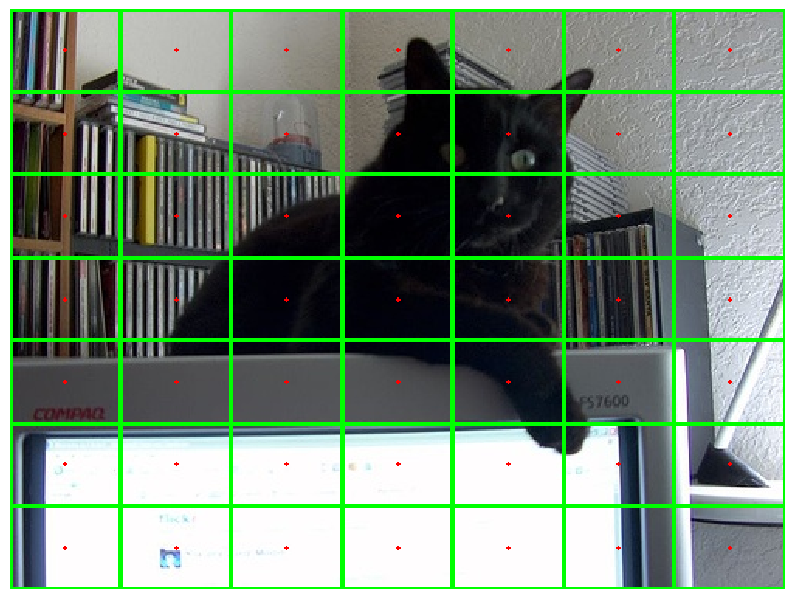

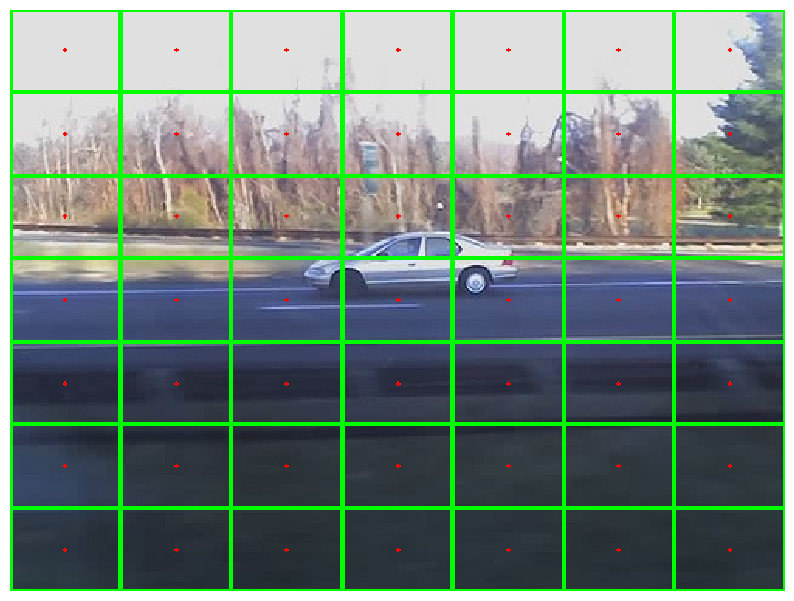

In [ ]:
# visualization
# simply create an activation grid where the cells are in green and the centers in red
# you should see the entire image divided by a 7x7 grid, with no gaps on the edges

grid_list = GenerateGrid(w_list.shape[0])

center = torch.cat((grid_list, grid_list), dim=-1)
grid_cell = center.clone()
grid_cell[:, :, :, [0, 1]] -= 1. / 2.
grid_cell[:, :, :, [2, 3]] += 1. / 2.
center = coord_trans(center, w_list, h_list)
grid_cell = coord_trans(grid_cell, w_list, h_list)

for img, anc, grid in zip(img_list, center, grid_cell):
  data_visualizer(img, idx_to_class, anc.reshape(-1, 4), grid.reshape(-1, 4))

### Anchor Generator
이제 anchor box의 position을 구해봅시다.

anchor coordinate를 다음과 같이 표기하도록 하겠습니다.

($x_{tl}^a$, $y_{tl}^a$, $x_{br}^a$, $y_{br}^a$)

이는 top-left corner와 bottom-right corner의 좌표값이고, 아래 함수는 모든 anchor를 주어진 cell과 anchor shape list에 따른 모든 anchor를 return합니다.

**anchor의 center와 grid cell center는 동일합니다.**

TODO 부분을 직접 채워보세요.

In [ ]:
def GenerateAnchor(anc, grid):
  """
  Anchor generator.

  Inputs:
  - anc: Tensor of shape (A, 2) giving the shapes of anchor boxes to consider at
    each point in the grid. anc[a] = (w, h) gives the width and height of the
    a'th anchor shape.
  - grid: Tensor of shape (B, H', W', 2) giving the (x, y) coordinates of the
    center of each feature from the backbone feature map. This is the tensor
    returned from GenerateGrid.

  Outputs:
  - anchors: Tensor of shape (B, A, H', W', 4) giving the positions of all
    anchor boxes for the entire image. anchors[b, a, h, w] is an anchor box
    centered at grid[b, h, w], whose shape is given by anc[a]; we parameterize
    boxes as anchors[b, a, h, w] = (x_tl, y_tl, x_br, y_br), where (x_tl, y_tl)
    and (x_br, y_br) give the xy coordinates of the top-left and bottom-right
    corners of the box.
  """
  anchors = None
  ##############################################################################
  # TODO: Given a set of anchor shapes and a grid cell on the activation map,  #
  # generate all the anchor coordinates for each image. Support batch input.   #
  ############################################################################

  B, H, W, _ = grid.shape
  A = anc.shape[0] # 9
  anchors = torch.zeros((B, A, H, W, 4), dtype=grid.dtype, device=grid.device)

  for b in range(B):
    for a in range(A):
      for h in range(H):
        for w in range(W):
          x_tl = grid[b,h,w,0] - anc[a,0]/2
          y_tl = grid[b,h,w,1] - anc[a,1]/2
          x_br = grid[b,h,w,0] + anc[a,0]/2
          y_br = grid[b,h,w,1] + anc[a,1]/2
          anchors[b,a,h,w,:] = torch.Tensor([x_tl, y_tl, x_br, y_br])


  ##############################################################################
  #                               END OF YOUR CODE                             #
  ##############################################################################

  return anchors

여러분이 구현을 맞게 했다면, 아래에서 1e-8 단위 혹은 그보다 작은 error 값을 가질 것입니다.

In [ ]:
# sanity check
anc_list = GenerateAnchor(anchor_list, grid_list)
assert anc_list.shape == torch.Size([3, 9, 7, 7, 4]), 'shape mismatch!'

expected_anc_list_mean = torch.tensor([[-1.25000000, -0.87500000,  2.25000000,  1.87500000],
                                       [ 1.75000000, -0.87500000,  5.25000000,  1.87500000],
                                       [ 4.75000000, -0.87500000,  8.25000000,  1.87500000],
                                       [-1.25000000,  1.12500000,  2.25000000,  3.87500000],
                                       [ 1.75000000,  1.12500000,  5.25000000,  3.87500000],
                                       [ 4.75000000,  1.12500000,  8.25000000,  3.87500000],
                                       [-1.25000000,  3.12500000,  2.25000000,  5.87500000],
                                       [ 1.75000000,  3.12500000,  5.25000000,  5.87500000],
                                       [ 4.75000000,  3.12500000,  8.25000000,  5.87500000],
                                       [-1.25000000,  5.12500000,  2.25000000,  7.87500000],
                                       [ 1.75000000,  5.12500000,  5.25000000,  7.87500000],
                                       [ 4.75000000,  5.12500000,  8.25000000,  7.87500000]], **to_float_cuda)
print('rel error: ', rel_error(expected_anc_list_mean, anc_list[0, [1,3,6,8], ::2, ::3, :].view(-1, 12, 4).mean(0)))

rel error:  0.0


********************************************************************************
All nine anchors should be exactly centered:
torch.Size([9, 1, 1, 4])


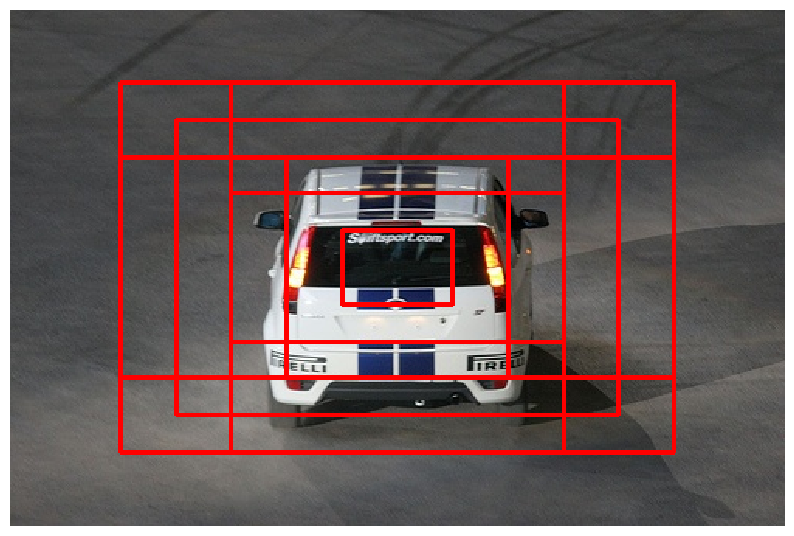

torch.Size([9, 1, 1, 4])


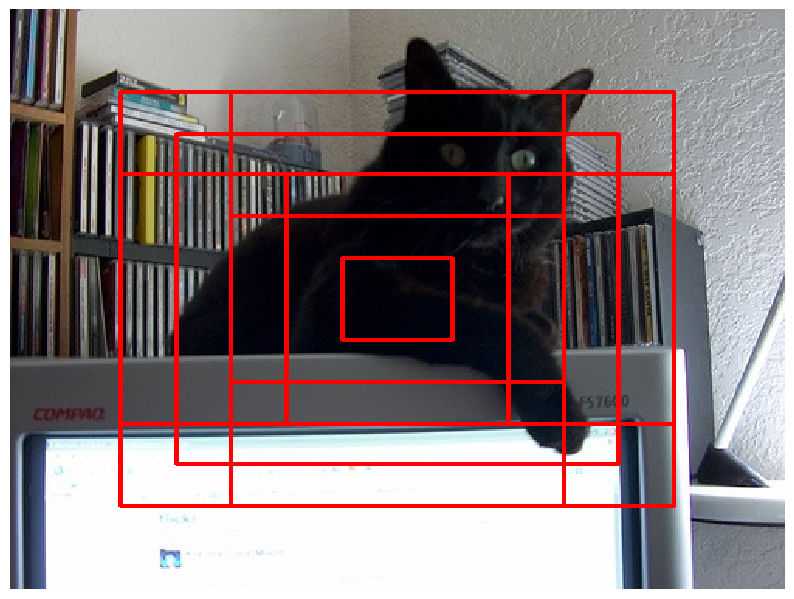

torch.Size([9, 1, 1, 4])


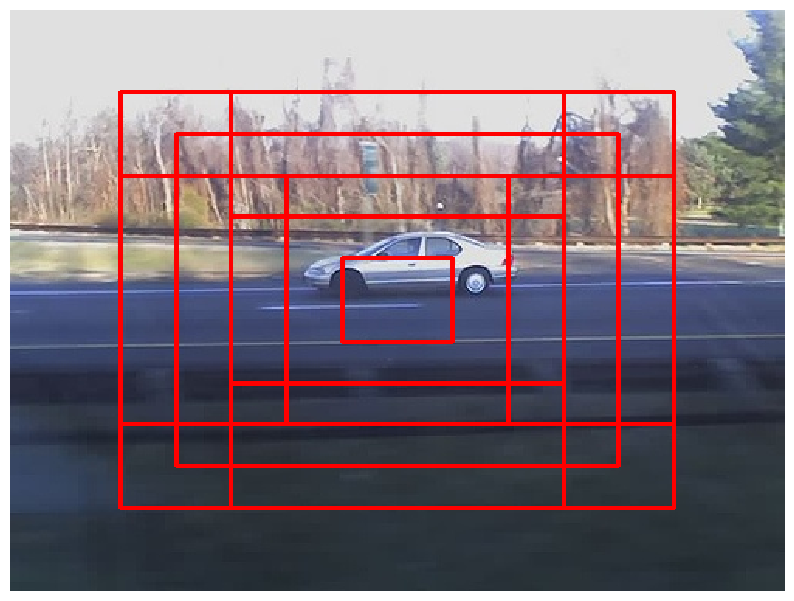

********************************************************************************
All anchors of the image (cluttered):
tensor([[[[[ 0.0000,  0.0000,  1.0000,  1.0000],
           [ 1.0000,  0.0000,  2.0000,  1.0000],
           [ 2.0000,  0.0000,  3.0000,  1.0000],
           ...,
           [ 4.0000,  0.0000,  5.0000,  1.0000],
           [ 5.0000,  0.0000,  6.0000,  1.0000],
           [ 6.0000,  0.0000,  7.0000,  1.0000]],

          [[ 0.0000,  1.0000,  1.0000,  2.0000],
           [ 1.0000,  1.0000,  2.0000,  2.0000],
           [ 2.0000,  1.0000,  3.0000,  2.0000],
           ...,
           [ 4.0000,  1.0000,  5.0000,  2.0000],
           [ 5.0000,  1.0000,  6.0000,  2.0000],
           [ 6.0000,  1.0000,  7.0000,  2.0000]],

          [[ 0.0000,  2.0000,  1.0000,  3.0000],
           [ 1.0000,  2.0000,  2.0000,  3.0000],
           [ 2.0000,  2.0000,  3.0000,  3.0000],
           ...,
           [ 4.0000,  2.0000,  5.0000,  3.0000],
           [ 5.0000,  2.0000,  6.0000,  3.000

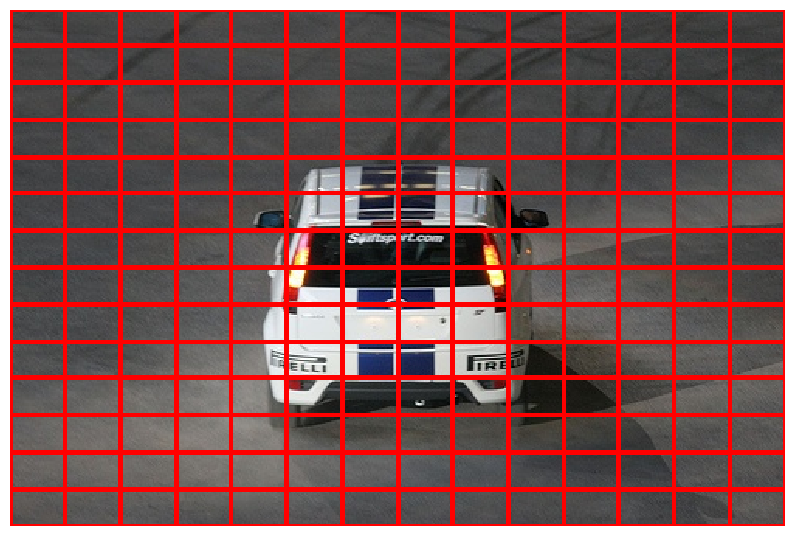

torch.Size([9, 7, 7, 4])


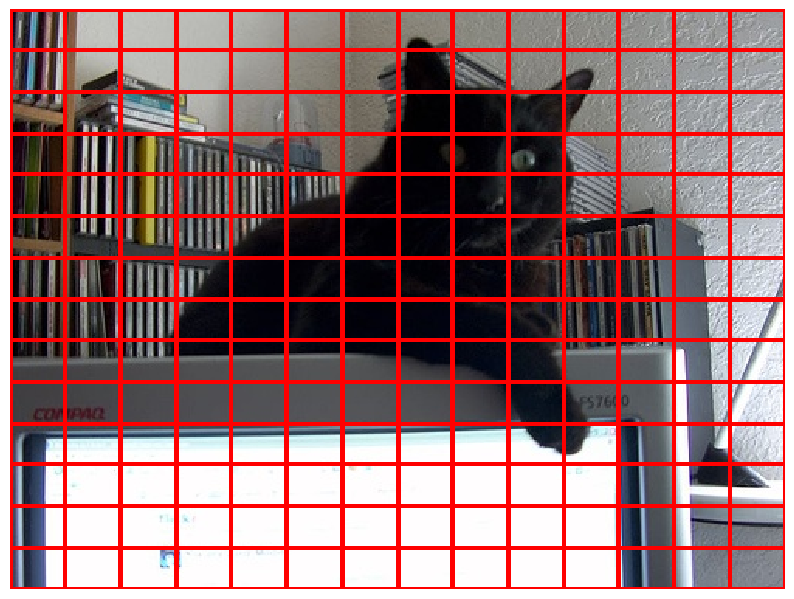

torch.Size([9, 7, 7, 4])


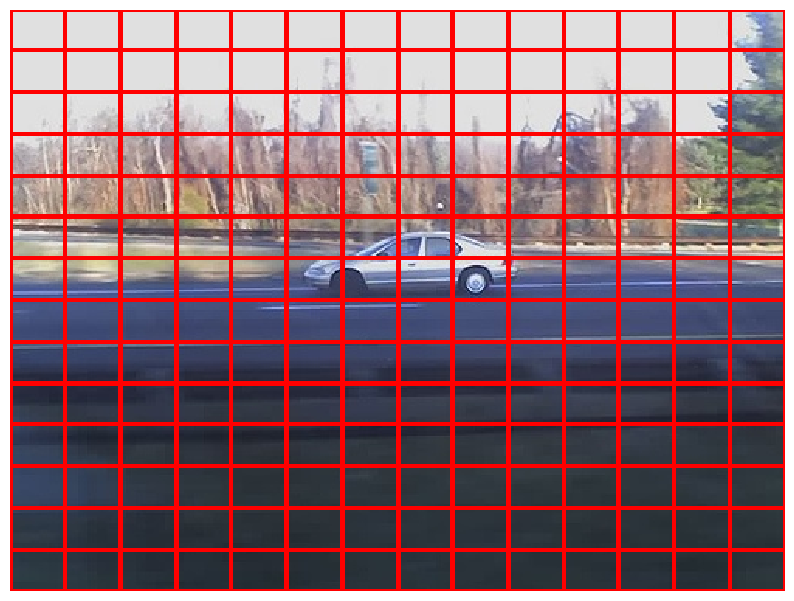

In [ ]:
# visualization
print('*'*80)
print('All nine anchors should be exactly centered:')
anc_list = GenerateAnchor(anchor_list, grid_list[:, 3:4, 3:4])
for img, anc in zip(img_list, coord_trans(anc_list, w_list, h_list)):
  print(anc.shape)
  data_visualizer(img, idx_to_class, anc.reshape(-1, 4))

print('*'*80)
print('All anchors of the image (cluttered):')
anc_list = GenerateAnchor(anchor_list, grid_list) # all
print(anc_list)
for img, anc in zip(img_list, coord_trans(anc_list, w_list, h_list)):
  print(anc.shape)
  data_visualizer(img, idx_to_class, anc.reshape(-1, 4))

### Proposal Generator

만약 우리가 object들의 위치를 제안하기 위해 anchor를 그대로 사용한다면, 우리는 image에서 9x7x7=441개의 region만 cover할 수 있을 겁니다. 만약 object가 이 441개의 anchor의 region 안에 있지 않다면 어떻게 해야 할까요?

그렇기에 anchor box를 *region proposal*로 변환해주는 transformation을 예측하는 작업을 진행해야 합니다.

$(x_{tl}^a, y_{tl}^a, x_{br}^a, y_{br}^a)$의 anchor box가 있다고 할 때, transformation formulation을 더 쉽게 하기 위해 이제부터는 이를 box 중심의 x/y coordinate와 width, height: $(x_c^a,y_c^a,w^a,h^a)$로 표현할 것입니다.

$(x_c^a,y_c^a,w^a,h^a)$의 anchor box에 대해 network가 *transformation* $(t^x, t^y, t^w, t^h)$을 예측하고, 이 transformation을 적용시킨 *region proposal*의 center, width and height $(x_c^p,y_c^p,w^p,h^p)$를 구합니다.

여러분들은 다음 식을 구현해주시면 됩니다.

### Faster R-CNN
Faster R-CNN은 모든 parameter $t^x, t^y, t^w, t_h$의 범위가 실수 전체 $(-\infty, \infty)$입니다. 수식은 다음과 같습니다:
- $x_c^p = x_c^a + t^xw^a$
- $y_c^p = y_c^p + t^yh^a$
- $w^p = w_a exp(t^w)$
- $h^p = h_a exp(t^h)$


### Training

학습을 위해서 우리는 ground-truth transformation $(\hat{t^x}, \hat{t^y}, \hat{t^w}, \hat{t^h})$을 계산합니다. 이는 anchor box $(x_c^a,y_c^a,w^a,h^a)$를  the ground-truth box $(x_c^{gt},y_c^{gt},w^{gt},h^{gt})$로 변환하는 transformation입니다.

이후 우리는 regression loss를 통해 predicted transform $(t^x, t^y, t^w, t^h)$ 과 ground-truth transform 사이의 차이를 penalize합니다.

In [ ]:
def GenerateProposal(anchors, offsets, method='YOLO'):
  """
  Proposal generator.

  Inputs:
  - anchors: Anchor boxes, of shape (B, A, H', W', 4). Anchors are represented
    by the coordinates of their top-left and bottom-right corners.
  - offsets: Transformations of shape (B, A, H', W', 4) that will be used to
    convert anchor boxes into region proposals. The transformation
    offsets[b, a, h, w] = (tx, ty, tw, th) will be applied to the anchor
    anchors[b, a, h, w]. For YOLO, assume that tx and ty are in the range
    (-0.5, 0.5).
  - method: Which transformation formula to use, either 'YOLO' or 'FasterRCNN'

  Outputs:
  - proposals: Region proposals of shape (B, A, H', W', 4), represented by the
    coordinates of their top-left and bottom-right corners. Applying the
    transform offsets[b, a, h, w] to the anchor [b, a, h, w] should give the
    proposal proposals[b, a, h, w].

  """
  assert(method in ['FasterRCNN', 'YOLO'])
  proposals = None
  ##############################################################################
  # TODO: Given anchor coordinates and the proposed offset for each anchor,    #
  # compute the proposal coordinates using the transformation formulas above.  #
  ##############################################################################
  # Replace "pass" statement with your code


  B, A, H, W, _ = anchors.shape
  proposals = torch.zeros(B, A, H, W, 4, device='cuda')

  wa = anchors[:, :, :, :, 2] - anchors[:, :, :, :, 0]  # width of anchors
  ha = anchors[:, :, :, :, 3] - anchors[:, :, :, :, 1]  # height of anchors

  xac = (anchors[:, :, :, :, 2] + anchors[:, :, :, :, 0]) / 2.  # x center of anchors
  yac = (anchors[:, :, :, :, 3] + anchors[:, :, :, :, 1]) / 2.  # y center of anchors
  xpc = xac + offsets[:, :, :, :, 0] * wa
  ypc = yac + offsets[:, :, :, :, 1] * ha
  wp = wa * torch.exp(offsets[:, :, :, :, 2])
  hp = ha * torch.exp(offsets[:, :, :, :, 3])

  proposals[:, :, :, :, 0] = xpc - wp / 2.  # xtl
  proposals[:, :, :, :, 1] = ypc - hp / 2.  # ytl
  proposals[:, :, :, :, 2] = xpc + wp / 2.  # xbr
  proposals[:, :, :, :, 3] = ypc + hp / 2.  # ybr

  ##############################################################################
  #                               END OF YOUR CODE                             #
  ##############################################################################

  return proposals

올바른 구현을 하셨다면 아래 cell을 작동시키면 1e-7 단위 혹은 그보다 작은 error 값을 갖게 될 것입니다.

In [ ]:
print('-' * 80)
print('Sanity check for FasterRCNN.')
rcnn_offset_list = torch.ones_like(anc_list)
rcnn_proposal_list = GenerateProposal(anc_list, rcnn_offset_list, 'FasterRCNN')

print('1. x/y shifted by wh')
print('rel error: ', rel_error(anc_list[0, 0, 0, :, 0:2] + (anc_list[0, 0, 0, :, 2:4] - anc_list[0, 0, 0, :, 0:2]) * 3.0 /2.0, \
      (rcnn_proposal_list[0, 0, 0, :, 0:2] + (rcnn_proposal_list[0, 0, 0, :, 2:4] - rcnn_proposal_list[0, 0, 0, :, 0:2]) / 2.0)))

print('2. w/h should changed by e')
print('rel error: ', rel_error((anc_list[0, 0, 0, :, 2:4] - anc_list[0, 0, 0, :, 0:2]) * torch.exp(torch.ones_like(anc_list[0, 0, 0, :, 0:2])), \
      (rcnn_proposal_list[0, 0, 0, :, 2:4] - rcnn_proposal_list[0, 0, 0, :, 0:2])))

--------------------------------------------------------------------------------
Sanity check for FasterRCNN.
1. x/y shifted by wh
rel error:  0.0
2. w/h should changed by e
rel error:  1.7541862007419695e-07


Faster R-CNN에서 transformation을 진행한 proposal (green)을 visualize해봅시다. $(1, 1, 0, 0)$의 transformation을 적용한다면 proposal은 anchor의 크기와 같은 양만큼 우측 아래로 shift되어야 할 것입니다.

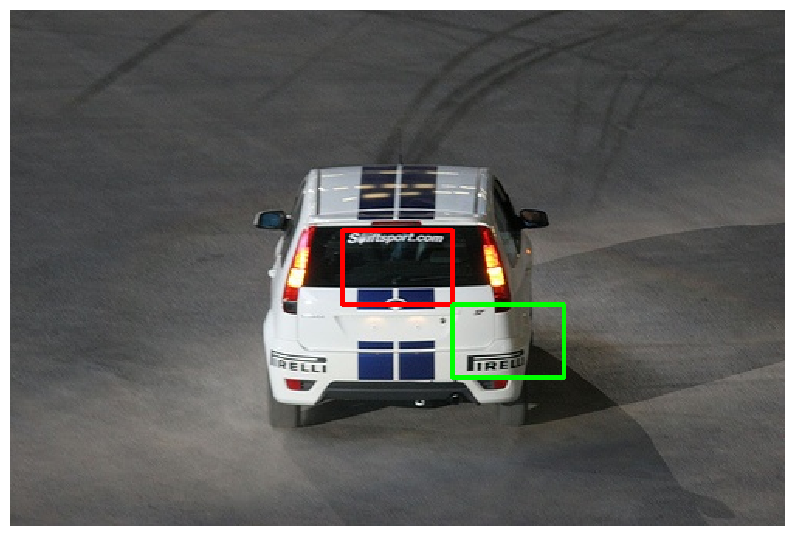

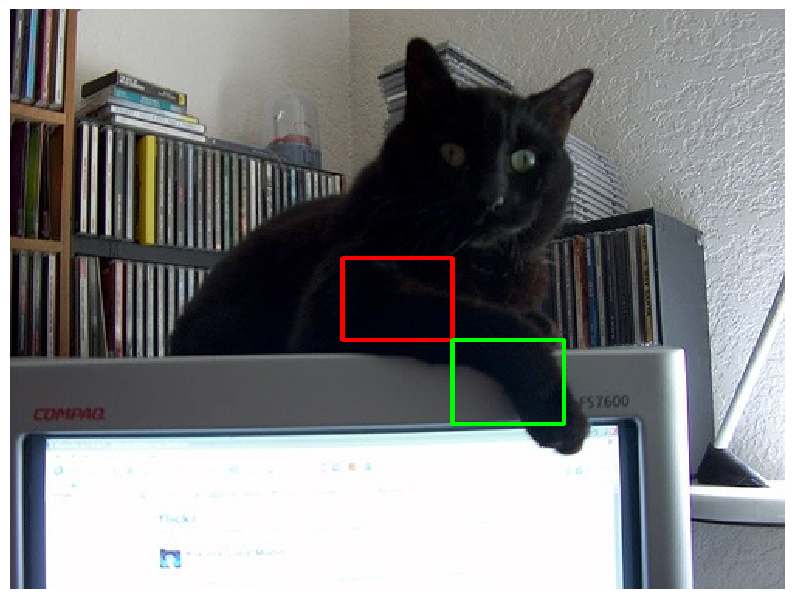

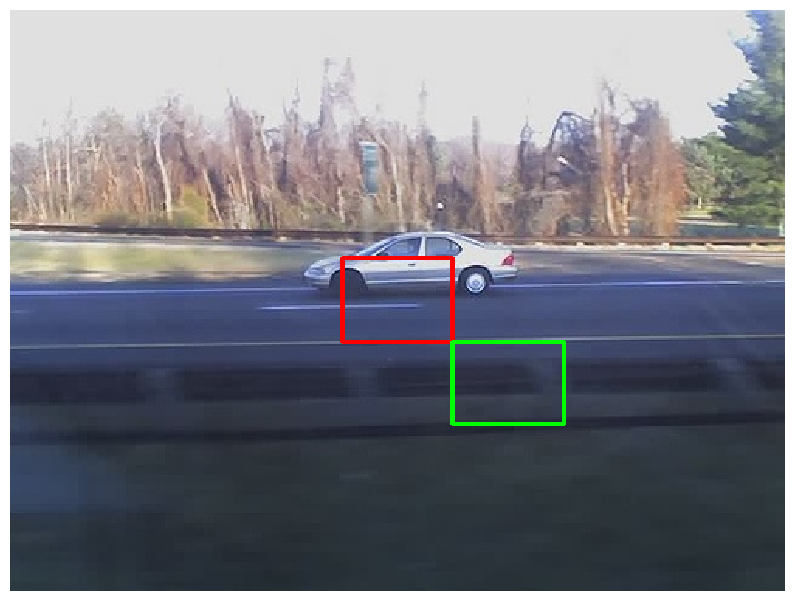

In [ ]:
# visualization (shift by wh, Faster R-CNN)
# anchors in red and proposals in green
rcnn_offset_list = torch.cat([torch.ones_like(anc_list[:, :, :, :, 0:2]), torch.zeros_like(anc_list[:, :, :, :, 2:4])], dim=-1)
rcnn_proposal_list = GenerateProposal(anc_list, rcnn_offset_list, 'FasterRCNN')

for img, anc, prop in zip(img_list, coord_trans(anc_list[:, 0:1, 3:4, 3:4, :], w_list, h_list), \
                          coord_trans(rcnn_proposal_list[:, 0:1, 3:4, 3:4, :], w_list, h_list)):
  data_visualizer(img, idx_to_class, anc.reshape(-1, 4), prop.reshape(-1, 4))

$(0, 0, 1, 1)$을 적용한다면 center는 같고 e의 승수 크기만큼 커진 proposal을 얻게 될 것입니다.

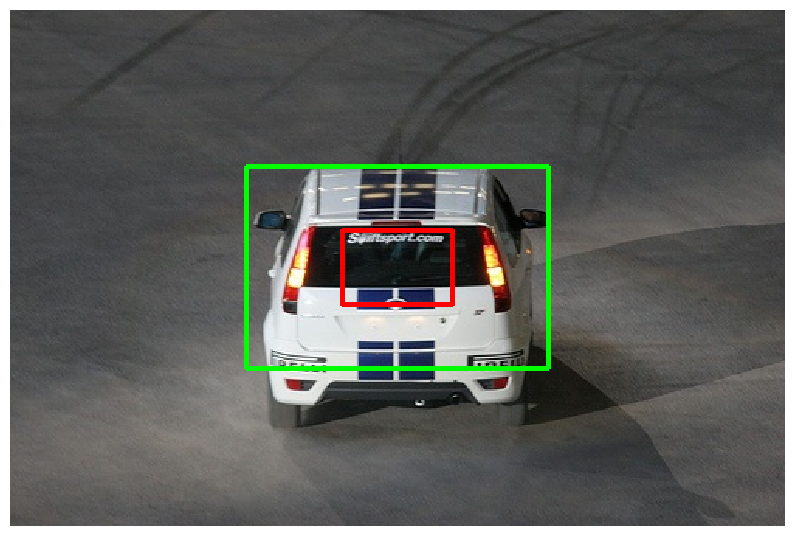

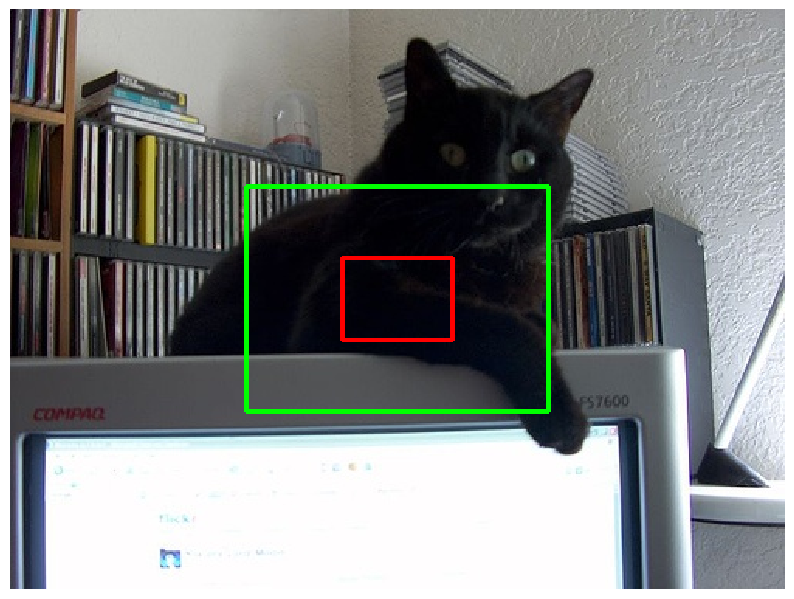

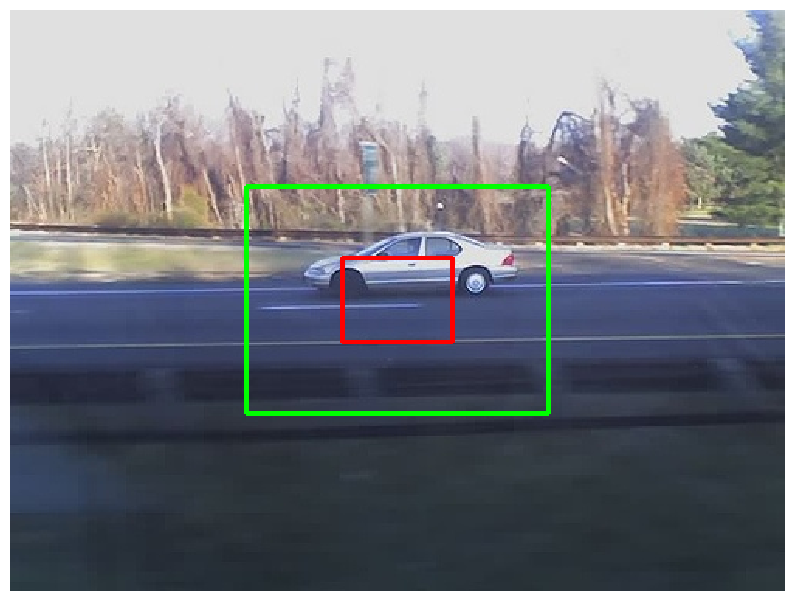

In [ ]:
# visualization (no shift and then scale by e, Faster R-CNN)
# anchors in red and proposals in green
rcnn_offset_list = torch.cat([torch.zeros_like(anc_list[:, :, :, :, 0:2]), torch.ones_like(anc_list[:, :, :, :, 2:4]).fill_(1)], dim=-1)
rcnn_proposal_list = GenerateProposal(anc_list, rcnn_offset_list, 'FasterRCNN')

for img, anc, prop in zip(img_list, coord_trans(anc_list[:, 0:1, 3:4, 3:4, :], w_list, h_list), \
                          coord_trans(rcnn_proposal_list[:, 0:1, 3:4, 3:4, :], w_list, h_list)):
  data_visualizer(img, idx_to_class, anc.reshape(-1, 4), prop.reshape(-1, 4))

### Intersection Over Union (IoU)

IoU는 강의 시간에 다뤘던 거 다들 기억하시죠? 자세한 정의는 밑의 링크에서 확인해주세요!

In [ ]:
def IoU(proposals, bboxes):
  """
  Compute intersection over union between sets of bounding boxes.

  Inputs:
  - proposals: Proposals of shape (B, A, H', W', 4)
  - bboxes: Ground-truth boxes from the DataLoader of shape (B, N, 5).
    Each ground-truth box is represented as tuple (x_lr, y_lr, x_rb, y_rb, class).
    If image i has fewer than N boxes, then bboxes[i] will be padded with extra
    rows of -1.

  Outputs:
  - iou_mat: IoU matrix of shape (B, A*H'*W', N) where iou_mat[b, i, n] gives
    the IoU between one element of proposals[b] and bboxes[b, n].

  For this implementation you DO NOT need to filter invalid proposals or boxes;
  in particular you don't need any special handling for bboxxes that are padded
  with -1.
  """
  iou_mat = None
  ##############################################################################
  # TODO: Compute the Intersection over Union (IoU) on proposals and GT boxes. #
  # No need to filter invalid proposals/bboxes (i.e., allow region area <= 0). #
  # You need to ensure your implementation is efficient (no for loops).        #
  # HINT:                                                                      #
  # IoU = Area of Intersection / Area of Union, where
  # Area of Union = Area of Proposal + Area of BBox - Area of Intersection     #
  # and the Area of Intersection can be computed using the top-left corner and #
  # bottom-right corner of proposal and bbox. Think about their relationships. #
  ##############################################################################

  B, A, H, W, _ = proposals.shape
  _, N, _ = bboxes.shape

  proposals = proposals.view(B, A * H * W, 4)
  proposals = proposals.unsqueeze(2).repeat(1, 1, N, 1)

  iou_mat = torch.zeros((B, A * H * W, N), device=proposals.device)*-1

  max_x1 = torch.max(proposals[:,:,:,0], bboxes[:,:,0].unsqueeze(1))
  max_y1 = torch.max(proposals[:,:,:,1], bboxes[:,:,1].unsqueeze(1))
  min_x2 = torch.min(proposals[:,:,:,2], bboxes[:,:,2].unsqueeze(1))
  min_y2 = torch.min(proposals[:,:,:,3], bboxes[:,:,3].unsqueeze(1))

  inter_area = torch.clamp(min_x2-max_x1,min=0) * torch.clamp(min_y2-max_y1,min=0)

  Area1 = (bboxes[:,:,2]-bboxes[:,:,0])*(bboxes[:,:,3]-bboxes[:,:,1])
  Area2 = (proposals[:,:,:,2]-proposals[:,:,:,0])*(proposals[:,:,:,3]-proposals[:,:,:,1])

  iou_mat = inter_area/(Area1.unsqueeze(1) + Area2 - inter_area)


  ##############################################################################
  #                               END OF YOUR CODE                             #
  ##############################################################################
  return iou_mat

구현이 잘 되었다면, error의 값이 1e-8 단위 혹은 그보다 작을 것입니다.

In [ ]:
# simple sanity check
width, height = torch.tensor([35, 35], **to_float_cuda), torch.tensor([40, 40], **to_float_cuda)
sample_bbox = torch.tensor([[[1,1,11,11,0], [20,20,30,30,0]]], **to_float_cuda)
sample_proposals = torch.tensor([[[[[5,5,15,15], [27,27,37,37]]]]], **to_float_cuda)

result = IoU(sample_proposals, sample_bbox)

# check 1
expected_result = torch.tensor([[[0.21951219, 0.00000000],
                                 [0.00000000, 0.04712042]]], **to_float_cuda)
print('simple iou_mat error: ', rel_error(expected_result, result))

# check 2

iou_mat = IoU(anc_list, resized_box_list)
expected_iou_mat = torch.tensor([0.11666405, 0.15146968, 0.02956639], **to_float_cuda)
print('iou_mat error: ', rel_error(expected_iou_mat, iou_mat[:, :, 0].mean(1)))

simple iou_mat error:  0.0
iou_mat error:  6.299873689386004e-08


## Region Proposal Networks (RPN)

Faster R-CNN의 첫 번째 stage는 *Region Proposal Network (RPN)*입니다. RPN은 anchor들이 object를 포함하는지 혹은 그렇지 않은지 분류하고, anchor box로부터 region proposal로의 regression을 진행합니다.

RPN은 사실 위에서 구현했던 single-stage detector와 매우 유사하고, 차이는 RPN에서는 classification score를 예측하지 않는다는 것입니다. 따라서 우리는 위에서 구현한 다양한 함수를 RPN을 구현하는 과정에서도 사용할 것입니다!

### Anchor

In [ ]:
# Declare variables for anchor priors, a Ax2 Tensor where A is the number of anchors.
# Hand-picked, same as our two-stage detector.
anchor_list = torch.tensor([[1, 1], [2, 2], [3, 3], [4, 4], [5, 5], [2, 3], [3, 2], [3, 5], [5, 3]], **to_float_cuda)
print(anchor_list.shape)

torch.Size([9, 2])


### Activated (positive) and negative anchors

훈련 과정에서 우리는 각 anchor들에 대한 classification label을 결정하기 위해 ground-truth box들을 anchor들에 matching시켜야 합니다. 이는 어떤 anchor가 object를 포함하는지 혹은 background로 분류되어야 하는지를 결정해야 한다는 의미입니다. 이 부분은 아래에 구현이 되어 있습니다.

아래 함수 설명과 구현을 자세히 읽어보시는 것을 매우 추천드립니다. input / output definition과 코드 구현을 잘 살펴보세요.

In [ ]:
def ReferenceOnActivatedAnchors(anchors, bboxes, grid, iou_mat, pos_thresh=0.7, neg_thresh=0.3, method='FasterRCNN'):
  """
  Determine the activated (positive) and negative anchors for model training.

  For Faster R-CNN - Positive anchors are defined Any of the two
  (i) the anchor/anchors with the highest IoU overlap with a GT box, or
  (ii) an anchor that has an IoU overlap higher than 0.7 with any GT box.
  Note: One anchor can match at most one GT box (the one with the largest IoU overlapping).

  We assign a negative label to a anchor if its IoU ratio is lower than
  a threshold value for all GT boxes. Anchors that are neither positive nor negative
  do not contribute to the training objective.

  Main steps include:
  i) Decide activated and negative anchors based on the IoU matrix.
  ii) Compute GT confidence score/offsets/object class on the positive proposals.
  iii) Compute GT confidence score on the negative proposals.

  Inputs:
  - anchors: Anchor boxes, of shape BxAxH’xW’x4
  - bboxes: GT boxes of shape BxNx5, where N is the number of PADDED GT boxes,
            5 indicates (x_{lr}^{gt}, y_{lr}^{gt}, x_{rb}^{gt}, y_{rb}^{gt}) and class index
  - grid (float): A cell grid of shape BxH'xW'x2 where 2 indicate the (x, y) coord
  - iou_mat: IoU matrix of shape Bx(AxH’xW’)xN
  - pos_thresh: Positive threshold value
  - neg_thresh: Negative threshold value
  - method: Switch between 'YOLO' mode and 'FasterRCNN' mode

  Outputs:
  - activated_anc_ind: Index on activated anchors, of shape M, where M indicates the
                       number of activated anchors
  - negative_anc_ind: Index on negative anchors, of shape M
  - GT_conf_scores: GT IoU confidence scores on activated anchors, of shape M
  - GT_offsets: GT offsets on activated anchors, of shape Mx4. They are denoted as
                \hat{t^x}, \hat{t^y}, \hat{t^w}, \hat{t^h} in the formulation earlier.
  - GT_class: GT class category on activated anchors, essentially indexed from bboxes[:, :, 4],
              of shape M
  - activated_anc_coord: Coordinates on activated anchors (mainly for visualization purposes)
  - negative_anc_coord: Coordinates on negative anchors (mainly for visualization purposes)
  """

  assert(method in ['FasterRCNN'])

  B, A, h_amap, w_amap, _ = anchors.shape
  N = bboxes.shape[1]

  # activated/positive anchors
  max_iou_per_anc, max_iou_per_anc_ind = iou_mat.max(dim=-1)
  if method == 'FasterRCNN':
    max_iou_per_box = iou_mat.max(dim=1, keepdim=True)[0]
    activated_anc_mask = (iou_mat == max_iou_per_box) & (max_iou_per_box > 0)
    activated_anc_mask |= (iou_mat > pos_thresh) # using the pos_thresh condition as well
    # if an anchor matches multiple GT boxes, choose the box with the largest iou
    activated_anc_mask = activated_anc_mask.max(dim=-1)[0] # Bx(AxH’xW’)
    activated_anc_ind = torch.nonzero(activated_anc_mask.view(-1)).squeeze(-1)

    # GT conf scores
    GT_conf_scores = max_iou_per_anc[activated_anc_mask] # M

    # GT class
    box_cls = bboxes[:, :, 4].view(B, 1, N).expand((B, A*h_amap*w_amap, N))
    GT_class = torch.gather(box_cls, -1, max_iou_per_anc_ind.unsqueeze(-1)).squeeze(-1) # M
    GT_class = GT_class[activated_anc_mask].long()

    bboxes_expand = bboxes[:, :, :4].view(B, 1, N, 4).expand((B, A*h_amap*w_amap, N, 4))
    bboxes = torch.gather(bboxes_expand, -2, max_iou_per_anc_ind.unsqueeze(-1) \
      .unsqueeze(-1).expand(B, A*h_amap*w_amap, 1, 4)).view(-1, 4)
    bboxes = bboxes[activated_anc_ind]

  print('number of pos proposals: ', activated_anc_ind.shape[0])
  activated_anc_coord = anchors.view(-1, 4)[activated_anc_ind]

  # GT offsets
  # bbox and anchor coordinates are x_tl, y_tl, x_br, y_br
  # offsets are t_x, t_y, t_w, t_h
  wh_offsets = torch.log((bboxes[:, 2:4] - bboxes[:, :2]) \
    / (activated_anc_coord[:, 2:4] - activated_anc_coord[:, :2]))

  xy_offsets = (bboxes[:, :2] + bboxes[:, 2:4] - \
    activated_anc_coord[:, :2] - activated_anc_coord[:, 2:4]) / 2.

  if method == "FasterRCNN":
    xy_offsets /= (activated_anc_coord[:, 2:4] - activated_anc_coord[:, :2])

  GT_offsets = torch.cat((xy_offsets, wh_offsets), dim=-1)

  # negative anchors
  negative_anc_mask = (max_iou_per_anc < neg_thresh) # Bx(AxH’xW’)
  negative_anc_ind = torch.nonzero(negative_anc_mask.view(-1)).squeeze(-1)
  negative_anc_ind = negative_anc_ind[torch.randint(0, negative_anc_ind.shape[0], (activated_anc_ind.shape[0],))]
  negative_anc_coord = anchors.view(-1, 4)[negative_anc_ind.view(-1)]

  # activated_anc_coord and negative_anc_coord are mainly for visualization purposes
  return activated_anc_ind, negative_anc_ind, GT_conf_scores, GT_offsets, GT_class, \
         activated_anc_coord, negative_anc_coord

error는 1e-7 단위 혹은 그보다 작은 값이 나와야 합니다.

In [ ]:
fix_random_seed(0)

grid_list = GenerateGrid(w_list.shape[0])
anc_list = GenerateAnchor(anchor_list, grid_list)
iou_mat = IoU(anc_list, resized_box_list)
activated_anc_ind, negative_anc_ind, GT_conf_scores, GT_offsets, GT_class, \
  activated_anc_coord, negative_anc_coord = ReferenceOnActivatedAnchors(anc_list, resized_box_list, grid_list, iou_mat)

expected_GT_conf_scores = torch.tensor([0.74538743, 0.72793430, 0.71128041, 0.70029843,
                                        0.75670898, 0.76044953, 0.37116671, 0.37116671], **to_float_cuda)
expected_GT_offsets = torch.tensor([[ 0.01633334,  0.11911901, -0.09431065,  0.19244696],
                                    [-0.03675002,  0.09324861, -0.00250307,  0.25213102],
                                    [-0.03675002, -0.15675139, -0.00250307,  0.25213102],
                                    [-0.02940002,  0.07459889, -0.22564663,  0.02898745],
                                    [ 0.11879997,  0.03208542,  0.20863886, -0.07974572],
                                    [-0.08120003,  0.03208542,  0.20863886, -0.07974572],
                                    [ 0.07699990,  0.28533328, -0.03459148, -0.86750042],
                                    [ 0.07699990, -0.21466672, -0.03459148, -0.86750042]], **to_float_cuda)
expected_GT_class = torch.tensor([ 6,  7,  7,  7, 19, 19,  6,  6], **to_long_cuda)
print('conf scores error: ', rel_error(GT_conf_scores, expected_GT_conf_scores))
print('offsets error: ', rel_error(GT_offsets, expected_GT_offsets))
print('class prob error: ', rel_error(GT_class, expected_GT_class))

number of pos proposals:  8
conf scores error:  0.0
offsets error:  7.441442448907765e-07
class prob error:  0.0


********************************************************************************
Activated (positive) anchors:
1 activated anchors!


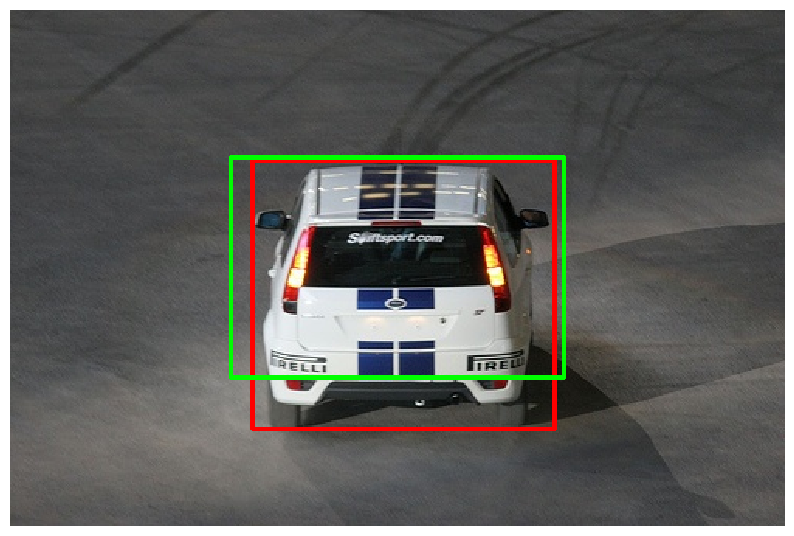

5 activated anchors!


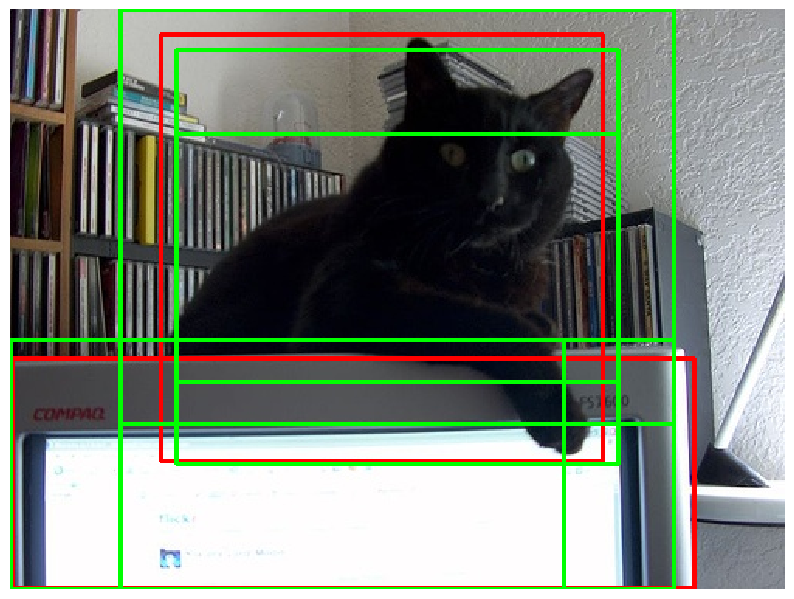

2 activated anchors!


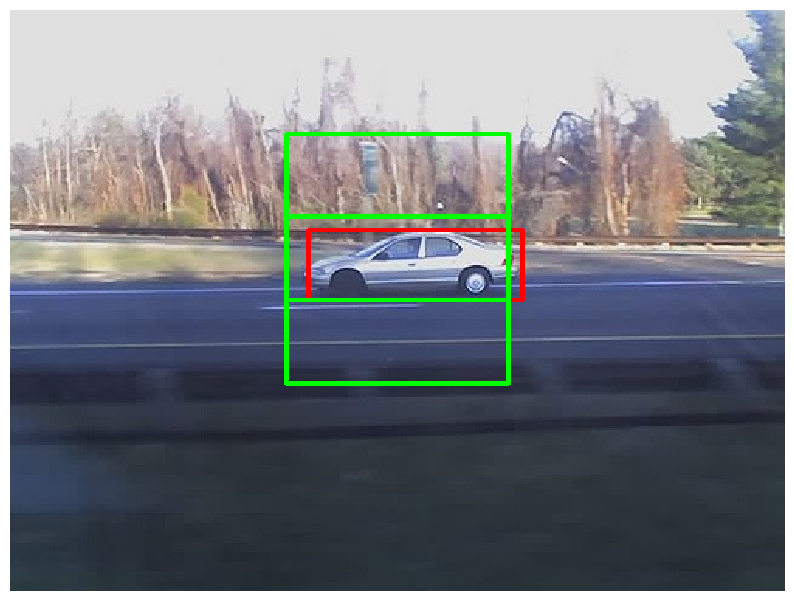

********************************************************************************
Negative anchors:
3 negative anchors!


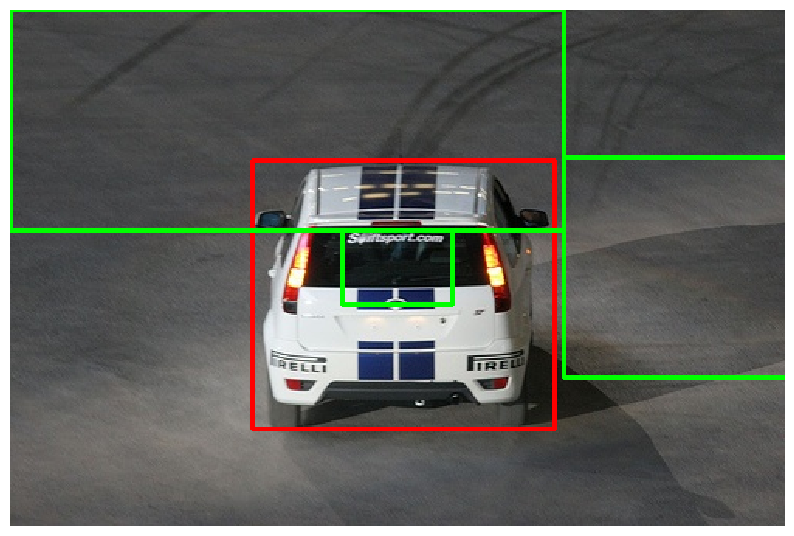

2 negative anchors!


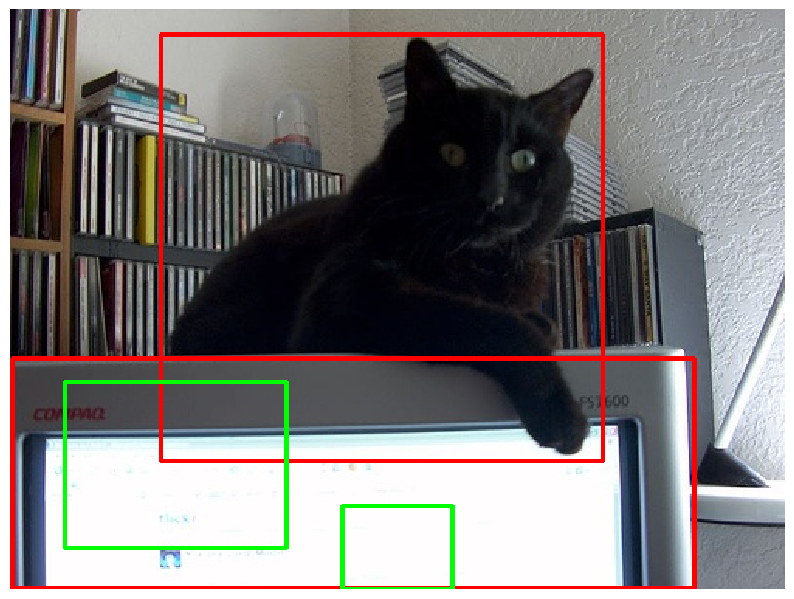

3 negative anchors!


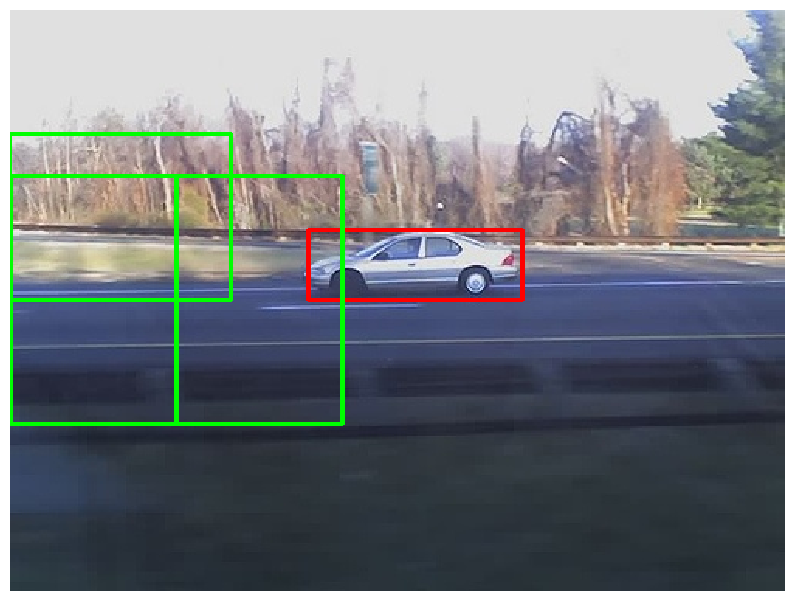

In [ ]:
# visualize the activated anchors
anc_per_img = torch.prod(torch.tensor(anc_list.shape[1:-1]))

print('*'*80)
print('Activated (positive) anchors:')
for img, bbox, idx in zip(img_list, box_list, torch.arange(box_list.shape[0])):
  anc_ind_in_img = (activated_anc_ind >= idx * anc_per_img) & (activated_anc_ind < (idx+1) * anc_per_img)
  print('{} activated anchors!'.format(torch.sum(anc_ind_in_img)))
  data_visualizer(img, idx_to_class, bbox[:, :4], coord_trans(activated_anc_coord[anc_ind_in_img], w_list[idx], h_list[idx]))

print('*'*80)
print('Negative anchors:')
for img, bbox, idx in zip(img_list, box_list, torch.arange(box_list.shape[0])):
  anc_ind_in_img = (negative_anc_ind >= idx * anc_per_img) & (negative_anc_ind < (idx+1) * anc_per_img)
  print('{} negative anchors!'.format(torch.sum(anc_ind_in_img)))
  data_visualizer(img, idx_to_class, bbox[:, :4], coord_trans(negative_anc_coord[anc_ind_in_img], w_list[idx], h_list[idx]))

### Proposal module
RPN은 object proposal score와 bounding box offset을 예측하기만 하면 됩니다. 이는 class-agnostic합니다.

![pred_scores2](https://miro.medium.com/max/918/1*wB3ctS9WGNmw6pP_kjLjgg.png)

여기서 $k$는 $A$와 같다고 생각하면 됩니다.

Image credit: Ren et al, "Faster R-CNN: Towards Real-Time Object Detection with Region Proposal Networks", NeurIPS 2015, https://arxiv.org/abs/1506.01497

In [ ]:
class ProposalModule(nn.Module):
  def __init__(self, in_dim, hidden_dim=256, num_anchors=9, drop_ratio=0.3):
    super().__init__()

    assert(num_anchors != 0)
    self.num_anchors = num_anchors
    ##############################################################################
    # TODO: Define the region proposal layer - a sequential module with a 3x3    #
    # conv layer, followed by a Dropout (p=drop_ratio), a Leaky ReLU and         #
    # a 1x1 conv.                                                                #
    # HINT: The output should be of shape Bx(Ax6)x7x7, where A=self.num_anchors. #
    #       Determine the padding of the 3x3 conv layer given the output dim.    #
    ##############################################################################
    # Replace "pass" statement with your code
    self.model = nn.Sequential(
            nn.Conv2d(in_dim, hidden_dim, kernel_size=3, padding=1),
            nn.Dropout(drop_ratio),
            nn.LeakyReLU(),
            nn.Conv2d(hidden_dim, int(num_anchors*6), 1)
        )
    ##############################################################################
    #                               END OF YOUR CODE                             #
    ##############################################################################

  def _extract_anchor_data(self, anchor_data, anchor_idx):
    """
    Inputs:
    - anchor_data: Tensor of shape (B, A, D, H, W) giving a vector of length
      D for each of A anchors at each point in an H x W grid.
    - anchor_idx: int64 Tensor of shape (M,) giving anchor indices to extract

    Returns:
    - extracted_anchors: Tensor of shape (M, D) giving anchor data for each
      of the anchors specified by anchor_idx.
    """
    B, A, D, H, W = anchor_data.shape
    anchor_data = anchor_data.permute(0, 1, 3, 4, 2).contiguous().view(-1, D)
    extracted_anchors = anchor_data[anchor_idx]
    return extracted_anchors

  def forward(self, features, pos_anchor_coord=None, \
              pos_anchor_idx=None, neg_anchor_idx=None):
    """
    Run the forward pass of the proposal module.

    Inputs:
    - features: Tensor of shape (B, in_dim, H', W') giving features from the
      backbone network.
    - pos_anchor_coord: Tensor of shape (M, 4) giving the coordinates of
      positive anchors. Anchors are specified as (x_tl, y_tl, x_br, y_br) with
      the coordinates of the top-left corner (x_tl, y_tl) and bottom-right
      corner (x_br, y_br). During inference this is None.
    - pos_anchor_idx: int64 Tensor of shape (M,) giving the indices of positive
      anchors. During inference this is None.
    - neg_anchor_idx: int64 Tensor of shape (M,) giving the indicdes of negative
      anchors. During inference this is None.

    The outputs from this module are different during training and inference.

    During training, pos_anchor_coord, pos_anchor_idx, and neg_anchor_idx are
    all provided, and we only output predictions for the positive and negative
    anchors. During inference, these are all None and we must output predictions
    for all anchors.

    Outputs (during training):
    - conf_scores: Tensor of shape (2M, 2) giving the classification scores
      (object vs background) for each of the M positive and M negative anchors.
    - offsets: Tensor of shape (M, 4) giving predicted transforms for the
      M positive anchors.
    - proposals: Tensor of shape (M, 4) giving predicted region proposals for
      the M positive anchors.

    Outputs (during inference):
    - conf_scores: Tensor of shape (B, A, 2, H', W') giving the predicted
      classification scores (object vs background) for all anchors
    - offsets: Tensor of shape (B, A, 4, H', W') giving the predicted transforms
      for all anchors
    """
    if pos_anchor_coord is None or pos_anchor_idx is None or neg_anchor_idx is None:
      mode = 'eval'
    else:
      mode = 'train'
    conf_scores, offsets, proposals = None, None, None
    ############################################################################
    # TODO: Predict classification scores (object vs background) and transforms#
    # for all anchors. During inference, simply output predictions for all     #
    # anchors. During training, extract the predictions for only the positive  #
    # and negative anchors as described above, and also apply the transforms to#
    # the positive anchors to compute the coordinates of the region proposals. #
    #                                                                          #
    # HINT: You can extract information about specific proposals using the     #
    # provided helper function self._extract_anchor_data.                      #
    # HINT: You can compute proposal coordinates using the GenerateProposal    #
    # function from the previous notebook.                                     #
    ############################################################################
    # Replace "pass" statement with your code

    if mode == 'eval':
      out  = self.model(features)
      B, A, H, W = out.shape
      out = out.reshape(B, self.num_anchors, -1, H, W)
      conf_scores = out[:,:,:2]
      offsets =  out[:,:,2:]
    else:
      out  = self.model(features)
      B, A, H, W = out.shape
      pos_anchors = self._extract_anchor_data(out.reshape(B, self.num_anchors, -1, H, W), pos_anchor_idx)
      neg_anchors = self._extract_anchor_data(out.reshape(B, self.num_anchors, -1, H, W), neg_anchor_idx)
      conf_scores = conf_scores = torch.cat((pos_anchors[:,:2], neg_anchors[:,:2]), 0)
      offsets = pos_anchors[:,2:]
      proposals = GenerateProposal(pos_anchors[:,2:].reshape(pos_anchor_coord.shape[0], 1, 1, 1, 4),offsets.reshape(pos_anchor_coord.shape[0], 1, 1, 1, 4))
      proposals = proposals.reshape(-1, 4)

    ##############################################################################
    #                               END OF YOUR CODE                             #
    ##############################################################################
    if mode == 'train':
      return conf_scores, offsets, proposals
    elif mode == 'eval':
      return conf_scores, offsets

Run the following to check your implementation. You should see errors on the order of 1e-5 or less.

In [ ]:
# sanity check
fix_random_seed(0)
prop_module = ProposalModule(1280, drop_ratio=0).to(**to_float_cuda)
features = torch.linspace(-10., 10., steps=3*1280*7*7, **to_float_cuda).view(3, 1280, 7, 7)
conf_scores, offsets, proposals = prop_module(features, activated_anc_coord, \
              pos_anchor_idx=activated_anc_ind, neg_anchor_idx=negative_anc_ind)

expected_conf_scores = torch.tensor([[-0.50843990,  2.62025023],
                                     [-0.55775326, -0.29983672],
                                     [-0.55796617, -0.30000290],
                                     [ 0.17819080, -0.42211828],
                                     [-0.51439995, -0.47708601],
                                     [-0.51439744, -0.47703803],
                                     [ 0.63225138,  2.71269488],
                                     [ 0.63224381,  2.71290708]], **to_float_cuda)
expected_offsets = torch.tensor([[ 1.62754285,  1.35253453, -1.85451591, -1.77882397],
                                 [-0.33651856, -0.14402901, -0.07458937, -0.27201492],
                                 [-0.33671042, -0.14398587, -0.07479107, -0.27199429],
                                 [ 0.06847382,  0.21062726,  0.09334904, -0.02446130],
                                 [ 0.16506940, -0.30296192,  0.29626080,  0.32173073],
                                 [ 0.16507357, -0.30302414,  0.29625297,  0.32169008],
                                 [ 1.59992146, -0.75236654,  1.66449440,  2.05138564],
                                 [ 1.60008609, -0.75249159,  1.66474164,  2.05162382]], **to_float_cuda)

print('conf scores error: ', rel_error(conf_scores[:8], expected_conf_scores))
print('offsets error: ', rel_error(offsets, expected_offsets))

conf scores error:  5.040909854869824e-06
offsets error:  1.558252188260667e-05


### Loss Function

confidence score regression loss는 activated/negative anchor 둘 다에 대해서 계산하지만, bounding box regression loss는 activated anchor에 대해서만 계산합니다.

#### Confidence score regression


In [ ]:
def ConfScoreRegression(conf_scores, batch_size):
  """
  Binary cross-entropy loss

  Inputs:
  - conf_scores: Predicted confidence scores, of shape (2M, 2). Assume that the
    first M are positive samples, and the last M are negative samples.

  Outputs:
  - conf_score_loss: Torch scalar
  """
  # the target conf_scores for positive samples are ones and negative are zeros
  M = conf_scores.shape[0] // 2
  GT_conf_scores = torch.zeros_like(conf_scores)
  GT_conf_scores[:M, 0] = 1.
  GT_conf_scores[M:, 1] = 1.

  conf_score_loss = F.binary_cross_entropy_with_logits(conf_scores, GT_conf_scores, \
                                     reduction='sum') * 1. / batch_size
  return conf_score_loss

#### Bounding box regression

In [ ]:
def BboxRegression(offsets, GT_offsets, batch_size):
  """"
  Use SmoothL1 loss as in Faster R-CNN

  Inputs:
  - offsets: Predicted box offsets, of shape (M, 4)
  - GT_offsets: GT box offsets, of shape (M, 4)

  Outputs:
  - bbox_reg_loss: Torch scalar
  """
  bbox_reg_loss = F.smooth_l1_loss(offsets, GT_offsets, reduction='sum') * 1. / batch_size
  return bbox_reg_loss

Run the following to check your implementation. You should see errors on the order of 1e-7 or less.

In [ ]:
conf_loss = ConfScoreRegression(conf_scores, features.shape[0])
reg_loss = BboxRegression(offsets, GT_offsets, features.shape[0])
print('conf loss: {:.4f}, reg loss: {:.4f}'.format(conf_loss, reg_loss))

loss_all = torch.tensor([conf_loss.data, reg_loss.data], **to_float_cuda)
expected_loss = torch.tensor([8.55673981, 5.10593748], **to_float_cuda)

print('loss error: ', rel_error(loss_all, expected_loss))

conf loss: 8.5567, reg loss: 5.1059
loss error:  1.1145299794179664e-07


### RPN module
Region Proposal Network을 구현해봅시다.

In [ ]:
class RPN(nn.Module):
  def __init__(self):
    super().__init__()

    # READ ONLY
    self.anchor_list = torch.tensor([[1, 1], [2, 2], [3, 3], [4, 4], [5, 5], [2, 3], [3, 2], [3, 5], [5, 3]])
    self.feat_extractor = FeatureExtractor()
    self.prop_module = ProposalModule(1280, num_anchors=self.anchor_list.shape[0])

  def forward(self, images, bboxes, output_mode='loss'):
    """
    Training-time forward pass for the Region Proposal Network.

    Inputs:
    - images: Tensor of shape (B, 3, 224, 224) giving input images
    - bboxes: Tensor of ground-truth bounding boxes, returned from the DataLoader
    - output_mode: One of 'loss' or 'all' that determines what is returned:
      If output_mode is 'loss' then the output is:
      - total_loss: Torch scalar giving the total RPN loss for the minibatch
      If output_mode is 'all' then the output is:
      - total_loss: Torch scalar giving the total RPN loss for the minibatch
      - pos_conf_scores: Tensor of shape (M, 1) giving the object classification
        scores (object vs background) for the positive anchors
      - proposals: Tensor of shape (M, 4) giving the coordiantes of the region
        proposals for the positive anchors
      - features: Tensor of features computed from the backbone network
      - GT_class: Tensor of shape (M,) giving the ground-truth category label
        for the positive anchors.
      - pos_anchor_idx: Tensor of shape (M,) giving indices of positive anchors
      - neg_anchor_idx: Tensor of shape (M,) giving indices of negative anchors
      - anc_per_image: Torch scalar giving the number of anchors per image.

    Outputs: See output_mode

    HINT: The function ReferenceOnActivatedAnchors from the previous notebook
    can compute many of these outputs -- you should study it in detail:
    - pos_anchor_idx (also called activated_anc_ind)
    - neg_anchor_idx (also called negative_anc_ind)
    - GT_class
    """
    # weights to multiply to each loss term
    w_conf = 1 # for conf_scores
    w_reg = 5 # for offsets

    assert output_mode in ('loss', 'all'), 'invalid output mode!'
    total_loss = None
    conf_scores, proposals, features, GT_class, pos_anchor_idx, anc_per_img = \
      None, None, None, None, None, None
    ##############################################################################
    # TODO: Implement the forward pass of RPN.                                   #
    # A few key steps are outlined as follows:                                   #
    # i) Image feature extraction,                                               #
    # ii) Grid and anchor generation,                                            #
    # iii) Compute IoU between anchors and GT boxes and then determine activated/#
    #      negative anchors, and GT_conf_scores, GT_offsets, GT_class,           #
    # iv) Compute conf_scores, offsets, proposals through the region proposal    #
    #     module                                                                 #
    # v) Compute the total_loss for RPN which is formulated as:                  #
    #    total_loss = w_conf * conf_loss + w_reg * reg_loss,                     #
    #    where conf_loss is determined by ConfScoreRegression, w_reg by          #
    #    BboxRegression. Note that RPN does not predict any class info.          #
    #    We have written this part for you which you've already practiced earlier#
    # HINT: Do not apply thresholding nor NMS on the proposals during training   #
    #       as positive/negative anchors have been explicitly targeted.          #
    ##############################################################################
    # Replace "pass" statement with your code

    batch_size = images.shape[0]
    features = self.feat_extractor(images)

    grid = GenerateGrid(batch_size)
    anchors = GenerateAnchor(self.anchor_list, grid)

    _, A, H, W, _ = anchors.shape
    anc_per_img = A * H * W

    iou_mat = IoU(anchors, bboxes)
    pos_anchor_idx, neg_anchor_idx, _, GT_offsets, GT_class, activated_anc_coord, _ = \
        ReferenceOnActivatedAnchors(anchors, bboxes, grid, iou_mat, method='FasterRCNN')

    conf_scores, offsets, proposals = self.prop_module(features, activated_anc_coord,
                                                        pos_anchor_idx, neg_anchor_idx)

    conf_loss = ConfScoreRegression(conf_scores, batch_size)
    reg_loss = BboxRegression(offsets, GT_offsets, batch_size)

    total_loss = w_conf * conf_loss + w_reg * reg_loss

    ##############################################################################
    #                               END OF YOUR CODE                             #
    ##############################################################################

    if output_mode == 'loss':
      return total_loss
    else:
      return total_loss, conf_scores, proposals, features, GT_class, pos_anchor_idx, neg_anchor_idx, anc_per_img


  def inference(self, images, thresh=0.5, nms_thresh=0.7, mode='RPN'):
    """
    Inference-time forward pass for the Region Proposal Network.

    Inputs:
    - images: Tensor of shape (B, 3, H, W) giving input images
    - thresh: Threshold value on confidence scores. Proposals with a predicted
      object probability above thresh should be kept. HINT: You can convert the
      object score to an object probability using a sigmoid nonlinearity.
    - nms_thresh: IoU threshold for non-maximum suppression
    - mode: One of 'RPN' or 'FasterRCNN' to determine the outputs.

    The region proposal network can output a variable number of region proposals
    per input image. We assume that the input image images[i] gives rise to
    P_i final propsals after thresholding and NMS.

    NOTE: NMS is performed independently per-image!

    Outputs:
    - final_proposals: List of length B, where final_proposals[i] is a Tensor
      of shape (P_i, 4) giving the coordinates of the predicted region proposals
      for the input image images[i].
    - final_conf_probs: List of length B, where final_conf_probs[i] is a
      Tensor of shape (P_i,) giving the predicted object probabilities for each
      predicted region proposal for images[i]. Note that these are
      *probabilities*, not scores, so they should be between 0 and 1.
    - features: Tensor of shape (B, D, H', W') giving the image features
      predicted by the backbone network for each element of images.
      If mode is "RPN" then this is a dummy list of zeros instead.
    """
    assert mode in ('RPN', 'FasterRCNN'), 'invalid inference mode!'

    features, final_conf_probs, final_proposals = None, None, None
    ##############################################################################
    # TODO: Predicting the RPN proposal coordinates `final_proposals` and        #
    # confidence scores `final_conf_probs`.                                     #
    # The overall steps are similar to the forward pass but now you do not need  #
    # to decide the activated nor negative anchors.                              #
    # HINT: Threshold the conf_scores based on the threshold value `thresh`.     #
    # Then, apply NMS to the filtered proposals given the threshold `nms_thresh`.#
    ##############################################################################
    # Replace "pass" statement with your code

    batch_size = images.shape[0]

    with torch.no_grad():
      features = self.feat_extractor(images)

      grid = GenerateGrid(batch_size)
      anchors = GenerateAnchor(self.anchor_list, grid)

      B, A, Hp, Wp, _ = anchors.shape

      conf_scores, offsets = self.prop_module(features)

    conf_scores = torch.transpose(conf_scores, 2, 4)
    conf_scores = torch.flatten(conf_scores, start_dim=1, end_dim=-2)
    conf_probs = torch.sigmoid(conf_scores)
    conf_probs = conf_probs[..., 0]

    offsets = torch.transpose(offsets, 2, 4)

    proposals = GenerateProposal(anchors, offsets, method='FasterRCNN')
    proposals = torch.flatten(proposals, start_dim=1, end_dim=-2)

    final_conf_probs, final_proposals = [], []

    for idx in range(batch_size):
      cr_proposal = proposals[idx]
      cr_conf_probs = conf_probs[idx]

      del_idx_mask = ~ (cr_conf_probs < thresh)

      cr_conf_probs = cr_conf_probs[del_idx_mask]
      K = cr_conf_probs.shape[0]

      del_idx_mask = del_idx_mask.unsqueeze(1)
      del_idx_mask = torch.broadcast_to(del_idx_mask, (A*Hp*Wp, 4))

      cr_proposal = cr_proposal[del_idx_mask].reshape(K, 4)

      icr_proposal = torchvision.ops.nms(cr_proposal, cr_conf_probs, nms_thresh)

      final_conf_probs.append(cr_conf_probs[icr_proposal].unsqueeze(1))
      final_proposals.append(cr_proposal[icr_proposal])


    ##############################################################################
    #                               END OF YOUR CODE                             #
    ##############################################################################
    if mode == 'RPN':
      features = [torch.zeros_like(i) for i in final_conf_probs] # dummy class
    return final_proposals, final_conf_probs, features

### RPN solver
Faster R-CNN에서는 RPN은 second-stage network와 jointly train하지만, 여기서는 RPN 구현을 test 해보기 위해 우리는 먼저 RPN만 학습시켜봅시다. 이는 기본적으로 class-agnostic single-stage detector입니다.

In [ ]:
def DetectionSolver(detector, train_loader, learning_rate=3e-3,
                    lr_decay=1, num_epochs=20, **kwargs):
  """
  Run optimization to train the model.
  """

  # ship model to GPU
  detector.to(**to_float_cuda)

  # optimizer setup
  from torch import optim
  # optimizer = optim.Adam(
  optimizer = optim.SGD(
    filter(lambda p: p.requires_grad, detector.parameters()),
    learning_rate) # leave betas and eps by default
  lr_scheduler = optim.lr_scheduler.LambdaLR(optimizer,
                                             lambda epoch: lr_decay ** epoch)

  # sample minibatch data
  loss_history = []
  detector.train()
  for i in range(num_epochs):
    start_t = time.time()
    for iter_num, data_batch in enumerate(train_loader):
      images, boxes, w_batch, h_batch, _ = data_batch
      resized_boxes = coord_trans(boxes, w_batch, h_batch, mode='p2a')
      images = images.to(**to_float_cuda)
      resized_boxes = resized_boxes.to(**to_float_cuda)

      loss = detector(images, resized_boxes)
      optimizer.zero_grad()
      loss.backward()
      loss_history.append(loss.item())
      optimizer.step()

      print('(Iter {} / {})'.format(iter_num, len(train_loader)))

    end_t = time.time()
    print('(Epoch {} / {}) loss: {:.4f} time per epoch: {:.1f}s'.format(
        i, num_epochs, loss.item(), end_t-start_t))

    lr_scheduler.step()

  # plot the training losses
  plt.plot(loss_history)
  plt.xlabel('Iteration')
  plt.ylabel('Loss')
  plt.title('Training loss history')
  plt.show()

In [ ]:
RPNSolver = DetectionSolver # the same solver as in YOLO

### RPN - Overfit small data
RPN을 먼저 small subset에 overfit시켜 봅시다. 훈련 이후 우리는 3.0 근방 혹은 그보다 낮은 loss 값을 얻어야 합니다.

lr:  0.001
number of pos proposals:  50
(Iter 0 / 1)
(Epoch 0 / 200) loss: 27.9920 time per epoch: 1.2s
number of pos proposals:  50
(Iter 0 / 1)
(Epoch 1 / 200) loss: 52.4602 time per epoch: 1.4s
number of pos proposals:  50
(Iter 0 / 1)
(Epoch 2 / 200) loss: 29.8269 time per epoch: 1.6s
number of pos proposals:  50
(Iter 0 / 1)
(Epoch 3 / 200) loss: 20.6756 time per epoch: 1.2s
number of pos proposals:  50
(Iter 0 / 1)
(Epoch 4 / 200) loss: 19.2275 time per epoch: 1.2s
number of pos proposals:  50
(Iter 0 / 1)
(Epoch 5 / 200) loss: 18.3222 time per epoch: 1.2s
number of pos proposals:  50
(Iter 0 / 1)
(Epoch 6 / 200) loss: 17.3032 time per epoch: 1.2s
number of pos proposals:  50
(Iter 0 / 1)
(Epoch 7 / 200) loss: 16.7005 time per epoch: 1.2s
number of pos proposals:  50
(Iter 0 / 1)
(Epoch 8 / 200) loss: 15.8393 time per epoch: 1.2s
number of pos proposals:  50
(Iter 0 / 1)
(Epoch 9 / 200) loss: 15.2684 time per epoch: 1.2s
number of pos proposals:  50
(Iter 0 / 1)
(Epoch 10 / 200) 

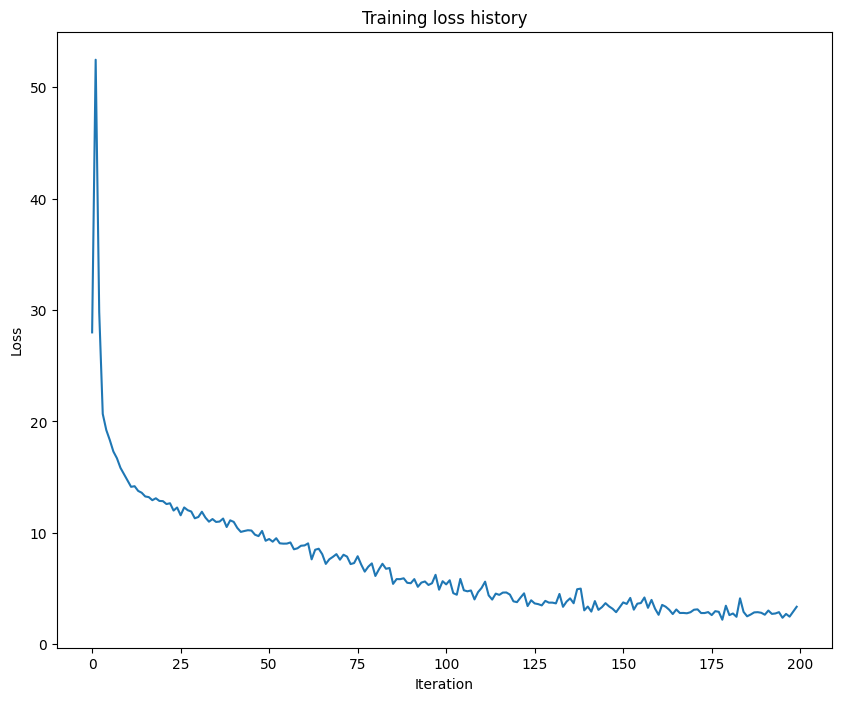

In [ ]:
# monitor the training loss
num_sample = 10
small_dataset = torch.utils.data.Subset(train_dataset, torch.linspace(0, len(train_dataset)-1, steps=num_sample).long())
small_train_loader = pascal_voc2007_loader(small_dataset, 64) # a new loader

for lr in [1e-3]:
  print('lr: ', lr)
  rpn = RPN()
  RPNSolver(rpn, small_train_loader, learning_rate=lr, num_epochs=200)

### Non-Maximum Suppression (NMS)
Non-Max Suppression도 다들 기억하시죠? 직접 구현해봅시다. 기억 안 나시는 분들은 다음 자료를 참고해주세요.

In [ ]:
def nms(boxes, scores, iou_threshold=0.5, topk=None):
  """
  Non-maximum suppression removes overlapping bounding boxes.

  Inputs:
  - boxes: top-left and bottom-right coordinate values of the bounding boxes
    to perform NMS on, of shape Nx4
  - scores: scores for each one of the boxes, of shape N
  - iou_threshold: discards all overlapping boxes with IoU > iou_threshold; float
  - topk: If this is not None, then return only the topk highest-scoring boxes.
    Otherwise if this is None, then return all boxes that pass NMS.

  Outputs:
  - keep: torch.long tensor with the indices of the elements that have been
    kept by NMS, sorted in decreasing order of scores; of shape [num_kept_boxes]
  """

  if (not boxes.numel()) or (not scores.numel()):
    return torch.zeros(0, dtype=torch.long)

  keep = None
  #############################################################################
  # TODO: Implement non-maximum suppression which iterates the following:     #
  #       1. Select the highest-scoring box among the remaining ones,         #
  #          which has not been chosen in this step before                    #
  #       2. Eliminate boxes with IoU > threshold                             #
  #       3. If any boxes remain, GOTO 1                                      #
  #       Your implementation should not depend on a specific device type;    #
  #       you can use the device of the input if necessary.                   #
  # HINT: You can refer to the torchvision library code:                      #
  #   github.com/pytorch/vision/blob/master/torchvision/csrc/cpu/nms_cpu.cpp  #
  #############################################################################
  # Replace "pass" statement with your code

  keep = []

  indices = torch.argsort(scores, descending=True)
  boxes = boxes[indices]

  while len(boxes) != 0:
      keep.append(indices[0])
      hbox = boxes[0]

      boxes = boxes[1:]
      indices = indices[1:]

      hbox = hbox.reshape(1, 1, 4)
      rboxes = boxes.reshape(1, -1, 1, 1, 4)
      iou_mat = IoU(rboxes, hbox).squeeze()

      del_idx_mask = ~ (iou_mat > iou_threshold)
      indices = indices[del_idx_mask]
      boxes = boxes[del_idx_mask]

  if topk is not None:
        keep = keep[:topk]

  keep = torch.tensor(keep, dtype=torch.long)


  #############################################################################
  #                              END OF YOUR CODE                             #
  #############################################################################
  return keep

아래 코드를 통해 여러분이 직접 구현한 NMS와 torchvision 상에 구현된 NMS를 비교할 수 있습니다.

In [ ]:
fix_random_seed(0)
boxes = (100. * torch.rand(100, 4)).round()
boxes[:,2] = boxes[:,2] + boxes[:,0] + 1.
boxes[:,3] = boxes[:,3] + boxes[:,1] + 1.
scores = torch.randn(100)

names = ['your_cpu', 'torchvision_cpu', 'torchvision_cuda']
iou_thresholds = [0.3, 0.5, 0.7]
elapsed = dict(zip(names, [0.]*len(names)))
intersects = dict(zip(names[1:], [0.]*(len(names)-1)))

for iou_threshold in iou_thresholds:
  tic = time.time()
  my_keep = nms(boxes, scores, iou_threshold)
  elapsed['your_cpu'] += time.time() - tic

  tic = time.time()
  tv_keep = torchvision.ops.nms(boxes, scores, iou_threshold)

  elapsed['torchvision_cpu'] += time.time() - tic
  intersect = len(set(tv_keep.tolist()).intersection(my_keep.tolist()))
  intersects['torchvision_cpu'] += intersect / (len(my_keep) + len(tv_keep) - intersect)

  tic = time.time()
  tv_cuda_keep = torchvision.ops.nms(boxes.cuda(), scores.cuda(), iou_threshold).to(my_keep.device)
  torch.cuda.synchronize()
  elapsed['torchvision_cuda'] += time.time() - tic
  intersect = len(set(tv_cuda_keep.tolist()).intersection(my_keep.tolist()))
  intersects['torchvision_cuda'] += intersect / (len(my_keep) + len(tv_cuda_keep) - intersect)

for key in intersects:
  intersects[key] /= len(iou_thresholds)

# You should see < 1% difference
print('Testing NMS:')
print('Your        CPU  implementation: %fs' % elapsed['your_cpu'])
print('torchvision CPU  implementation: %fs' % elapsed['torchvision_cpu'])
print('torchvision CUDA implementation: %fs' % elapsed['torchvision_cuda'])
print('Speedup CPU : %fx' % (elapsed['your_cpu'] / elapsed['torchvision_cpu']))
print('Speedup CUDA: %fx' % (elapsed['your_cpu'] / elapsed['torchvision_cuda']))
print('Difference CPU : ', 1. - intersects['torchvision_cpu']) # in the order of 1e-3 or less
print('Difference CUDA: ', 1. - intersects['torchvision_cuda']) # in the order of 1e-3 or less

Testing NMS:
Your        CPU  implementation: 0.082548s
torchvision CPU  implementation: 0.000765s
torchvision CUDA implementation: 0.001476s
Speedup CPU : 107.927993x
Speedup CUDA: 55.916182x
Difference CPU :  0.0
Difference CUDA:  0.0


### RPN - Inference
`DetectionInference` function을 사용해 RPN 결과를 visualize해봅시다.

In [ ]:
def DetectionInference(detector, data_loader, dataset, idx_to_class, thresh=0.8, nms_thresh=0.3, output_dir=None):

  detector.to(**to_float_cuda)

  detector.eval()
  start_t = time.time()

  if output_dir is not None:
    det_dir = 'mAP/input/detection-results'
    gt_dir = 'mAP/input/ground-truth'
    if os.path.exists(det_dir):
      shutil.rmtree(det_dir)
    os.mkdir(det_dir)
    if os.path.exists(gt_dir):
      shutil.rmtree(gt_dir)
    os.mkdir(gt_dir)

  for iter_num, data_batch in enumerate(data_loader):
    images, boxes, w_batch, h_batch, img_ids = data_batch
    images = images.to(**to_float_cuda)

    final_proposals, final_conf_scores, final_class = detector.inference(images, thresh=thresh, nms_thresh=nms_thresh)

    # clamp on the proposal coordinates
    batch_size = len(images)
    for idx in range(batch_size):
      torch.clamp_(final_proposals[idx][:, 0::2], min=0, max=w_batch[idx])
      torch.clamp_(final_proposals[idx][:, 1::2], min=0, max=h_batch[idx])

      # visualization
      # get the original image
      # hack to get the original image so we don't have to load from local again...
      i = batch_size*iter_num + idx
      img, _ = dataset.__getitem__(i)

      valid_box = sum([1 if j != -1 else 0 for j in boxes[idx][:, 0]])
      final_all = torch.cat((final_proposals[idx], \
        final_class[idx].float(), final_conf_scores[idx]), dim=-1).cpu()
      with torch.no_grad():
        resized_proposals = coord_trans(final_all, w_batch[idx], h_batch[idx])

      # write results to file for evaluation (use mAP API https://github.com/Cartucho/mAP for now...)
      if output_dir is not None:
        file_name = img_ids[idx].replace('.jpg', '.txt')
        with open(os.path.join(det_dir, file_name), 'w') as f_det, \
          open(os.path.join(gt_dir, file_name), 'w') as f_gt:
          print('{}: {} GT bboxes and {} proposals'.format(img_ids[idx], valid_box, resized_proposals.shape[0]))
          for b in boxes[idx][:valid_box]:
            f_gt.write('{} {:.2f} {:.2f} {:.2f} {:.2f}\n'.format(idx_to_class[b[4].item()], b[0], b[1], b[2], b[3]))
          for b in resized_proposals:
            f_det.write('{} {:.6f} {:.2f} {:.2f} {:.2f} {:.2f}\n'.format(idx_to_class[b[4].item()], b[5], b[0], b[1], b[2], b[3]))
      else:
        data_visualizer(img, idx_to_class, boxes[idx][:valid_box], resized_proposals)

  end_t = time.time()
  print('Total inference time: {:.1f}s'.format(end_t-start_t))

In [ ]:
RPNInference = DetectionInference

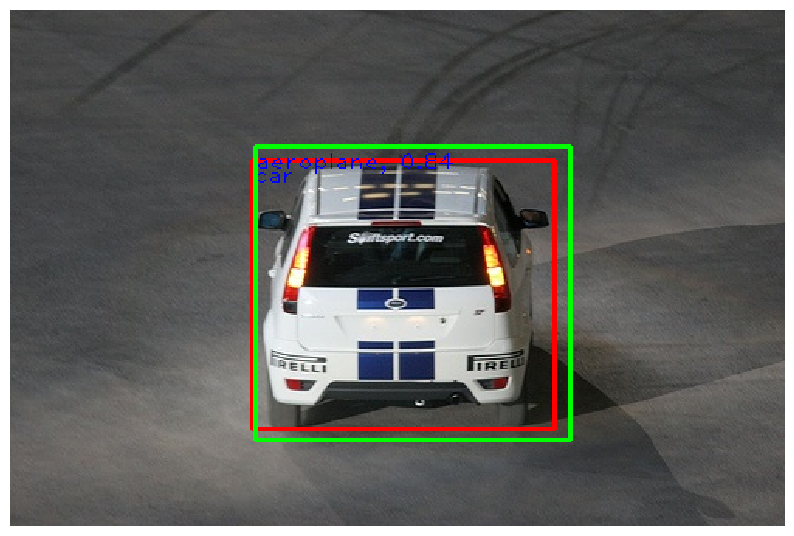

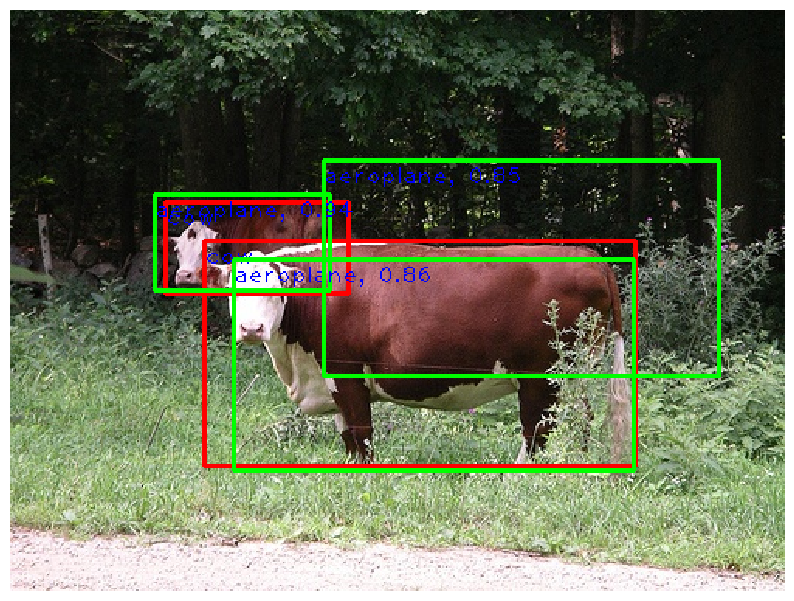

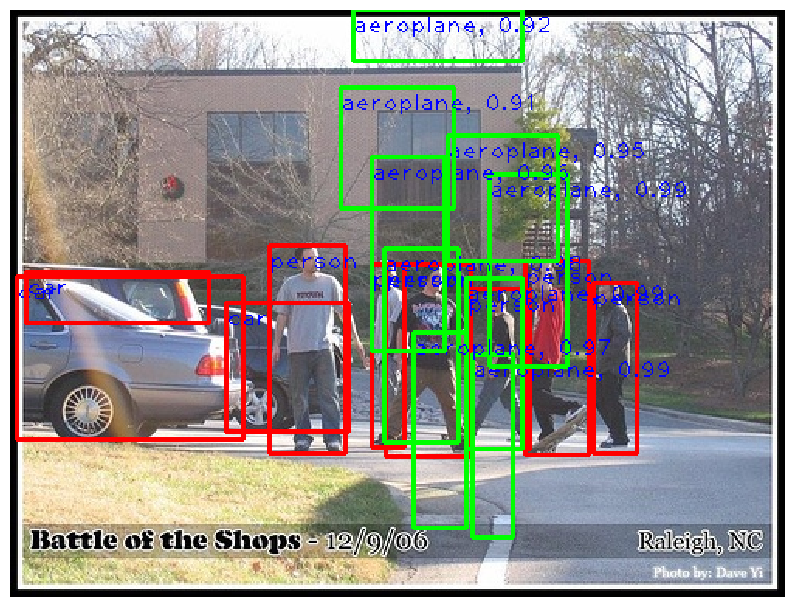

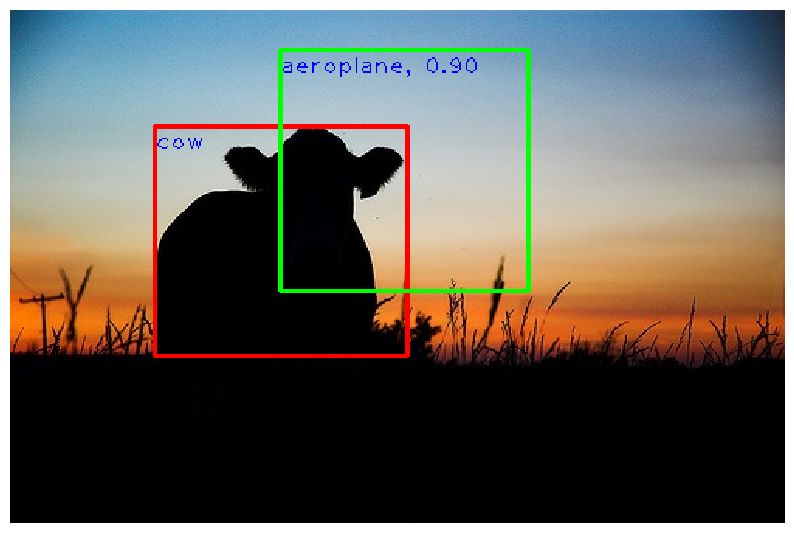

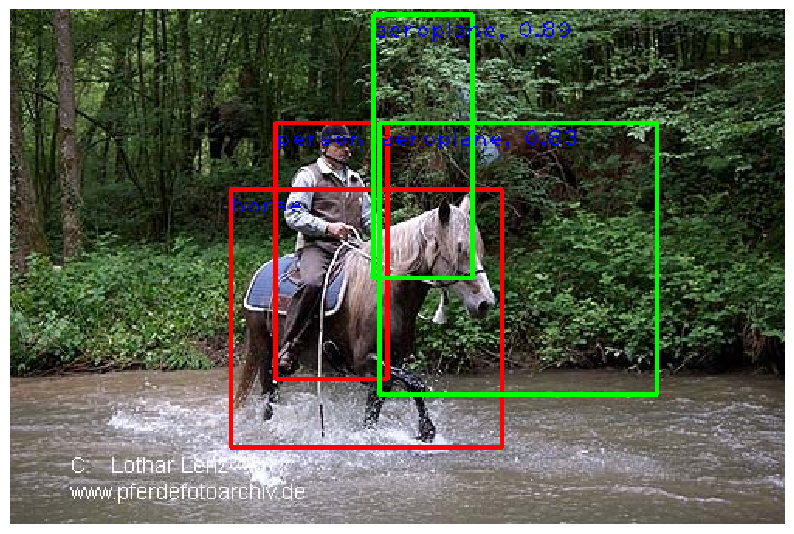

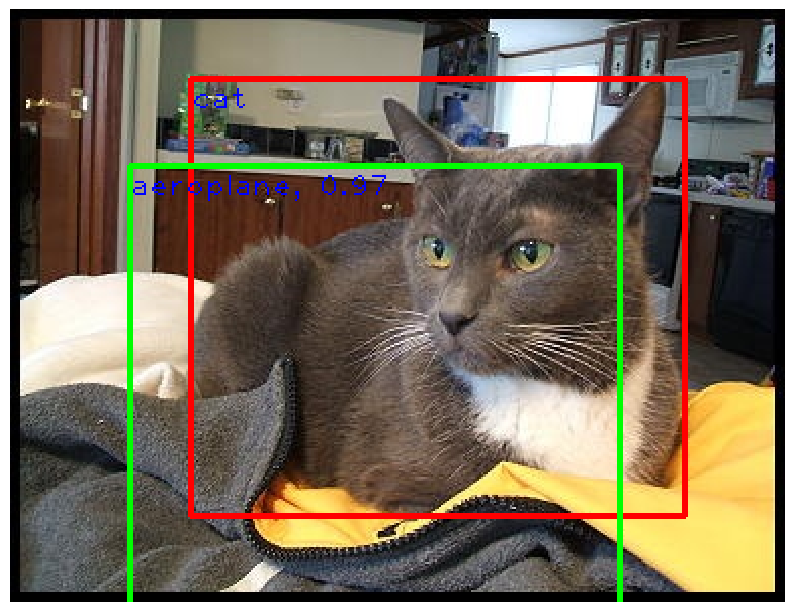

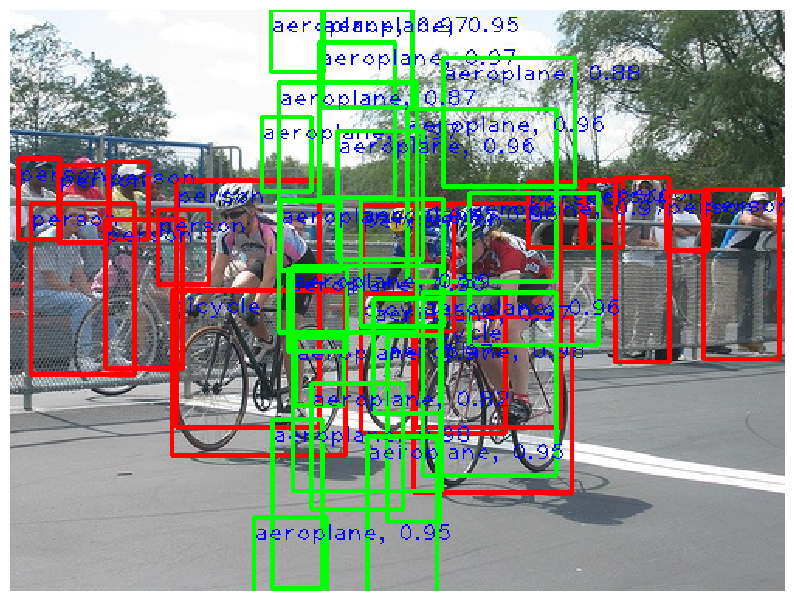

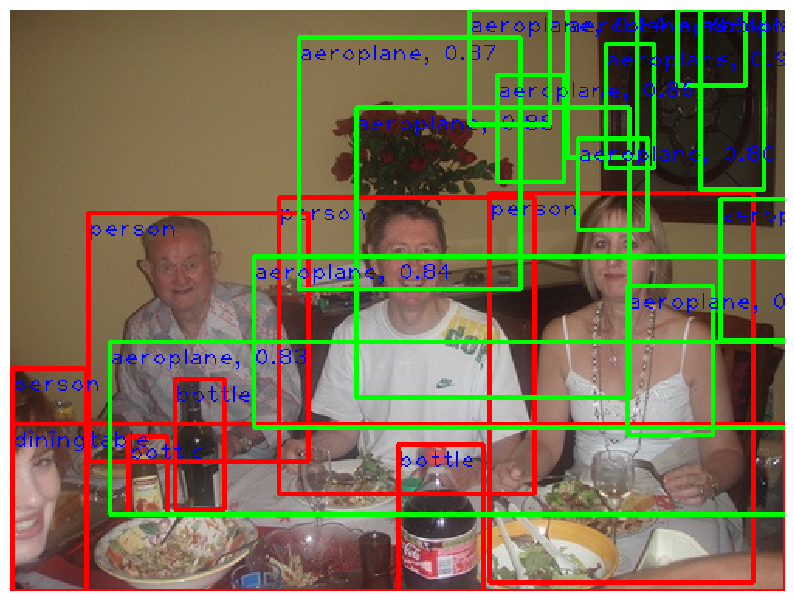

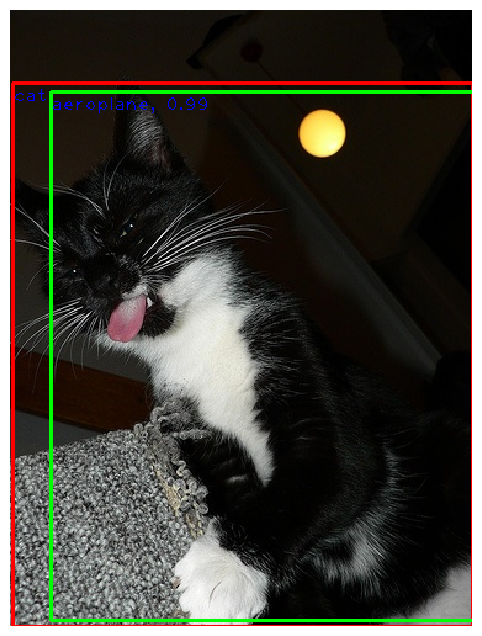

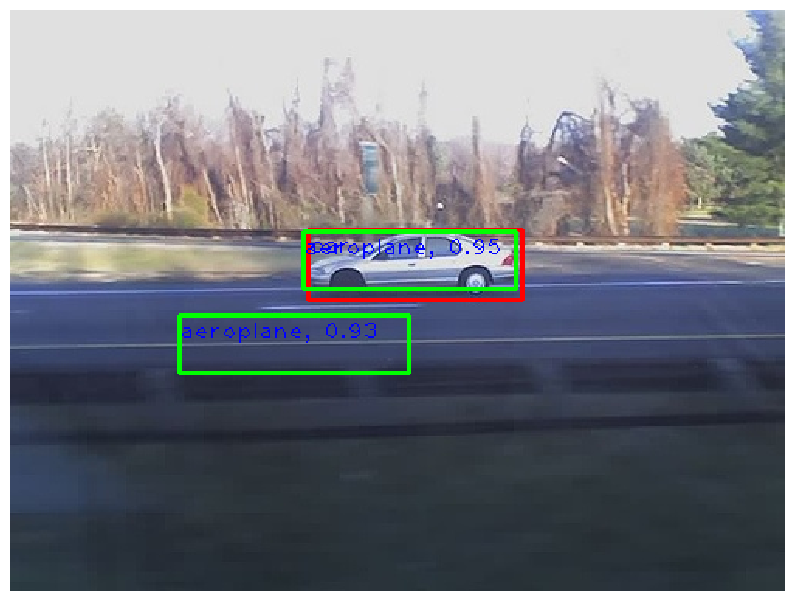

Total inference time: 3.4s


In [ ]:
# visualize the output from the overfitted model on small dataset
# the bounding boxes should be really accurate
# ignore the dummy object class (in blue) as RPN does not output class!
RPNInference(rpn, small_train_loader, small_dataset, idx_to_class, thresh=0.8, nms_thresh=0.3)

## Faster R-CNN
우리는 Faster R-CNN의 '절반'을 현재까지 구현했다고 생각하시면 됩니다. 이제 나머지 절반을 구현해봅시다. 이 second half에 대한 설명은 다음과 같습니다. 아래 글을 직접 읽어보시고 구현에 들어가면 좋을 것 같습니다!

*Given the proposals or region of interests (RoI) from RPN, we warp each region from CNN activation map to a fixed size 2x2 by using [RoI Align](https://arxiv.org/pdf/1703.06870.pdf). Essentially, the RoI feature is determined by bilinear interpolation over the CNN activation map. We meanpool the RoI feature over the spatial dimension (2x2).*

*Finally, we classify the meanpooled RoI feature into class probabilities.*

아래 글은 실제 full Faster R-CNN와 우리가 구현하는 two-stage detector의 차이를 설명하는 글입니다.   


*For simplicity, our two-stage detector here differs from a full Faster R-CNN system in a few aspects.*

*1. In a full implementation, the second stage of the network would predict a second set of offsets to transform the region proposal into a final predicted object bounding box. However we omit this for simplicity.*

*2. In a full implementation, the second stage of the network should be able to reject negative boxes -- in other words, if we want to predict C different object categories then the final classification layer of the second stage would predict a distribution over C+1 categories, with an extra one for background. We omit this, as it requires extra bookeeping in the second stage about which proposals are positive / negative; so for simplicity our second stage will only predict a distribution over C categories, and we will assume that the RPN has filtered out all background regions.*

### RoI Align

RoIAlign 함수는 torchvision에 구현되어 있는 `roi_align` function을 사용하겠습니다. 자세한 내용은 다음 링크를 확인해보세요!

https://pytorch.org/docs/stable/torchvision/ops.html#torchvision.ops.roi_align

### Faster R-CNN

In [ ]:
class TwoStageDetector(nn.Module):
  def __init__(self, in_dim=1280, hidden_dim=256, num_classes=20, \
               roi_output_w=2, roi_output_h=2, drop_ratio=0.3):
    super().__init__()

    assert(num_classes != 0)
    self.num_classes = num_classes
    self.roi_output_w, self.roi_output_h = roi_output_w, roi_output_h
    ##############################################################################
    # TODO: Declare your RPN and the region classification layer (in Fast R-CNN).#
    # The region classification layer is a sequential module with a Linear layer,#
    # followed by a Dropout (p=drop_ratio), a ReLU nonlinearity and another      #
    # Linear layer that predicts classification scores for each proposal.        #
    # HINT: The dimension of the two Linear layers are in_dim -> hidden_dim and  #
    # hidden_dim -> num_classes.                                                 #
    ##############################################################################
    # Replace "pass" statement with your code
    self.rpn = RPN()

    self.model = nn.Sequential(
      nn.Linear(in_dim, hidden_dim),
      nn.Dropout(p=drop_ratio),
      nn.ReLU(),
      nn.Linear(hidden_dim, num_classes)
    )
    ##############################################################################
    #                               END OF YOUR CODE                             #
    ##############################################################################

  def forward(self, images, bboxes):
    """
    Training-time forward pass for our two-stage Faster R-CNN detector.

    Inputs:
    - images: Tensor of shape (B, 3, H, W) giving input images
    - bboxes: Tensor of shape (B, N, 5) giving ground-truth bounding boxes
      and category labels, from the dataloader.

    Outputs:
    - total_loss: Torch scalar giving the overall training loss.
    """
    total_loss = None
    ##############################################################################
    # TODO: Implement the forward pass of TwoStageDetector.                      #
    # A few key steps are outlined as follows:                                   #
    # i) RPN, including image feature extraction, grid/anchor/proposal           #
    #       generation, activated and negative anchors determination.            #
    # ii) Perform RoI Align on proposals and meanpool the feature in the spatial #
    #     dimension.                                                             #
    # iii) Pass the RoI feature through the region classification layer which    #
    #      gives the class probilities.                                          #
    # iv) Compute class_prob through the prediction network and compute the      #
    #     cross entropy loss (cls_loss) between the prediction class_prob and    #
    #      the reference GT_class. Hint: Use F.cross_entropy loss.               #
    # v) Compute the total_loss which is formulated as:                          #
    #    total_loss = rpn_loss + cls_loss.                                       #
    ##############################################################################
    # Replace "pass" statement with your code

    rpn_loss, _, proposals, features, GT_class, pos_anchor_idx, _, anc_per_img = self.rpn(images, bboxes, output_mode='all')

    im_idx = (pos_anchor_idx // anc_per_img).unsqueeze(1)
    proposals_ibatch = torch.cat((im_idx, proposals), dim=1)
    roi_features = torchvision.ops.roi_align(features, proposals_ibatch, output_size=(self.roi_output_w, self.roi_output_h))

    roi_features = torch.mean(roi_features, (2, 3))

    class_prob = self.model(roi_features)

    cls_loss = nn.functional.cross_entropy(class_prob, GT_class)

    total_loss = rpn_loss + cls_loss

    ##############################################################################
    #                               END OF YOUR CODE                             #
    ##############################################################################
    return total_loss

  def inference(self, images, thresh=0.5, nms_thresh=0.7):
    """"
    Inference-time forward pass for our two-stage Faster R-CNN detector

    Inputs:
    - images: Tensor of shape (B, 3, H, W) giving input images
    - thresh: Threshold value on NMS object probabilities
    - nms_thresh: IoU threshold for NMS in the RPN

    We can output a variable number of predicted boxes per input image.
    In particular we assume that the input images[i] gives rise to P_i final
    predicted boxes.

    Outputs:
    - final_proposals: List of length (B,) where final_proposals[i] is a Tensor
      of shape (P_i, 4) giving the coordinates of the final predicted boxes for
      the input images[i]
    - final_conf_probs: List of length (B,) where final_conf_probs[i] is a
      Tensor of shape (P_i,) giving the predicted probabilites that the boxes
      in final_proposals[i] are objects (vs background)
    - final_class: List of length (B,), where final_class[i] is an int64 Tensor
      of shape (P_i,) giving the predicted category labels for each box in
      final_proposals[i].
    """
    final_proposals, final_conf_probs, final_class = None, None, None
    ##############################################################################
    # TODO: Predicting the final proposal coordinates `final_proposals`,        #
    # confidence scores `final_conf_probs`, and the class index `final_class`.  #
    # The overall steps are similar to the forward pass but now you do not need #
    # to decide the activated nor negative anchors.                             #
    # HINT: Use the RPN inference function to perform thresholding and NMS, and #
    # to compute final_proposals and final_conf_probs. Use the predicted class  #
    # probabilities from the second-stage network to compute final_class.       #
    ##############################################################################
    # Replace "pass" statement with your code

    final_proposals, final_conf_probs, features = self.rpn.inference(images, thresh=thresh, nms_thresh=nms_thresh, mode='FasterRCNN')

    final_class = []

    for idx, cr_proposal in enumerate(final_proposals):
      cr_features = features[idx].unsqueeze(dim=0)

      roi_features = torchvision.ops.roi_align(cr_features, [cr_proposal], output_size=(self.roi_output_w, self.roi_output_h))
      roi_features = torch.mean(roi_features, (2, 3))

      with torch.no_grad():
        class_prob = self.model(roi_features)

      if class_prob.shape[0] == 0:
        cr_final_class = torch.tensor([], dtype=torch.int32, device='cuda')
      else:
        cr_final_class = torch.argmax(class_prob, dim=1, keepdim=True)

      final_class.append(cr_final_class)

    ##############################################################################
    #                               END OF YOUR CODE                             #
    ##############################################################################
    return final_proposals, final_conf_probs, final_class

### Overfit small data

Faster R-CNN을 먼저 small subset에 overfit시켜 봅시다. 훈련 이후 우리는 4.0 근방 혹은 그보다 낮은 loss 값을 얻어야 합니다.

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=MobileNet_V2_Weights.IMAGENET1K_V1`. You can also use `weights=MobileNet_V2_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


number of pos proposals:  50
(Iter 0 / 1)
(Epoch 0 / 200) loss: 35.7443 time per epoch: 1.6s
number of pos proposals:  50
(Iter 0 / 1)
(Epoch 1 / 200) loss: 64.2924 time per epoch: 1.6s
number of pos proposals:  50
(Iter 0 / 1)
(Epoch 2 / 200) loss: 25.8221 time per epoch: 1.2s
number of pos proposals:  50
(Iter 0 / 1)
(Epoch 3 / 200) loss: 22.3389 time per epoch: 1.2s
number of pos proposals:  50
(Iter 0 / 1)
(Epoch 4 / 200) loss: 21.0061 time per epoch: 1.2s
number of pos proposals:  50
(Iter 0 / 1)
(Epoch 5 / 200) loss: 19.8311 time per epoch: 1.2s
number of pos proposals:  50
(Iter 0 / 1)
(Epoch 6 / 200) loss: 18.9974 time per epoch: 1.2s
number of pos proposals:  50
(Iter 0 / 1)
(Epoch 7 / 200) loss: 18.4199 time per epoch: 1.2s
number of pos proposals:  50
(Iter 0 / 1)
(Epoch 8 / 200) loss: 17.8985 time per epoch: 1.2s
number of pos proposals:  50
(Iter 0 / 1)
(Epoch 9 / 200) loss: 17.2695 time per epoch: 1.4s
number of pos proposals:  50
(Iter 0 / 1)
(Epoch 10 / 200) loss: 17.20

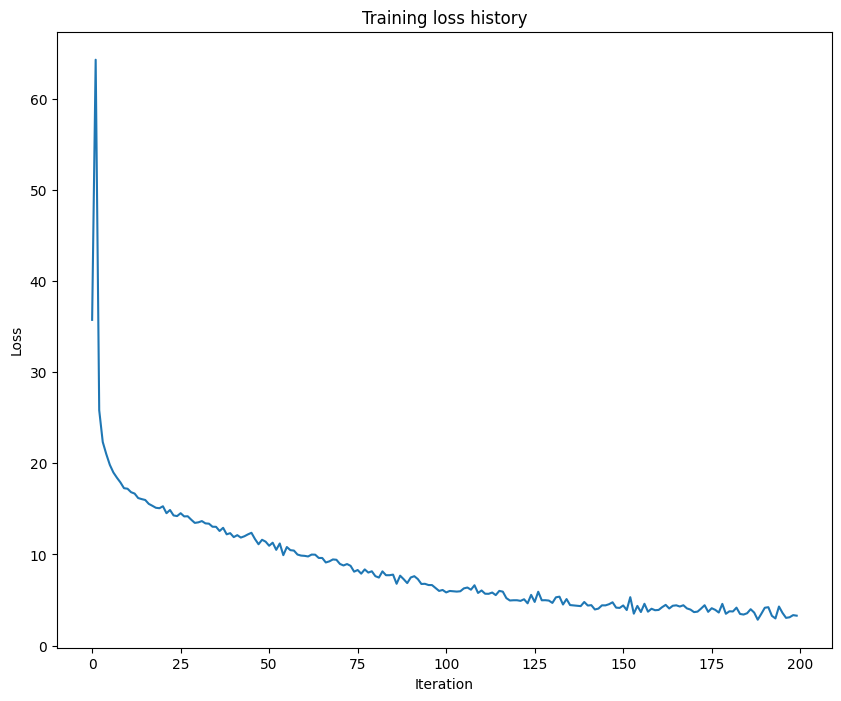

In [ ]:
# monitor the training loss

lr = 1e-3
detector = TwoStageDetector()
DetectionSolver(detector, small_train_loader, learning_rate=lr, num_epochs=200)

#### Inference

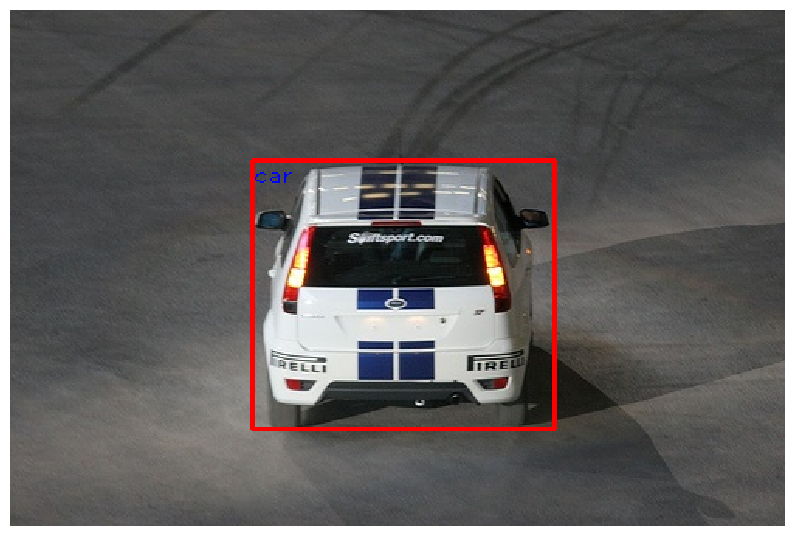

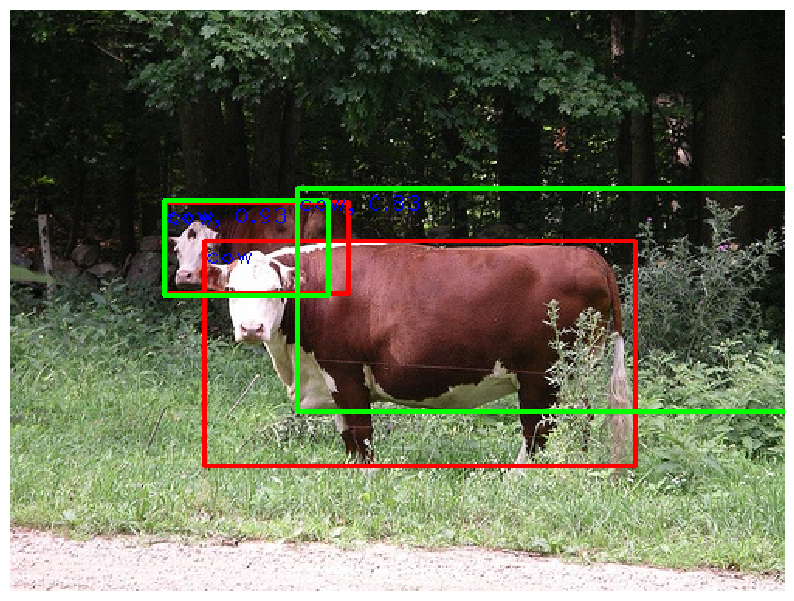

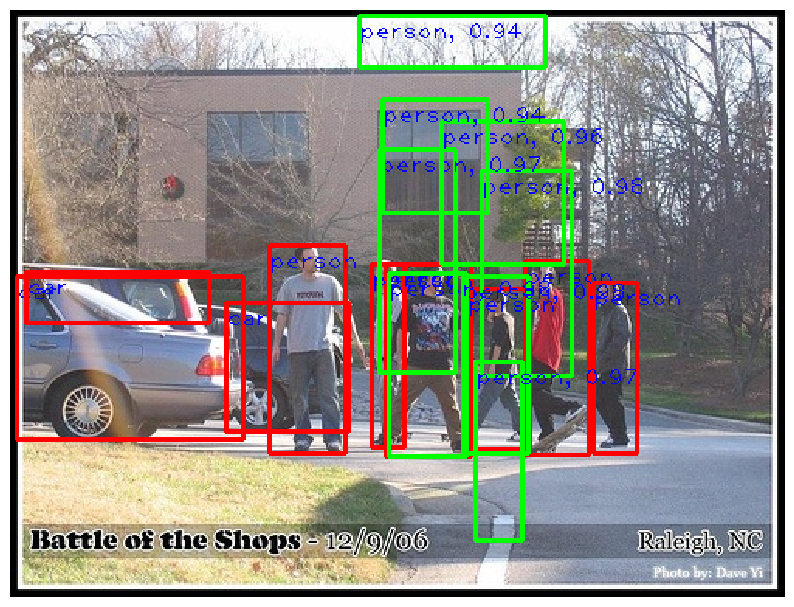

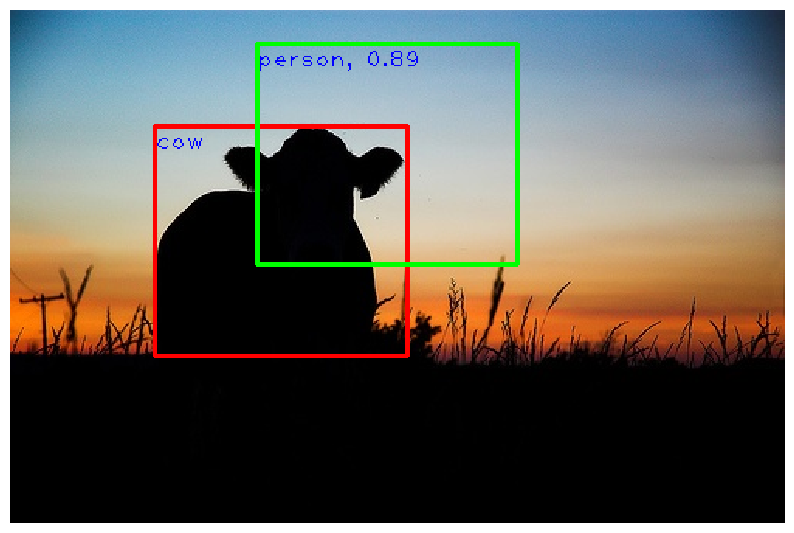

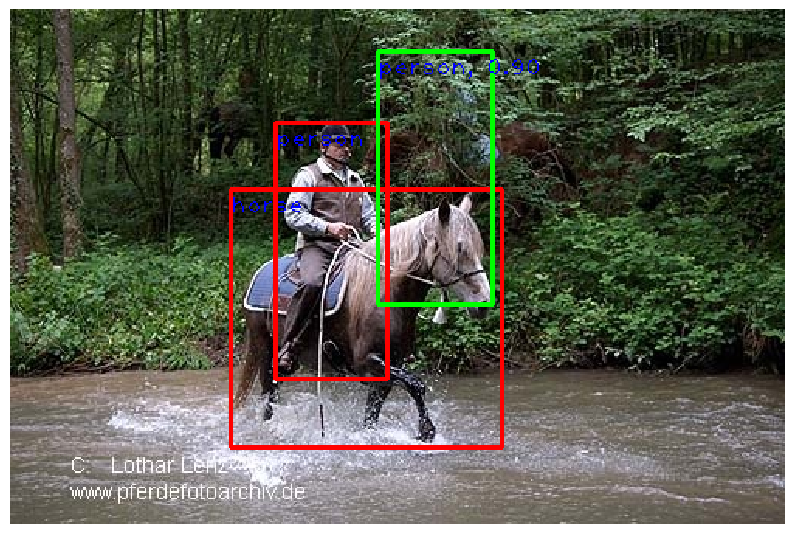

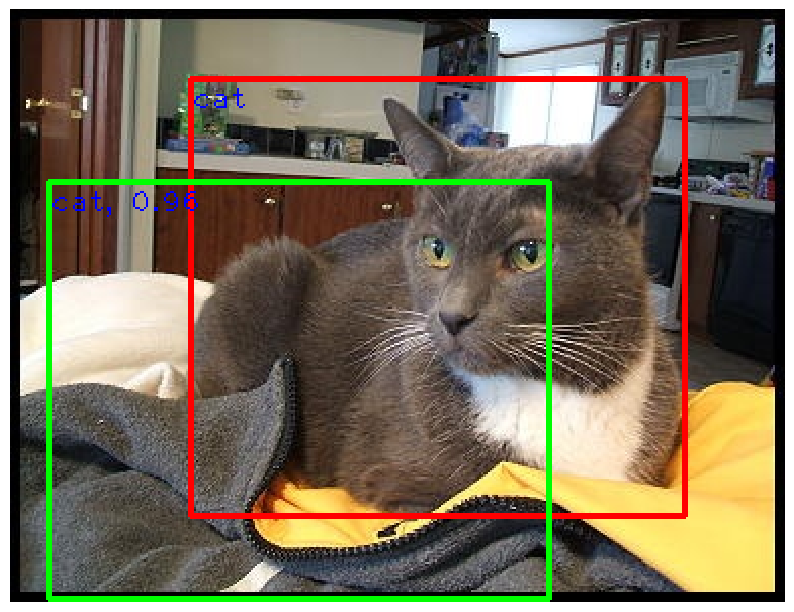

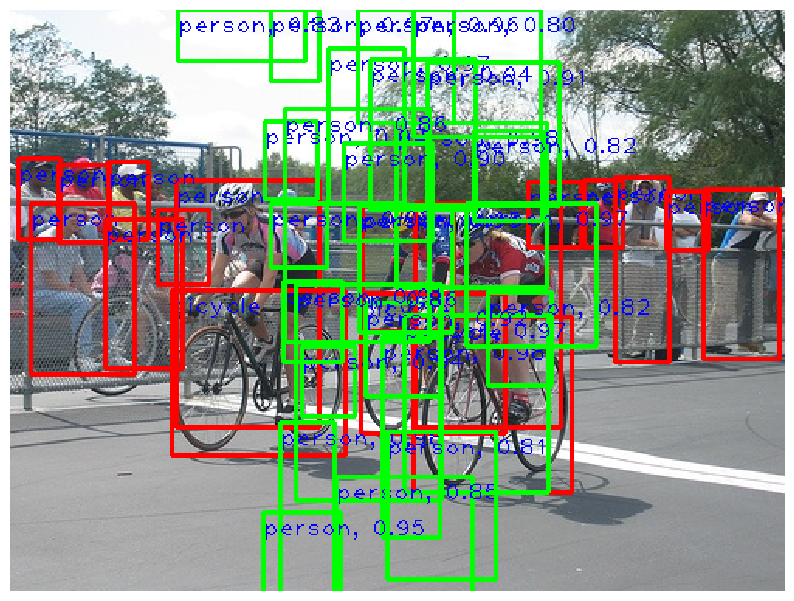

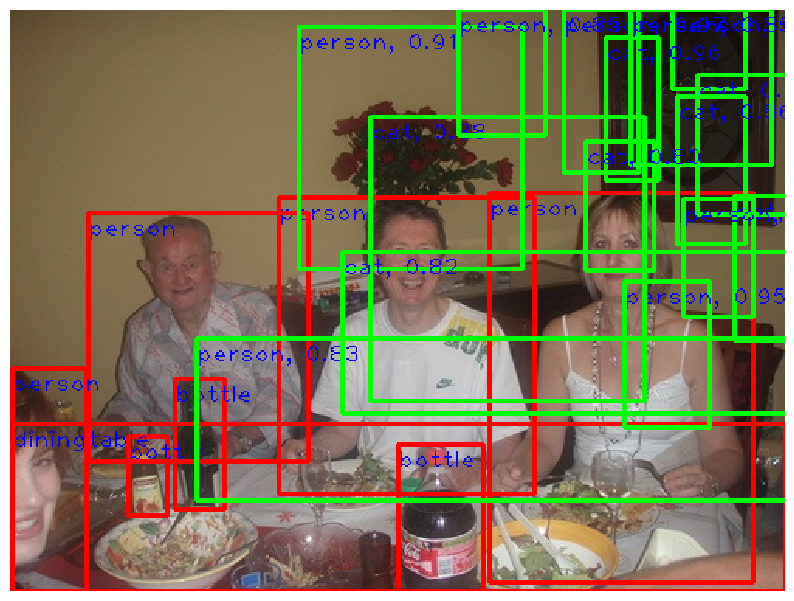

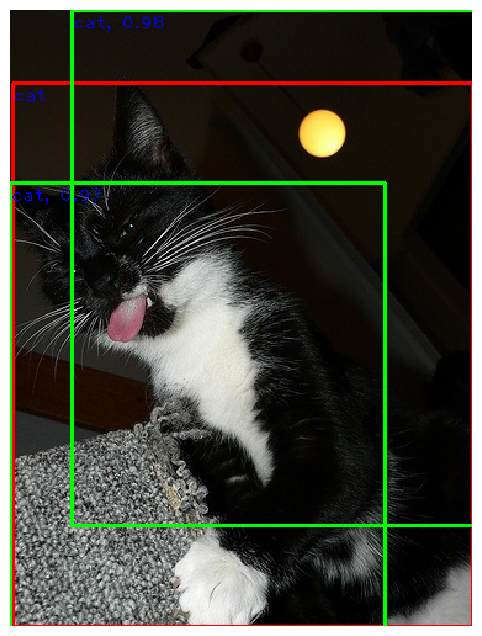

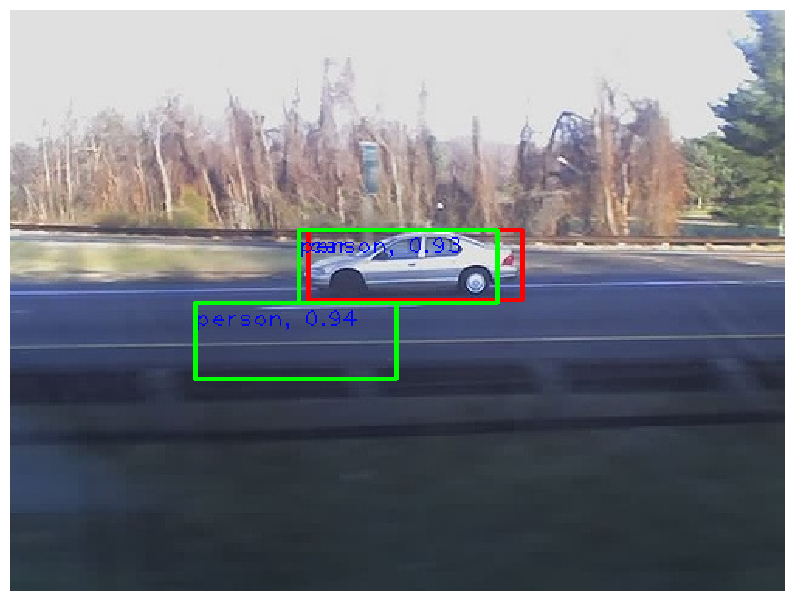

Total inference time: 3.3s


In [ ]:
# visualize the output from the overfitted model on small dataset
# the bounding boxes should be really accurate
DetectionInference(detector, small_train_loader, small_dataset, idx_to_class, thresh=0.8, nms_thresh=0.3)

### Train a net

이제 더 많은 데이터로 더 길게 학습시켜봅시다. 50 epoch 학습을 진행했을 때, 우리는 0.30 근방 혹은 그보다 낮은 loss 값을 가져야 합니다.

In [ ]:
# monitor the training loss
train_loader = pascal_voc2007_loader(train_dataset, 100) # a new loader

num_epochs = 50
lr = 5e-3
frcnn_detector = TwoStageDetector()
DetectionSolver(frcnn_detector, train_loader, learning_rate=lr, num_epochs=num_epochs)

number of pos proposals:  348
(Iter 0 / 25)
number of pos proposals:  410
(Iter 1 / 25)
number of pos proposals:  375
(Iter 2 / 25)
number of pos proposals:  362
(Iter 3 / 25)
number of pos proposals:  348
(Iter 4 / 25)
number of pos proposals:  316
(Iter 5 / 25)
number of pos proposals:  379
(Iter 6 / 25)
number of pos proposals:  362
(Iter 7 / 25)
number of pos proposals:  368
(Iter 8 / 25)
number of pos proposals:  363
(Iter 9 / 25)
number of pos proposals:  325
(Iter 10 / 25)
number of pos proposals:  355
(Iter 11 / 25)
number of pos proposals:  346
(Iter 12 / 25)
number of pos proposals:  363
(Iter 13 / 25)
number of pos proposals:  357
(Iter 14 / 25)
number of pos proposals:  349
(Iter 15 / 25)
number of pos proposals:  370
(Iter 16 / 25)
number of pos proposals:  367
(Iter 17 / 25)
number of pos proposals:  395
(Iter 18 / 25)
number of pos proposals:  386
(Iter 19 / 25)
number of pos proposals:  392
(Iter 20 / 25)
number of pos proposals:  405
(Iter 21 / 25)
number of pos propos

In [ ]:
# (optional) load/save checkpoint
# torch.save(frcnn_detector.state_dict(), 'frcnn_detector.pt') # uncomment to save your checkpoint
# frcnn_detector.load_state_dict(torch.load('frcnn_detector.pt')) # uncomment to load your previous checkpoint

#### Inference

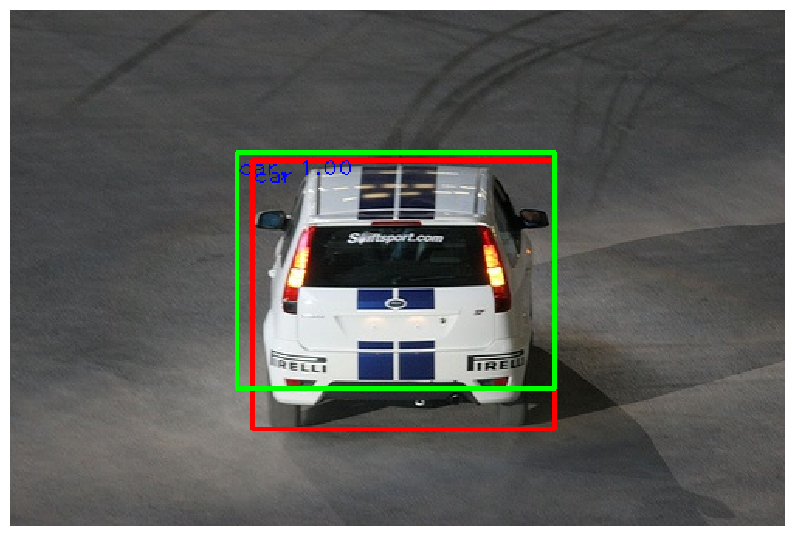

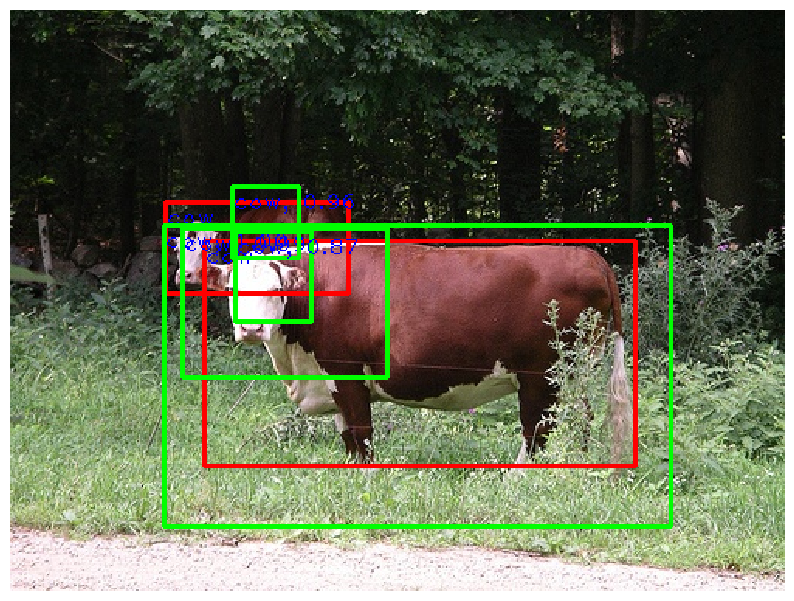

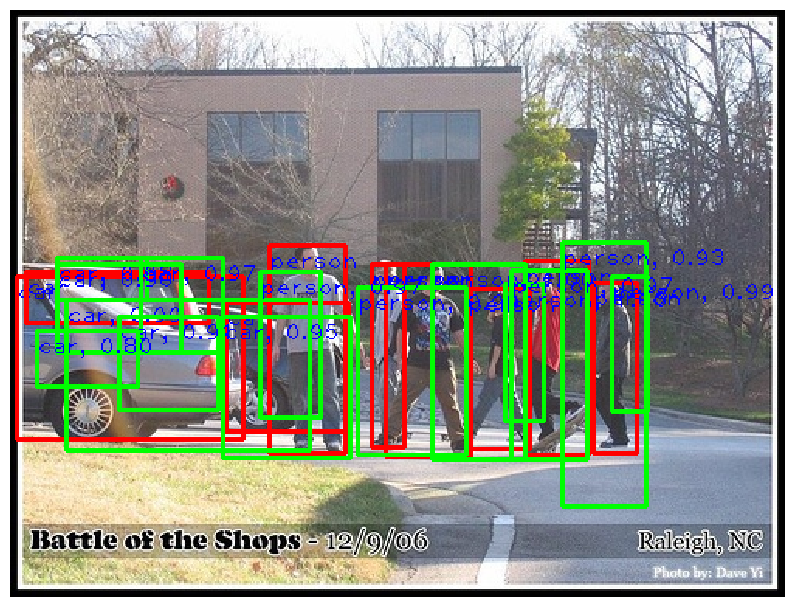

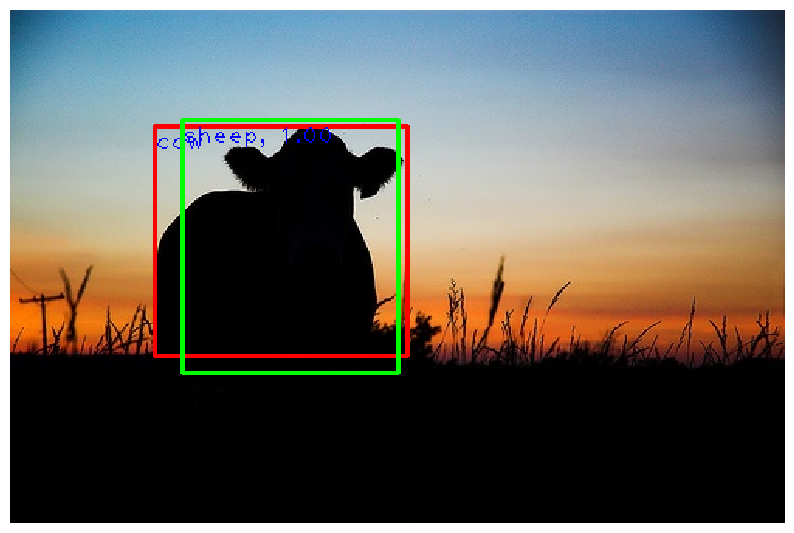

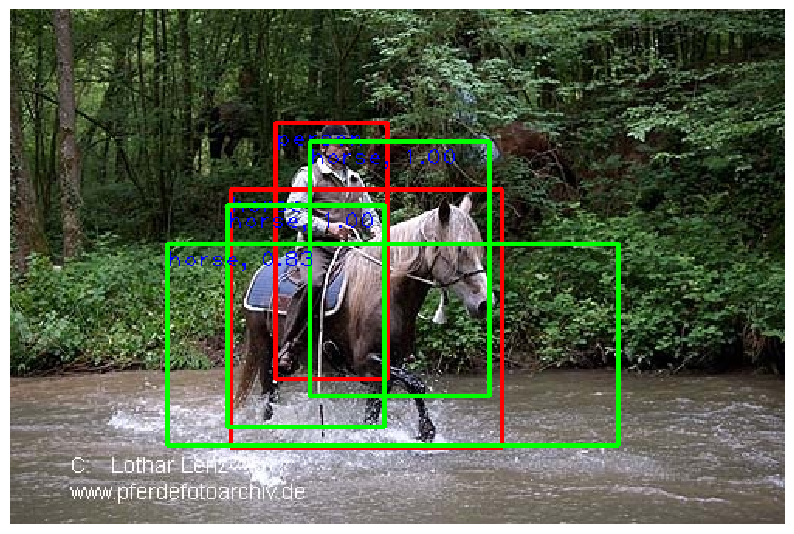

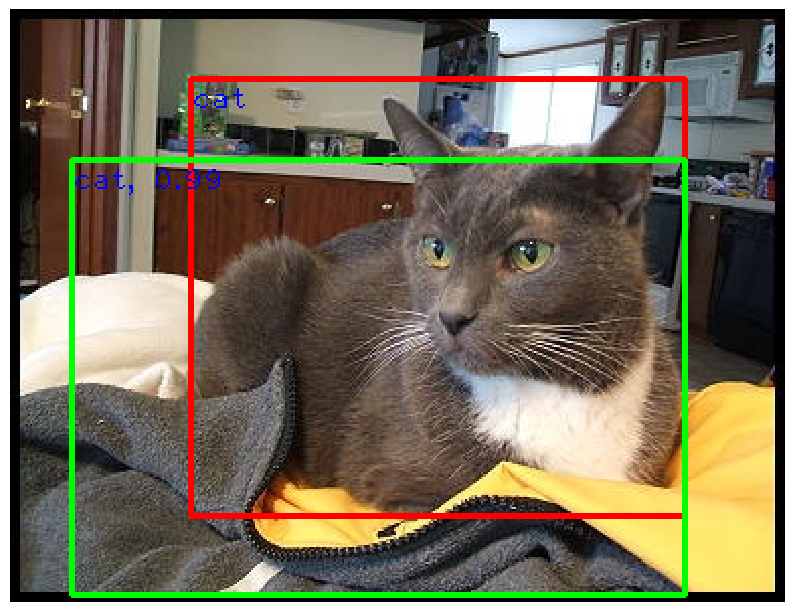

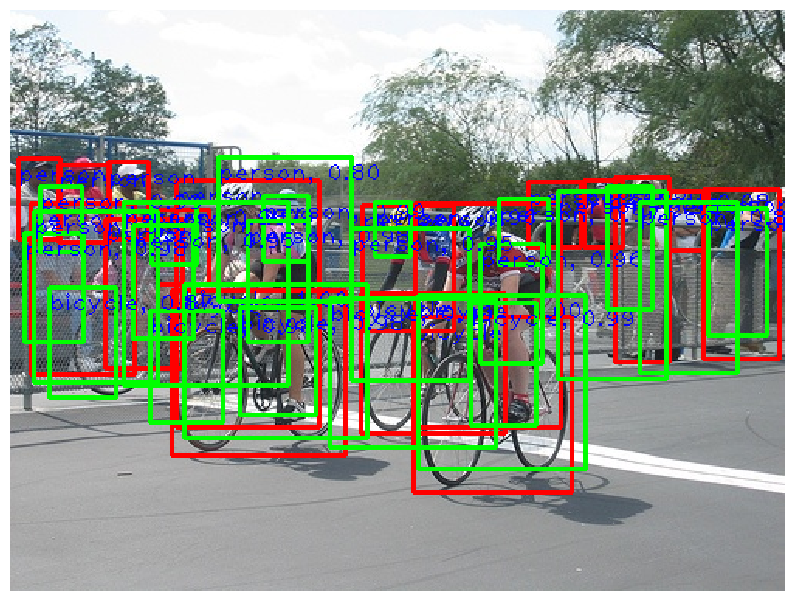

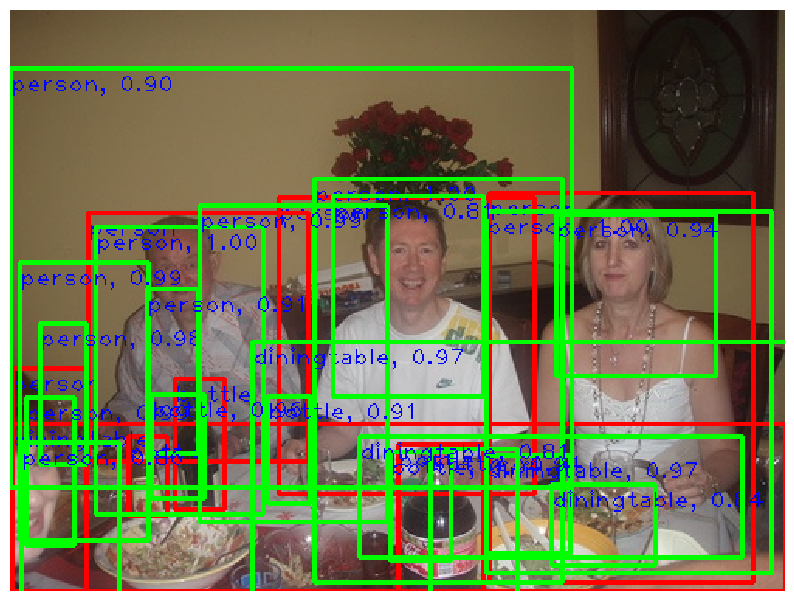

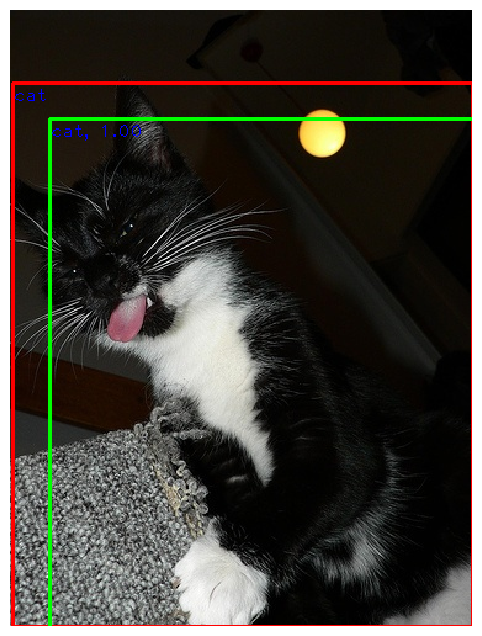

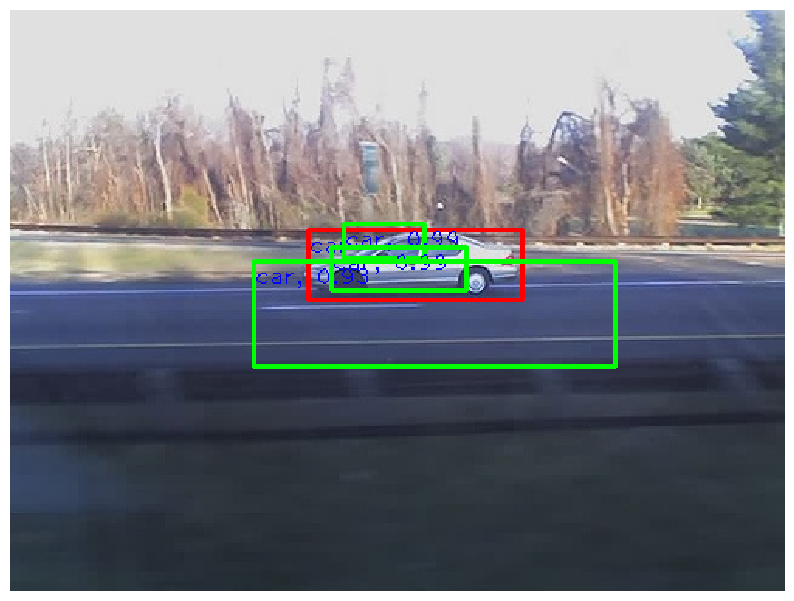

Total inference time: 2.7s


In [ ]:
# visualize the same output from the model trained on the entire training set
# some bounding boxes might not make sense
DetectionInference(frcnn_detector, small_train_loader, small_dataset, idx_to_class)

### Evaluation

validation set에 대해 16% 이상의 mAP를 관찰할 수 있다면 여러분은 올바르게 구현을 한 것입니다.

In [ ]:
!rm -r mAP/input/*
DetectionInference(frcnn_detector, val_loader, val_dataset, idx_to_class, output_dir='mAP/input', thresh=0.8, nms_thresh=0.3)
# DetectionInference(frcnn_detector, train_loader, train_dataset, idx_to_class, output_dir='mAP/input', thresh=0.8, nms_thresh=0.3) # uncomment to see training mAP
!cd mAP && python main.py --no-plot

# 2. Semantic Segmentation; U-Net





이를 구현하여 가장 대표적인 Object Detection과 함께 Segmentation을 지원해주는 데이터셋 중 하나인 PASCAL Visual Object Classes Challenge 2012 (PASCAL VOC 2012) 이미지들을 활용해 직접 Semantic Segmentation을 해보려고 합니다.

## Setting

In [1]:
!pip install -U albumentations

In [2]:
import os
import cv2
import numpy as np
import torch
import torch.nn as nn
import torchvision.transforms as transforms

from datetime import datetime
from torch.utils.data import DataLoader
from torch.optim.lr_scheduler import StepLR
from torch.utils.data import Dataset
from torchvision.datasets import VOCSegmentation
from torchvision.transforms.functional import to_tensor, to_pil_image
from albumentations import HorizontalFlip, Compose, Resize, Normalize
from tqdm import tqdm
from PIL import Image


## PASCAL VOC 2012 DataSet

Semantic Segmantation을 위해 Pytorch에서 지원해주는 DataSet중 하나인 PASCAL VOC 2012 DataSet을 사용합니다.

In [3]:
class myVOCSegmentation(VOCSegmentation):
    def __getitem__(self, index):
        img = Image.open(self.images[index]).convert('RGB')
        target = Image.open(self.masks[index])

        if self.transforms is not None:
            augmented = self.transforms(image=np.array(img), mask=np.array(target))
            img = augmented['image']
            target = augmented['mask']
            target[target>20] = 0

        img = to_tensor(img)
        target = torch.from_numpy(target).type(torch.long)
        return img, target

mean = [0.485, 0.456, 0.406]
std = [0.229, 0.224, 0.225]
h,w = 256, 256

transform_tran = Compose([Resize(h,w),
                          Normalize(mean=mean, std=std)])

transform_val = Compose([Resize(h,w),
                         Normalize(mean=mean, std=std)
                        ])

def createFolder(directory):
    try:
        if not os.path.exists(directory):
            os.makedirs(directory)
    except OSError:
        print('Error')

createFolder('./data')

path2data = './data'
trainset = myVOCSegmentation(path2data, year='2012', image_set='train', download=True, transforms=transform_tran)
valset = myVOCSegmentation(path2data, year='2012', image_set='val', download=True, transforms=transform_val)



100%|██████████| 1999639040/1999639040 [01:05<00:00, 30439432.82it/s]


Extracting ./data/VOCtrainval_11-May-2012.tar to ./data
Using downloaded and verified file: ./data/VOCtrainval_11-May-2012.tar
Extracting ./data/VOCtrainval_11-May-2012.tar to ./data


In [4]:
print(f"Size of TrainSet : {len(trainset)}")
print(f"Size of ValSet : {len(valset)}")

Size of TrainSet : 1464
Size of ValSet : 1449


## U-Net Model

Unet의 original input shape 572x572x1이지만, 데이터셋에 맞추어 256x256x3으로 바꾸어 사용하였습니다.

이에 따라, Unet architecture 역시 달라졌으므로 설명에 맞게 코드를 고쳐주시면 됩니다.

In [5]:
def conv(in_channels, out_channels):

    '''
      conv 함수의 형태는 다음과 같습니다.

      -------------------------------------------------------------
      (1) 3x3 conv layer, channel = out_channels, padding = 1
      (2) Batch Normalization
      (3) ReLU
      -------------------------------------------------------------
      x2
    '''
    ################################################################################
    # TODO:                                                                        #
    # Fill In the code                                                             #
    ################################################################################
    conv_block = nn.Sequential(
        nn.Conv2d(in_channels, out_channels, 3, padding=1),  # 3은 kernel size
        nn.BatchNorm2d(out_channels),
        nn.ReLU(inplace=True),
        nn.Conv2d(out_channels, out_channels, 3, padding=1),
        nn.BatchNorm2d(out_channels),
        nn.ReLU(inplace=True)
    )

    ################################################################################
    #                                 END OF YOUR CODE                             #
    ################################################################################
    return conv_block


class Unet(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(Unet, self).__init__()
        '''
          skip architecture를 고려하여 빈칸을 채워주세요.

          Hint : convUp4는 convDown5를 거치고 Upsample한 feature와 convDown4를 거치고 나온 feature를 결합한 것을 input으로 갖는다.
        '''
        ################################################################################
        # TODO:                                                                        #
        # Fill In the code                                                             #
        ################################################################################
        self.convDown1 = conv(in_channels, 64)
        self.convDown2 = conv(64, 128)
        self.convDown3 = conv(128, 256)
        self.convDown4 = conv(256, 512)
        self.convDown5 = conv(512, 1024)
        self.maxpool = nn.MaxPool2d(2, stride=2)
        self.upsample = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        self.convUp4 = conv(1536, 512) #1024+512
        self.convUp3 = conv(768, 256) #512+256
        self.convUp2 = conv(384, 128) #256+128
        self.convUp1 = conv(192, 64) #128+64
        self.convUp_fin = nn.Conv2d(64, out_channels, 1)
        ################################################################################
        #                                 END OF YOUR CODE                             #
        ################################################################################


    def forward(self, x):
        conv1 = self.convDown1(x)
        x = self.maxpool(conv1)
        conv2 = self.convDown2(x)
        x = self.maxpool(conv2)
        conv3 = self.convDown3(x)
        x = self.maxpool(conv3)
        conv4 = self.convDown4(x)
        x = self.maxpool(conv4)
        conv5 = self.convDown5(x)
        x = self.upsample(conv5)

        ################################################################################
        # TODO:                                                                        #
        # Fill In the code                                                             #
        ################################################################################
        x = torch.cat([conv4, x], dim = 1)
        x = self.convUp4(x)
        x = self.upsample(x)

        x = torch.cat([conv3, x], dim = 1)
        x = self.convUp3(x)
        x = self.upsample(x)

        x = torch.cat([conv2, x], dim = 1)
        x = self.convUp2(x)
        x = self.upsample(x)

        x = torch.cat([conv1, x], dim = 1)
        x = self.convUp1(x)
        out = self.convUp_fin(x)
        ################################################################################
        #                                 END OF YOUR CODE                             #
        ################################################################################
        return out

## Modules

Training 및 Validation에 필요한 function들을 구현하는 Section입니다. 적절한 코드를 채워주세요.

### Accraucy Function

Accuracy를 구하는데 필요한 함수들입니다. 따로 수정할 필요 없습니다.

In [6]:
def accuracy_check(label, pred):
    ims = [label, pred]
    np_ims = []
    for item in ims:
        item = np.array(item)
        np_ims.append(item)
    compare = np.equal(np_ims[0], np_ims[1])
    accuracy = np.sum(compare)
    return accuracy / len(np_ims[0].flatten())

def accuracy_check_for_batch(labels, preds, batch_size):
    total_acc = 0
    for i in range(batch_size):
        total_acc += accuracy_check(labels[i], preds[i])
    return total_acc/batch_size

### Train Module


In [7]:
def train_model(trainloader, model, criterion, optimizer,scheduler, device):
    model.train()
    for i, (inputs, labels) in tqdm(enumerate(trainloader), total = len(trainloader)):
        from datetime import datetime

        inputs = inputs.to(device)
        labels = labels.to(device=device, dtype=torch.int64)
        criterion = criterion.cuda()
        ################################################################################
        # TODO:                                                                        #
        # Fill In the code                                                             #
        ################################################################################

        # forward pass
        outputs = model(inputs)
        # compute loss
        loss = criterion(outputs, labels)

        # optimizer + backpropagation
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        ################################################################################
        #                                 END OF YOUR CODE                             #
        ################################################################################

### Training Loss Module

In [8]:
def get_loss_train(model, trainloader, criterion, device):

    model.eval()
    total_acc = 0
    total_loss = 0
    for batch, (inputs, labels) in tqdm(enumerate(trainloader), total = len(trainloader)):
        with torch.no_grad():
            inputs = inputs.to(device)
            labels = labels.to(device = device, dtype = torch.int64)
            inputs = inputs.float()
            ################################################################################
            # TODO:                                                                        #
            # Fill In the code                                                             #
            ################################################################################

            # forward pass
            outputs = model(inputs)
            # compute loss
            loss = criterion(outputs, labels)

            ################################################################################
            #                                 END OF YOUR CODE                             #
            ################################################################################
            outputs = np.transpose(outputs.cpu(), (0,2,3,1))
            preds = torch.argmax(outputs, dim=3).float()
            acc = accuracy_check_for_batch(labels.cpu(), preds.cpu(), inputs.size()[0])
            total_acc += acc
            total_loss += loss.cpu().item()
    return total_acc/(batch+1), total_loss/(batch+1)

### Validation module

In [9]:
def val_model(model, valloader, criterion, device):

    total_val_loss = 0
    total_val_acc = 0
    n=0

    for batch, (inputs, labels) in tqdm(enumerate(valloader), total = len(valloader)):
        with torch.no_grad():

            inputs = inputs.to(device)
            labels = labels.to(device=device, dtype=torch.int64)
            ################################################################################
            # TODO:                                                                        #
            # Fill In the code                                                             #
            ################################################################################

            # forward pass
            outputs = model(inputs)
            # compute loss
            loss = criterion(outputs, labels)

            ################################################################################
            #                                 END OF YOUR CODE                             #
            ################################################################################

            outputs = np.transpose(outputs.cpu(), (0, 2, 3, 1))
            preds = torch.argmax(outputs, dim=3).float()

            acc = accuracy_check_for_batch(labels.cpu(), preds.cpu(), inputs.size()[0])
            total_val_acc += acc
            total_val_loss += loss.cpu().item()



    return total_val_acc/(batch+1), total_val_loss/(batch+1)

## Train

본격적인 학습을 시작하는 Section입니다. HyperParameter tuning을 통해 좋은 성능의 모델을 만들어주세요!

### Setting

In [10]:
# Hyperparameter
################################################################################
# TODO:                                                                        #
# Hyperparameter Tuning                                                        #
################################################################################

batch_size = 16
learning_rate = 0.001
epochs = 50

################################################################################
#                                 END OF YOUR CODE                             #
################################################################################

resize_size = 256

print("tainLoader")
trainLoader = DataLoader(trainset, batch_size = batch_size, shuffle=True)
print("valLoader")
validLoader = DataLoader(valset, batch_size = batch_size, shuffle=True)

model = Unet(3, 21)

criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
scheduler = StepLR(optimizer, step_size=4, gamma=0.1)

device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
print(device)
model = model.to(device)

history = {'train_loss':[], 'train_acc':[], 'val_loss':[], 'val_acc':[]}
#model.load_state_dict(torch.load('./Project3/trained_model/resnet_encoder_unet.pth', map_location='cuda:0'))

tainLoader
valLoader
cuda:0


### Training

In [ ]:
print("Training")
for epoch in range(epochs):

    train_model(trainLoader, model, criterion, optimizer, scheduler, device)
    train_acc, train_loss = get_loss_train(model, trainLoader, criterion, device)
    print("epoch", epoch + 1, "train loss : ", train_loss, "train acc : ", train_acc)

    val_acc, val_loss = val_model(model, validLoader, criterion, device)
    print("epoch", epoch + 1, "val loss : ", val_loss, "val acc : ", val_acc)

    history['train_loss'].append(train_loss)
    history['train_acc'].append(train_acc)
    history['val_loss'].append(val_loss)
    history['val_acc'].append(val_acc)

    if epoch % 5 == 0:

        torch.save(model.state_dict(), f'./{str(epoch)}.pth')
        ##### fill in here #####
        ##### Hint : save the model parameter

print('Finish Training')

Training


100%|██████████| 92/92 [01:06<00:00,  1.38it/s]


epoch 1 train loss :  1.1986276844273442 train acc :  0.74714151672695


100%|██████████| 91/91 [01:04<00:00,  1.40it/s]


epoch 1 val loss :  1.207719732771863 val acc :  0.7448621244512053


100%|██████████| 92/92 [01:17<00:00,  1.19it/s]


epoch 2 train loss :  1.1472803282996882 train acc :  0.7496752635292385


100%|██████████| 91/91 [01:09<00:00,  1.30it/s]


epoch 2 val loss :  1.1576259155849835 val acc :  0.7475535633799794


100%|██████████| 92/92 [01:18<00:00,  1.17it/s]


epoch 3 train loss :  1.1354700871135877 train acc :  0.7494534927865734


100%|██████████| 91/91 [01:10<00:00,  1.29it/s]


epoch 3 val loss :  1.142611896598732 val acc :  0.7478356402144474


100%|██████████| 92/92 [01:05<00:00,  1.40it/s]


epoch 4 train loss :  1.1525244933107626 train acc :  0.7490546288697616


100%|██████████| 91/91 [01:03<00:00,  1.42it/s]


epoch 4 val loss :  1.1681939304529965 val acc :  0.7473755150633126


100%|██████████| 92/92 [01:04<00:00,  1.42it/s]


epoch 5 train loss :  1.2327269179665523 train acc :  0.7493349158245585


100%|██████████| 91/91 [01:03<00:00,  1.42it/s]


epoch 5 val loss :  1.2545857102006346 val acc :  0.7486853523859902


100%|██████████| 92/92 [01:04<00:00,  1.42it/s]


epoch 6 train loss :  1.1339699470478555 train acc :  0.7319078238114066


100%|██████████| 91/91 [01:04<00:00,  1.41it/s]


epoch 6 val loss :  1.1522815974204095 val acc :  0.7297792539491759


100%|██████████| 92/92 [01:08<00:00,  1.35it/s]


epoch 7 train loss :  1.0413774984038395 train acc :  0.7523815735526707


100%|██████████| 91/91 [01:06<00:00,  1.37it/s]


epoch 7 val loss :  1.0786809862314999 val acc :  0.7505069378677014


100%|██████████| 92/92 [01:07<00:00,  1.36it/s]


epoch 8 train loss :  1.043477115423783 train acc :  0.753246722014054


100%|██████████| 91/91 [01:05<00:00,  1.38it/s]


epoch 8 val loss :  1.0717388948241433 val acc :  0.7500716955816061


100%|██████████| 92/92 [01:07<00:00,  1.36it/s]


epoch 9 train loss :  1.031328973562821 train acc :  0.7530890858691671


100%|██████████| 91/91 [01:05<00:00,  1.40it/s]


epoch 9 val loss :  1.0659907637061654 val acc :  0.7506436544751364


100%|██████████| 92/92 [01:06<00:00,  1.39it/s]


epoch 10 train loss :  0.9937511565892593 train acc :  0.7548374507738196


100%|██████████| 91/91 [01:05<00:00,  1.39it/s]


epoch 10 val loss :  1.0391534023232512 val acc :  0.7502689606104141


100%|██████████| 92/92 [01:06<00:00,  1.38it/s]


epoch 11 train loss :  0.991346974087798 train acc :  0.7515895470328953


100%|██████████| 91/91 [01:04<00:00,  1.40it/s]


epoch 11 val loss :  1.0300696583894582 val acc :  0.745715088896699


100%|██████████| 92/92 [01:08<00:00,  1.34it/s]


epoch 12 train loss :  1.109997804398122 train acc :  0.7517487588136093


100%|██████████| 91/91 [01:07<00:00,  1.35it/s]


epoch 12 val loss :  1.166357947574867 val acc :  0.7484749035957533


100%|██████████| 92/92 [01:07<00:00,  1.36it/s]


epoch 13 train loss :  0.9667196461687917 train acc :  0.7558598933012589


100%|██████████| 91/91 [01:06<00:00,  1.36it/s]


epoch 13 val loss :  1.0074778271245433 val acc :  0.749943380390768


100%|██████████| 92/92 [01:07<00:00,  1.37it/s]


epoch 14 train loss :  0.9376495901657187 train acc :  0.7608357927073603


100%|██████████| 91/91 [01:06<00:00,  1.37it/s]


epoch 14 val loss :  0.9886641436880761 val acc :  0.7532206909123795


100%|██████████| 92/92 [01:06<00:00,  1.38it/s]


epoch 15 train loss :  0.9347670739111693 train acc :  0.7571755388508672


100%|██████████| 91/91 [01:05<00:00,  1.39it/s]


epoch 15 val loss :  0.9986067715581957 val acc :  0.746925159542843


100%|██████████| 92/92 [01:06<00:00,  1.38it/s]


epoch 16 train loss :  0.9301851249259451 train acc :  0.7588101055311121


100%|██████████| 91/91 [01:04<00:00,  1.41it/s]


epoch 16 val loss :  0.995117799266354 val acc :  0.7502472776196378


100%|██████████| 92/92 [01:08<00:00,  1.34it/s]


epoch 17 train loss :  0.9850357194309649 train acc :  0.7545635907546334


100%|██████████| 91/91 [01:07<00:00,  1.34it/s]


epoch 17 val loss :  1.048578870165479 val acc :  0.7499094242286916


100%|██████████| 92/92 [01:08<00:00,  1.35it/s]


epoch 18 train loss :  0.942345520724421 train acc :  0.757405135942542


100%|██████████| 91/91 [01:07<00:00,  1.36it/s]


epoch 18 val loss :  1.0109288974122688 val acc :  0.7473674804445297


100%|██████████| 92/92 [01:07<00:00,  1.37it/s]


epoch 19 train loss :  0.9167405535345492 train acc :  0.7602452609850012


100%|██████████| 91/91 [01:06<00:00,  1.36it/s]


epoch 19 val loss :  1.0108508644523202 val acc :  0.752530927040929


100%|██████████| 92/92 [01:07<00:00,  1.36it/s]


epoch 20 train loss :  0.8682714532250944 train acc :  0.7660619694253673


100%|██████████| 91/91 [01:06<00:00,  1.37it/s]


epoch 20 val loss :  0.9418154568462581 val acc :  0.7558761778331937


100%|██████████| 92/92 [01:07<00:00,  1.37it/s]


epoch 21 train loss :  0.9091843969148138 train acc :  0.7640857903853707


100%|██████████| 91/91 [01:05<00:00,  1.39it/s]


epoch 21 val loss :  0.9936115165333171 val acc :  0.7510884206955831


100%|██████████| 92/92 [01:09<00:00,  1.32it/s]


epoch 22 train loss :  0.9454310024562089 train acc :  0.7559446873872177


100%|██████████| 91/91 [01:07<00:00,  1.34it/s]


epoch 22 val loss :  1.0400289388803334 val acc :  0.7497482311449062


100%|██████████| 92/92 [01:09<00:00,  1.32it/s]


epoch 23 train loss :  0.8630037515059762 train acc :  0.7682986466780953


100%|██████████| 91/91 [01:07<00:00,  1.34it/s]


epoch 23 val loss :  0.9550248810223171 val acc :  0.7543558765825916


100%|██████████| 92/92 [01:08<00:00,  1.34it/s]


epoch 24 train loss :  0.8370162753955178 train acc :  0.7701649458512015


100%|██████████| 91/91 [01:08<00:00,  1.34it/s]


epoch 24 val loss :  0.9384456702641079 val acc :  0.7574939844226953


100%|██████████| 92/92 [01:08<00:00,  1.34it/s]


epoch 25 train loss :  0.8186243921518326 train acc :  0.7752370627030082


100%|██████████| 91/91 [01:07<00:00,  1.35it/s]


epoch 25 val loss :  0.9309672831179021 val acc :  0.7597787598550537


100%|██████████| 92/92 [01:09<00:00,  1.33it/s]


epoch 26 train loss :  0.8335858939782433 train acc :  0.7691005520198656


100%|██████████| 91/91 [01:07<00:00,  1.34it/s]


epoch 26 val loss :  0.9510012773367075 val acc :  0.75750305422642


100%|██████████| 92/92 [01:10<00:00,  1.31it/s]


epoch 27 train loss :  0.8352049666902294 train acc :  0.7747208864792533


100%|██████████| 91/91 [01:08<00:00,  1.33it/s]


epoch 27 val loss :  0.9472651985975412 val acc :  0.7534132271604805


100%|██████████| 92/92 [01:09<00:00,  1.32it/s]


epoch 28 train loss :  0.9252247220796087 train acc :  0.7463710100754447


100%|██████████| 91/91 [01:08<00:00,  1.34it/s]


epoch 28 val loss :  1.0376543212722946 val acc :  0.7248578997322054


100%|██████████| 92/92 [01:08<00:00,  1.35it/s]


epoch 29 train loss :  0.9149934344965479 train acc :  0.7459972215735394


100%|██████████| 91/91 [01:07<00:00,  1.35it/s]


epoch 29 val loss :  1.0436281810750019 val acc :  0.7213578183426815


100%|██████████| 92/92 [01:07<00:00,  1.36it/s]


epoch 30 train loss :  0.7929118278881778 train acc :  0.7815787377564803


100%|██████████| 91/91 [01:07<00:00,  1.35it/s]


epoch 30 val loss :  0.9300678028510168 val acc :  0.7630066877465254


100%|██████████| 92/92 [01:06<00:00,  1.38it/s]


epoch 31 train loss :  0.7822869070198225 train acc :  0.773632868476536


100%|██████████| 91/91 [01:06<00:00,  1.37it/s]


epoch 31 val loss :  0.932380906173161 val acc :  0.7554162203610598


100%|██████████| 92/92 [01:10<00:00,  1.30it/s]


epoch 32 train loss :  0.8673065026169238 train acc :  0.769566940224689


100%|██████████| 91/91 [01:09<00:00,  1.31it/s]


epoch 32 val loss :  1.0410870870391091 val acc :  0.7557003582499111


100%|██████████| 92/92 [01:10<00:00,  1.31it/s]


epoch 33 train loss :  0.7505922541022301 train acc :  0.7833256203195323


100%|██████████| 91/91 [01:07<00:00,  1.34it/s]


epoch 33 val loss :  0.9390631521141136 val acc :  0.7614729244339307


100%|██████████| 92/92 [01:09<00:00,  1.32it/s]


epoch 34 train loss :  0.7789500190511994 train acc :  0.7839000743368397


100%|██████████| 91/91 [01:08<00:00,  1.33it/s]


epoch 34 val loss :  0.9767926558033451 val acc :  0.7600882813170716


100%|██████████| 92/92 [01:10<00:00,  1.31it/s]


epoch 35 train loss :  0.6945121194357458 train acc :  0.7988505259804104


100%|██████████| 91/91 [01:07<00:00,  1.34it/s]


epoch 35 val loss :  0.8994486200940478 val acc :  0.76775817847805


100%|██████████| 92/92 [01:09<00:00,  1.32it/s]


epoch 36 train loss :  0.7060149315258731 train acc :  0.7910448364589525


100%|██████████| 91/91 [01:07<00:00,  1.35it/s]


epoch 36 val loss :  0.931128170136567 val acc :  0.7590603799319239


100%|██████████| 92/92 [01:09<00:00,  1.32it/s]


epoch 37 train loss :  0.7417651032624037 train acc :  0.7912598278211511


100%|██████████| 91/91 [01:08<00:00,  1.33it/s]


epoch 37 val loss :  0.9494448939522544 val acc :  0.7574949590568868


100%|██████████| 92/92 [01:08<00:00,  1.34it/s]


epoch 38 train loss :  0.6408697875297588 train acc :  0.8065339689669402


100%|██████████| 91/91 [01:08<00:00,  1.33it/s]


epoch 38 val loss :  0.9055730916641571 val acc :  0.7618488584245954


100%|██████████| 92/92 [01:08<00:00,  1.34it/s]


epoch 39 train loss :  0.6158401758774467 train acc :  0.8093294060748556


100%|██████████| 91/91 [01:07<00:00,  1.35it/s]


epoch 39 val loss :  0.9110455545750293 val acc :  0.7633898226187198


100%|██████████| 92/92 [01:07<00:00,  1.36it/s]


epoch 40 train loss :  0.5773917132097742 train acc :  0.827088335286016


100%|██████████| 91/91 [01:07<00:00,  1.36it/s]


epoch 40 val loss :  0.9024962985908592 val acc :  0.7691554813594609


100%|██████████| 92/92 [01:07<00:00,  1.36it/s]


epoch 41 train loss :  0.7027851281606633 train acc :  0.8006468648495881


100%|██████████| 91/91 [01:07<00:00,  1.35it/s]


epoch 41 val loss :  1.0281935530704456 val acc :  0.7572907819270506


100%|██████████| 92/92 [01:10<00:00,  1.30it/s]


epoch 42 train loss :  0.6087199617987094 train acc :  0.8156448758166769


100%|██████████| 91/91 [01:09<00:00,  1.32it/s]


epoch 42 val loss :  0.9786606103509337 val acc :  0.7559295323596624


100%|██████████| 92/92 [01:10<00:00,  1.31it/s]


epoch 43 train loss :  0.5037097592392693 train acc :  0.8450703724570896


100%|██████████| 91/91 [01:08<00:00,  1.33it/s]


epoch 43 val loss :  0.9545622327170529 val acc :  0.7615855662959544


100%|██████████| 92/92 [01:09<00:00,  1.32it/s]


epoch 44 train loss :  0.5404445000964663 train acc :  0.8348210065261178


100%|██████████| 91/91 [01:09<00:00,  1.32it/s]


epoch 44 val loss :  0.9639481862822732 val acc :  0.7539448930230332


100%|██████████| 92/92 [01:12<00:00,  1.27it/s]


epoch 45 train loss :  0.5744623272963192 train acc :  0.8213236850240956


100%|██████████| 91/91 [01:10<00:00,  1.28it/s]


epoch 45 val loss :  1.1409461819208586 val acc :  0.759559806013282


100%|██████████| 92/92 [01:10<00:00,  1.31it/s]


epoch 46 train loss :  0.609305330592653 train acc :  0.8358239298281462


100%|██████████| 91/91 [01:09<00:00,  1.32it/s]


epoch 46 val loss :  1.1725805559001126 val acc :  0.7569658281747821


100%|██████████| 92/92 [01:11<00:00,  1.28it/s]


epoch 47 train loss :  0.5509613033222116 train acc :  0.824763069982114


100%|██████████| 91/91 [01:09<00:00,  1.31it/s]


epoch 47 val loss :  1.0488551992636461 val acc :  0.7274791556836921


100%|██████████| 92/92 [01:08<00:00,  1.34it/s]


epoch 48 train loss :  0.33843876632011455 train acc :  0.8913565614949102


100%|██████████| 91/91 [01:08<00:00,  1.33it/s]


epoch 48 val loss :  0.941624892281962 val acc :  0.772472767020611


100%|██████████| 92/92 [01:08<00:00,  1.34it/s]


epoch 49 train loss :  0.40566066150432045 train acc :  0.8640550323154615


100%|██████████| 91/91 [01:07<00:00,  1.36it/s]


epoch 49 val loss :  1.0809963862974565 val acc :  0.7634035571590885


 70%|██████▉   | 64/92 [00:47<00:22,  1.25it/s]

### Training Visualization

In [ ]:
import matplotlib.pyplot as plt

plt.subplot(2,1,1)
plt.plot(range(epoch+1), history['train_loss'], label='Loss', color='red')
plt.plot(range(epoch+1), history['val_loss'], label='Loss', color='blue')

plt.title('Loss history')
plt.xlabel('epoch')
plt.ylabel('loss')
# plt.show

plt.subplot(2,1,2)
plt.plot(range(epoch+1), history['train_acc'], label='Accuracy', color='red')
plt.plot(range(epoch+1), history['val_acc'], label='Accuracy', color='blue')

plt.title('Accuracy history')
plt.xlabel('epoch')
plt.ylabel('accuracy')
plt.savefig(result_save_dir+'result')

print("Fin")

## Inference

모델이 얼마나 잘 Sementation 하는지 확인하여 봅시다! 밑의 두 코드를 실행시켜주세요.

In [ ]:
import matplotlib.pyplot as plt

def re_normalize(x, mean=mean, std=std):
    x_r = x.clone()
    for c, (mean_c, std_c) in enumerate(zip(mean,std)):
        x_r[c] *= std_c
        x_r[c] += mean_c
    return x_r

def inference(model, inputs, labels, device):

    cls_invert = {0: (0, 0, 0), 1: (128, 0, 0), 2: (0, 128, 0),  # 0:background, 1:aeroplane, 2:bicycle
                  3: (128, 128, 0), 4: (0, 0, 128), 5: (128, 0, 128),  # 3:bird, 4:boat, 5:bottle
                  6: (0, 128, 128), 7: (128, 128, 128), 8: (64, 0, 0),  # 6:bus, 7:car, 8:cat
                  9: (192, 0, 0), 10: (64, 128, 0), 11: (192, 128, 0),  # 9:chair, 10:cow, 11:diningtable
                  12: (64, 0, 128), 13: (192, 0, 128), 14: (64, 128, 128),  # 12:dog, 13:horse, 14:motorbike
                  15: (192, 128, 128), 16: (0, 64, 0), 17: (128, 64, 0),  # 15:person, 16:pottedplant, 17:sheep
                  18: (0, 192, 0), 19: (128, 192, 0), 20: (0, 64, 128),  # 18:sofa, 19:train, 20:tvmonitor
                  }

    with torch.no_grad():

        inputs = inputs.to(device)
        labels = labels.to(device=device, dtype=torch.int64)
        outputs = model(inputs)
        outputs = np.transpose(outputs.cpu(), (0, 2, 3, 1))
        preds = torch.argmax(outputs, dim=3).float()

        temp = preds[0].cpu().data.numpy()
        temp_l = labels.cpu().data.numpy()
        temp_rgb = np.zeros((temp.shape[0], temp.shape[1], 3))
        temp_label = np.zeros((temp.shape[0], temp.shape[1], 3))

        for j in range(temp.shape[0]):
            for k in range(temp.shape[1]):
                temp_rgb[j][k] = cls_invert[temp[j][k]]
                temp_label[j][k] = cls_invert[temp_l[j][k]]

        plt.figure(figsize = (20, 20))
        img = inputs[0].cpu()
        img = to_pil_image(re_normalize(img))

        img_print = Image.fromarray(np.uint8(temp_label))
        mask_print = Image.fromarray(np.uint8(temp_rgb))

        plt.subplot(1,3,1)
        plt.imshow(img)

        plt.subplot(1,3,2)
        plt.imshow(img_print)

        plt.subplot(1,3,3)
        plt.imshow(mask_print)

In [ ]:
inputs, mask = valset[19]
inputs = inputs.unsqueeze(0)
#model = Unet(3, 21).to('cuda')
#model.load_state_dict(torch.load('35.pth', map_location='cuda:0'))
print(mask[50][50])
inference(model, inputs, mask, 'cuda')

# 3. Discussion

여러분, 과제하시느라 정말 고생 많으셨습니다!
과제를 무사히 끝마치셨다면, 여러분들은 대표적인 CV Task인 Object Detection과 Semantic Segmentation을 다룰 수 있게 되신 겁니다!

물론 현재에 와서는 Faster R-CNN이나 U-net 모델은 SOTA에서는 멀어진 모델들이지만, 충분히 구현해보고 공부해볼 가치가 있다고 생각합니다.

마지막으로 과제와 관련된 Discussion 질문으로 과제를 마칠까 합니다!

아래 텍스트 부분을 수정하여 여러분의 생각을 자유롭게 적어주시면 됩니다.

1) Unet과 Faster R-CNN의 성능을 높일 수 있는 방법을 각각 **한 가지씩** 적어주세요.

**Answer:**
1. Unet
더 깊은 네트워크를 적용하면 복잡한 패턴과 특징을 학습할 수 있어서 정확도를 높일 수 있다. 하지만 메모리와 리소스와 같은 세부 조건을 고려해야 한다.
2. Faster R-CNN
 Anchor의 크기와 비율 등을 조정하거나 IoU의 임계값을 조정하는 등 RPN의 성능을 향상시키면 Faster R-CNN 전체의 성능도 향상될 수 있다. 다른 backbone 네트워크를 사용해보는 방법도 있다.


2) Semantic Sementation과 Object Detection 중에 어떤 Task가 더 쉬운 Task라고 생각하는지 이유와 함께 서술해주세요.


**선택한 Task:** Semantic Sementation

**이유:** 픽셀 단위의 라벨링이 더 직관적인 것 같다. 일단 Faster R-CNN을 구현하는 것이 너무 어려웠다.
저 ㄹㅇ 코드는 12시 전에 완성했는데 epoch 50까지 다 돌리려면 영원히 기다려야 할 것 같아서 일단 제출합니다.. 그리고 gpu도 다 썼어요. 새 구글계정도 끝났습니다. 앞으로는 미리미리 돌리겠습니다..